# Library imports

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
import seaborn as sns

import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.io as pio
pio.templates.default = "plotly_white"

from numpy import absolute
from numpy import mean
from numpy import std

from sklearn import linear_model as lm
from sklearn.linear_model import ElasticNet

from sklearn import metrics
from sklearn.metrics import SCORERS
from sklearn.metrics import accuracy_score
from sklearn.metrics import max_error
from sklearn.metrics import explained_variance_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_log_error
from sklearn.metrics import median_absolute_error
from sklearn.metrics import r2_score

from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import LeaveOneOut

from sklearn import preprocessing
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import QuantileTransformer, quantile_transform

import scipy.stats as stats


# Functions

In [2]:
# Functions

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    
def data_prep_met(df, pk_param='Cmax'):

  """This function helps preparing the dataset for machine learning modeling.

  Parameters:
  
  df: a pandas DataFrame containing any of the datasets used for this project.
  pk_param: the pharmacokinetic parameter for the model to later predict ('Cmax' or 'AUClast').
  """

  if ((df.shape[1] == 2612) | (df.shape[1]==2449)): # Condition to process metabolomics data

      
    # Saving samples and features ID's to a list

    df_copy = df.copy()

    df_copy2 = df.copy()

    lista_nome_amostras = list(df_copy['Primary ID'])

    lista_nome_variaveis_x = list(df_copy2.iloc[:,3:].columns)

    lista_nome_variaveis_y = list(df_copy2.iloc[:,1:3].columns)

    
    # Setting samples column as index:

    df = df.set_index('Primary ID')

    
    # Data preparation for Machine Learning model(X and Y):

    ## features

    x_train = df.drop(['Cmax','AUClast'], axis=1)

    ## response variable

    y_train = df[pk_param].copy()

    
    
    # Data scaling

    transformer = RobustScaler().fit(x_train) # instantiating the transformer

    scaled_x_train = transformer.transform(x_train) # Storing scaled data into a variable   

    y_train = np.array(y_train) # converting y_train to array   
   


    #  X data:

    scaled_x_train = pd.DataFrame(scaled_x_train)

    scaled_x_train.columns = lista_nome_variaveis_x # rename columns using the information saved on the list

    scaled_x_train['Primary ID'] = lista_nome_amostras # inserts as a new column the sample names saved on the previously created list

    scaled_x_train = scaled_x_train.set_index('Primary ID') # sets sample names column as index

    return scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras 

    

  

  elif df.shape[1]==47: # Condition to processes clinical data

    # Saving samples and features ID's to a list

    df_copy = df.copy()

    df_copy2 = df.copy()

    lista_nome_amostras = list(df_copy['Primary ID'])

    lista_nome_variaveis_x = list(df_copy2.iloc[:,3:].columns)

    lista_nome_variaveis_y = list(df_copy2.iloc[:,1:3].columns)

    
    # Setting samples column as index:

    df = df.set_index('Primary ID')

    
    # Data preparation for Machine Learning model(X and Y):

    ## features

    x_train = df.drop(['Cmax','AUClast'], axis=1)

    ## response variable

    y_train = df[pk_param].copy()


  
    # Encoding of categorical features

    # Variable SEX is categorical and needs encoding (One Hot encoding)  

    x_train = pd.get_dummies( x_train, columns=['SEXO'] )

    
    # log transforming numerical clinical features

    x_train_sexo = x_train[['SEXO_F', 'SEXO_M']].copy() 

    x_train_para_log = x_train.drop(['SEXO_F','SEXO_M'], axis=1).copy() 

    lista_nome_variaveis_x_2 = list(x_train.drop(['SEXO_F','SEXO_M'], axis=1).columns) 

    
    # Converting x_train_para_log to array and log transforming data

    x_train_para_log = np.array(x_train_para_log) # converts to array

    x_train_log = np.log(x_train_para_log) # calculates the log of each value 

    x_train_log = pd.DataFrame(data=x_train_log, columns=lista_nome_variaveis_x_2) # converts back from array to df

    
    # Scaling data using MinMax scaler:
    
    # instantiating the scaler 

    scaler = MinMaxScaler()

    # fitting

    scaler.fit(x_train_log)

    # transforming 

    scaled_x_train = scaler.transform(x_train_log)

    # convert y_train to array

    y_train = np.array(y_train)

    
    # Transforming scaled data (array) to DataFrame 

    ## the name of the samples and variables must be retrieved through the list created at the beginning of processing

    
    # X data:

    scaled_x_train = pd.DataFrame(scaled_x_train)

    scaled_x_train.columns = lista_nome_variaveis_x_2 # renames variable names to molecular feature names

    scaled_x_train['Primary ID'] = lista_nome_amostras # inserts as a new column the list containing sample names

    scaled_x_train = scaled_x_train.set_index('Primary ID') # sets the column containing sample names as index

    
    # Concatening  scaled_x_train with the df containing the variable SEX(x_train_sexo) on the same df

    scaled_x_train = pd.concat([scaled_x_train, x_train_sexo], axis=1)

    # Redefining the list containing x variables

    lista_nome_variaveis_x = list(scaled_x_train.columns)

    # Converting codified variables to float64

    scaled_x_train[['SEXO_F','SEXO_M']] = scaled_x_train[['SEXO_F','SEXO_M']].astype(float)

    return scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras


 

  elif ((df.shape[1]==2656) | (df.shape[1]==2493)): # Condition to processes integrated data

    
    # Saving samples and features ID's to a list

    df_copy = df.copy()

    df_copy2 = df.copy()

    lista_nome_amostras = list(df_copy['Primary ID'])

    lista_nome_variaveis_x = list(df_copy2.iloc[:,3:].columns)

    lista_nome_variaveis_y = list(df_copy2.iloc[:,1:3].columns)

    
    # Setting samples column as index:

    df = df.set_index('Primary ID')

    
    
    # Data preparation for Machine Learning model(X and Y):

    ## features

    x_train = df.drop(['Cmax','AUClast'], axis=1)

    ## response variable

    y_train = df[pk_param].copy()

    
    # Convert int to float

    x_train[['Pressao_sistolica',
    'Pressao_diastolica',
    'Frequencia_Cardiaca ',
    'IDADE ',
    'Colesterol_Total',
    'Triglicerides',
    'TGO_AST',
    'TGP_ALT',
    'Fosfatase_Alcalina',
    'VCM',
    'Leucocitos',
    'Segmentados',
    'Eosinofilos',
    'Linfocitos',
    'Monocitos',
    'Plaquetas',
    'Densidade',
    'Leucocitos_campo',
    'Hemacias_campo',
    'pH']] = x_train[list(x_train.select_dtypes(int))].astype(float)



    # Encoding of categorical features  

    
    x_train = pd.get_dummies( x_train, columns=['SEXO'] )


    # Splitting SEX variable from the others that will be scaled

    x_train_sexo = x_train[['SEXO_F', 'SEXO_M']].copy() # separates SEX variables from the others

    x_train_para_norm = x_train.drop(['SEXO_F','SEXO_M'], axis=1).copy() # df containing the variables that will be scaled

    lista_nome_variaveis_x_2 = list(x_train.drop(['SEXO_F','SEXO_M'], axis=1).columns) # creates a list containin the names of numerical features



    # Normalizing data using Robusct scaler:    


    # instantiating the transformer 

    transformer = RobustScaler().fit(x_train_para_norm)


    # transforming data 

    scaled_x_train = transformer.transform(x_train_para_norm)


    # converting y_train to array

    y_train = np.array(y_train)


    # Transforming scaled data (array) to DataFrame 

    ## the name of the samples and variables must be retrieved through the list created at the beginning of processing

    # X data:

    scaled_x_train = pd.DataFrame(scaled_x_train)

    scaled_x_train.columns = lista_nome_variaveis_x_2 # rename variable names to molecular feature names

    scaled_x_train['Primary ID'] = lista_nome_amostras # inserts as a new column the list containing sample names

    scaled_x_train = scaled_x_train.set_index('Primary ID') # sets the column containing sampl names as index


    # Concatening  scaled_x_train with the df containing the variable SEX(x_train_sexo) on the same df


    scaled_x_train = pd.concat([scaled_x_train, x_train_sexo], axis=1)


    # Redifining the list containig the names of x variables

    lista_nome_variaveis_x = list(scaled_x_train.columns)


    # Converting codified variables to float64

    scaled_x_train[['SEXO_F','SEXO_M']] = scaled_x_train[['SEXO_F','SEXO_M']].astype(float)



    return scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras

    
def basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='Cmax'):

  """This function provides a basic data description including the number of missing values and zeros, correlations among features and target variable, and boxplot and histogram of randomly sampled features."""

  print('Data types:\n')
  print(pd.concat([pd.DataFrame(y_train, index=lista_nome_amostras, columns=[pk_param]), scaled_x_train], axis=1).dtypes)
  print('\nMissing values:\n')
  print(pd.concat([pd.DataFrame(y_train, index=lista_nome_amostras, columns=[pk_param]), scaled_x_train], axis=1).isna().sum())
  print('\nNumber of zeros:\n')
  print(pd.concat([pd.DataFrame(y_train, index=lista_nome_amostras, columns=[pk_param]), scaled_x_train], axis=1)[pd.concat([pd.DataFrame(y_train, index=lista_nome_amostras, columns=['Cmax']), scaled_x_train], axis=1)==0].count())
  

  # Checking feature distribution before scaling - boxplot

  df_sampled = df.sample(n=20, axis=1).copy() #sampling data

  fig = plt.figure(figsize=(18,6)) 

  sns.boxplot(data=df_sampled).set(title='Feature distribution before scaling')

  plt.xticks(rotation=90);

  print('\n\n')
  

  # Checking feature distribution after scaling - boxplot

  fig = plt.figure(figsize=(18,6)) 

  sns.boxplot(data=scaled_x_train[df_sampled.columns]).set(title='Feature distribution after scaling')

  plt.xticks(rotation=90);


  # Checking feature distribution after scaling - Histogram

  scaled_x_train.sample(n=24, axis=1).hist(figsize=(20,20), xlabelsize=5, layout=(10,8), color='grey', edgecolor='black')

  print('Correlations, boxplots and histograms of scaled features:\n')

  pd.concat([pd.DataFrame(y_train, index=lista_nome_amostras, columns=[pk_param]), scaled_x_train], axis=1).corr()

  return pd.concat([pd.DataFrame(y_train, index=lista_nome_amostras, columns=[pk_param]), scaled_x_train], axis=1).corr()


def elastic_net_model(scaled_x_train, y_train, regr = ElasticNet()):

  """This function performs Elastic Net regression.\n This function also prints on the screen main model metrics such as R2, MAPE and RMSE as well as a scatter plot comparing model predicted values against true values for both training and validation (LOOCV) sets.
  
  Parameters:

  scaled_x_train= splited and processed dataset from data_prep_met function containing features.
  y_train= splited and processed dataset from data_prep_met function containing the target variable.
  regr=a sklearn.linear_model ElasticNet.\n\n
  """
  
  # Model Training:


  ## define model 


  regr = regr


  ## model training/fitting

  regr.fit(scaled_x_train, y_train)


  # Getting predicted Y for trained model

  y_train_predicted = regr.predict(scaled_x_train)



  # Metrics of trained model

  # R2 

  r2 = explained_variance_score(y_train, y_train_predicted)

  # Root Mean squared error (RMSE)

  rmse = mean_squared_error(y_train, y_train_predicted, squared=False)

  # Mean absolute percentage error (MAPE)

  mape = mean_absolute_percentage_error(y_train, y_train_predicted)



  # Leave One Out Cross Validation:

  # Cross validated predictions

  y_train_cv_predicted = cross_val_predict(regr, scaled_x_train, y_train, cv=LeaveOneOut())


  # Max error

  max_error(y_train, y_train_cv_predicted)


  # Mean Absolute Error (MAE)

  mean_absolute_error(y_train, y_train_cv_predicted)

  # Mean squared error (MSE)

  mean_squared_error(y_train, y_train_cv_predicted)

  
  # Root Mean squared error (RMSE)

  rmse_cv = mean_squared_error(y_train, y_train_cv_predicted, squared=False)

  
  # Mean absolute percentage error (MAPE)

  mape_cv = mean_absolute_percentage_error(y_train, y_train_cv_predicted)


  # Median absolute error (MedAE)

  median_absolute_error(y_train, y_train_cv_predicted)


  # R2 

  r2_testing_set = explained_variance_score(y_train, y_train_cv_predicted)

  
  print('Elastic Net - Summary of results:\n')

  print('R2: {0}'.format(round(r2, 2)))

  print('R2 Cv: {0}\n'.format(round(r2_testing_set, 2)))

  print('MAPE: {0}'.format(round(mape, 2)))

  print('MAPE Cv: {0}\n'.format(round(mape_cv, 2)))

  print('RMSE: {0}'.format(round(rmse, 2)))

  print('RMSE Cv: {0}'.format(round(rmse_cv, 2)))


  ## Plot Cmax cross validated predicted X true

  # This figure is expected to check for data overfitting
  # It is possible to see training set samples close to regression line and
  # validation samples far from regression line indicating a overfitted model

  plt.figure(figsize=(9,5)) # set plot size

  plt.scatter(y_train_cv_predicted, y_train, color='red', label='testing set')

  plt.scatter(y_train_predicted, y_train, color='green', label='trainning set')

  plt.xticks(fontsize=16) # increase the fontsize in x axis values
  plt.yticks(fontsize=16) # increase the fontsize in y axis values

  m, b = np.polyfit(y_train_predicted, y_train, 1) # create regression line (m = slope, b=intercept)

  plt.plot(y_train_predicted, m*y_train_predicted + b, 
          color='gray',linewidth=2, label='Regression Line') # add regression line of best fit

  plt.legend(loc='upper left') # add legend box

  font1 = {'color':'black','size':20} #add font to the labels 
  font2 = {'color':'black','size':13} #add font to the labels

  plt.title('Elastic Net regression results', fontdict = font1) # add title to the plot
  plt.xlabel('Predicted', fontdict = font2) # add x axis label
  plt.ylabel('True', fontdict = font2) # add y axis label

  
  plt.grid(b=None) # remove o grid de fundo

  plt.show()


  return regr


def coef_sel(regr, lista_nome_variaveis_x):

  """This function performs removal of features with zero coefficients in the regr model generated as output from elastic_net_model function."""

  
  # Getting model coefficients 

  coefficients = regr.coef_


  # Getting absolute values for all coeficcients:

  df_coefficients = pd.DataFrame(coefficients) # turns the array containing coefficient values into a DataFrame 

  df_coefficients = df_coefficients.transpose(copy=True) # transposes the DataFrame 

  df_coefficients = abs(df_coefficients) # gets absolute values for all coeficcients 

  df_coefficients.columns = lista_nome_variaveis_x # inserts the list containing feature names

  df_coefficients['Parameter'] = ['Abs Coefficient value'] # inserts the new column containing the values to be added as row indexes

  df_coefficients = df_coefficients.set_index('Parameter') # sets the column containing parameters as index


  # transposing the table above and storing it in a new variable

  df_coefficients['feature'] = ['Abs Coefficient value'] # inserts as a new column of previous table the headers before transposing it

  df_coefficients = df_coefficients.set_index('feature') # sets the column header as index

  df_coefficients = df_coefficients.transpose( copy=True) # transposes the DataFrame


  # sorting the table above based on feature coefficient

  df_coefficients = df_coefficients.sort_values(by=['Abs Coefficient value'], ascending=False)


  ## Slicing the DataFrame above selecting abs coefficient values >0 and storing it 
  # in a new variable

  df_coefficients_sig = df_coefficients[df_coefficients['Abs Coefficient value']>0.0]


  # Transposing back the DataFrame above

  df_sig = df_coefficients_sig.transpose(copy=True)


  # Getting significant features and storing it as a list

  lista_nome_variaveis_selecionadas = df_sig.columns # mostra o nome das colunas e guarda em uma variável

  lista_nome_variaveis_selecionadas = list(lista_nome_variaveis_selecionadas) # transforma o nome das colunas numa variável do tipo lista 


  # Filtering X variables scaled training dataset using selected features list

  scaled_x_train_selected = scaled_x_train[lista_nome_variaveis_selecionadas]

  
  return scaled_x_train_selected


def fin_sel_hyp(scaled_x_train_selected):

  """This function evaluates multiple Elastic Net models with different number of features using filtered dataset provided as output by coef_sel function.
  The optimal number of features is then selected and for this set the hyperparameters of regression algorithm is optimized using GridSearch from sklearn.

  This function also generates a graphical representation of model performances using different number of features.

  Parameters:

  scaled_x_train_selected= the output generated by coef_sel function.
  """

  # Even after feature selection there is an unbalance between samples and features
  # as result the model is still sugesting overfitting.

  # Therefore the number of features plays a crucial role, and in order to reduce 
  # data dimensionality the number of features needs to be carefully selected.



  # This loop performs several Elastic Net models, each of them using different 
  # number of variables ranging from the one-variable model with the highest abs coefficient to
  # the all variable non zero coefficient model. For each iteration performance metrics is collect for both
  # training and validation set 


  i=1
  regr = ElasticNet()
  predictions_list = []
  rmse_list = []
  r2_list = []
  mae_list = []
  mape_list = []
  rmse_testing_set_list = []
  r2_testing_set_list = []
  number_of_variables_list = []
  mae_testing_list = []
  mape_testing_list = []


  while (len(scaled_x_train_selected.iloc[:,:i].columns) != len(scaled_x_train_selected.columns)):
    
    # model fitting
    regr.fit(scaled_x_train_selected.iloc[:,:i], y_train)
    
    # predict trainning data
    y_predicted_new = regr.predict(scaled_x_train_selected.iloc[:,:i])
    # calculate RMSE
    rmse = mean_squared_error(y_train, y_predicted_new, squared=False)
    # calculate R2
    r2 = regr.score(scaled_x_train_selected.iloc[:,:i], y_train)
    # calculate MAE
    mae = mean_absolute_error(y_train, y_predicted_new)   
    # calculate MAPE  
    mape = mean_absolute_percentage_error(y_train, y_predicted_new)
    
    # add training rmse values to a list
    rmse_list.append(rmse)
    # add training r2 values to a list
    r2_list.append(r2)
    # add trainning mae to a list
    mae_list.append(mae)
    # add trainning mape to a list
    mape_list.append(mape) 


    # predict - validation set
    y_train_cv_predicted = cross_val_predict(regr, scaled_x_train_selected.iloc[:,:i], y_train, cv=LeaveOneOut())
    # calculate RMSE - validation set
    rmse_testing_set = mean_squared_error(y_train, y_train_cv_predicted, squared=False)
    # calculate MAE - validation set
    mae_testing_set = mean_absolute_error(y_train, y_train_cv_predicted)  
    # calculate MAPE - validation set
    mape_testing_set = mean_absolute_percentage_error(y_train, y_train_cv_predicted)
    # calculate R2 - validation set
    r2_testing_set = explained_variance_score(y_train, y_train_cv_predicted)
    
    
    # add testing RMSE values to a list
    rmse_testing_set_list.append(rmse_testing_set)
    # add testing R2 values to a list
    r2_testing_set_list.append(r2_testing_set)  
    # add testing MAE values to a list
    mae_testing_list.append(mae_testing_set)
    # add testing MAPE values to a list
    mape_testing_list.append(mape_testing_set)


    # add i to list
    number_of_variables_list.append(i)


    # increase iterator i for the next iteration
    i = i + 1

  

  # Converting the collected lists in the previous loop into an array

  number_of_variables = np.array(number_of_variables_list)

  rmse_values_trainning_set = np.array(rmse_list)

  rmse_values_testing_set = np.array(rmse_testing_set_list)

  mae_values_trainning_set = np.array(mae_list)

  mae_values_testing_set = np.array(mae_testing_list)

  mape_values_trainning_set = np.array(mape_list)

  mape_values_testing_set = np.array(mape_testing_list)


  # Plotting calculated RMSE against the number of features used in each iteration

  plt.figure(figsize=(9,5)) # set plot size

  plt.xlabel('Number of significant features')

  plt.ylabel('RMSE')

  plt.title('RMSE x number of significant features')

  plt.plot(number_of_variables, rmse_values_trainning_set, color='green', label='Training set')

  plt.plot(number_of_variables, rmse_values_testing_set, color='red', label='Testing set')

  plt.legend(loc='upper right')

  plt.show()


  # Plotting calculated MAE against the number of features used in each iteration

  plt.figure(figsize=(9,5)) # set plot size

  plt.xlabel('Number of significant features')

  plt.ylabel('MAE')

  plt.title('MAE x number of significant features')

  plt.plot(number_of_variables, mae_values_trainning_set, color='green', label='Training set')

  plt.plot(number_of_variables, mae_values_testing_set, color='red', label='Testing set')

  plt.legend(loc='upper right')

  plt.show()

  # Plotting calculated MAPE against the number of features used in each iteration

  plt.figure(figsize=(9,5)) # set plot size

  plt.xlabel('Number of significant features')

  plt.ylabel('MAPE')

  plt.title('MAPE x number of significant features')

  plt.plot(number_of_variables, mape_values_trainning_set, color='green', label='Training set')

  plt.plot(number_of_variables, mape_values_testing_set, color='red', label='Testing set')

  plt.legend(loc='upper right')

  plt.show()


  # Plotting calculated R2 against the number of features used in each iteration

  plt.figure(figsize=(9,5)) # set plot size

  plt.xlabel('Number of significant features')

  plt.ylabel('R2')

  plt.title('R2 x number of significant features')

  plt.plot(number_of_variables, r2_list, label='Training set', color='green')

  plt.plot(number_of_variables, r2_testing_set_list, label='Testing set', color='red')

  plt.legend(loc='lower right')

  plt.show()


  ## Since previous loop and data visualization provided insights about optimal feature
  # number, next step consisted in optimizing model hyperparameters in order to increase
  # model performance for the selected features.

  
  # Optimizing model hyperparameters using GridSearch CV:

  # Defining Elastic Net parameters to be optimized

  parameters = {'alpha':[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
                'l1_ratio':[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
                'fit_intercept':[True, False],
                'precompute':[True, False],
                'max_iter': [1000, 10000, 100000],
                'selection':['cyclic','random'],
                'warm_start':[True, False],
                'precompute':[True, False]}



  # Creating GridSearchCV object

  grid =GridSearchCV(estimator= regr,
              param_grid = parameters,
              scoring={'Expl var':'explained_variance','Max error':'max_error'},
              cv=LeaveOneOut(),
              refit='Max error')

  # Training the grid

  grid.fit(scaled_x_train_selected.iloc[:,:r2_testing_set_list.index(max(r2_testing_set_list))+1]
  , y_train)
  
  
  # Getting the best parameters

  best_params_ = grid.best_params_

  
  # Instantiating an Elastic Net with optimized hyperparameters


  regr = ElasticNet(alpha=best_params_['alpha'], 
                    fit_intercept=best_params_['fit_intercept'], 
                    l1_ratio=best_params_['l1_ratio'], 
                    max_iter=best_params_['max_iter'], 
                    precompute=best_params_['precompute'],
                    selection=best_params_['selection'],
                    warm_start=best_params_['warm_start'])
  
  scaled_x_train_selected = scaled_x_train_selected.iloc[:,:r2_testing_set_list.index(max(r2_testing_set_list))+1].copy()
  
  return regr, scaled_x_train_selected
def get_metrics(scaled_x_train, y_train, regr = ElasticNet()):

  # Model Training:


  ## define model 


  regr = regr


  ## model training/fitting

  regr.fit(scaled_x_train, y_train)


  # Getting predicted Y for trained model

  y_train_predicted = regr.predict(scaled_x_train)


  # Metrics of trained model

  # R2 

  r2 = explained_variance_score(y_train, y_train_predicted)

  # Root Mean squared error (RMSE)

  rmse = mean_squared_error(y_train, y_train_predicted, squared=False)

  # Mean absolute percentage error (MAPE)

  mape = mean_absolute_percentage_error(y_train, y_train_predicted)



  # Leave One Out Cross Validation:

  # Cross validated predictions

  y_train_cv_predicted = cross_val_predict(regr, scaled_x_train, y_train, cv=LeaveOneOut())


  # Max error

  max_error(y_train, y_train_cv_predicted)


  # Mean Absolute Error (MAE)

  mean_absolute_error(y_train, y_train_cv_predicted)

  # Mean squared error (MSE)

  mean_squared_error(y_train, y_train_cv_predicted)

  
  # Root Mean squared error (RMSE)

  rmse_cv = mean_squared_error(y_train, y_train_cv_predicted, squared=False)

  
  # Mean absolute percentage error (MAPE)

  mape_cv = mean_absolute_percentage_error(y_train, y_train_cv_predicted)


  # Median absolute error (MedAE)

  median_absolute_error(y_train, y_train_cv_predicted)


  # R2 

  r2_testing_set = explained_variance_score(y_train, y_train_cv_predicted)

  return y_train_predicted, y_train_cv_predicted, r2, r2_testing_set, rmse_cv, mape_cv 

# Data Analysis

## Metabolomics -  ESI(+)

### Data import

In [3]:
# Data import and checking

df = pd.read_csv('https://drive.google.com/u/1/uc?id=1ftIJzPJKQIuYofgxuU23amc_-Tlze8jr&export=download', encoding='latin-1')

df.head()

,Primary ID,Cmax,AUClast,0.33_161.1057n,6.57_477.2863n,7.73_509.3844n,6.85_515.3145m/z,0.31_649.8247n,7.52_481.3173n,1.76_224.1283m/z,5.63_449.3148n,6.57_337.2738m/z,6.85_495.3333n,0.31_203.9625n,0.31_395.9039n,0.50_166.0869m/z,8.10_240.2332m/z,0.31_293.9132n,1.07_195.0880m/z,0.28_213.9107n,0.31_717.8118n,0.33_113.0592n,7.68_280.2636m/z,0.79_115.0546m/z,0.42_132.1024m/z,7.62_549.3794n,6.85_496.5649m/z,0.28_215.9439n,0.31_565.8637n,6.85_496.4548m/z,7.54_523.3642n,6.83_453.2860n,0.28_274.9806n,0.66_181.0723m/z,0.79_187.0637n,0.31_497.8759n,0.31_599.8659n,0.89_114.0921m/z,6.20_380.2560m/z,6.53_482.3247m/z,...,5.51_966.4006m/z,6.58_1092.1340m/z,5.30_1145.3178m/z,6.13_220.1762m/z,10.11_420.8850m/z,0.33_1103.8230m/z,0.33_1091.8265m/z,0.31_1409.6792m/z,5.53_482.3579m/z,5.16_1206.6276m/z,6.85_885.6668m/z,0.30_742.3365m/z,5.53_137.1326m/z,6.48_551.8162m/z,5.28_1475.5773m/z,4.81_838.2404m/z,7.54_1221.8850m/z,3.66_455.7535m/z,6.83_1489.9393m/z,0.33_1173.8082m/z,4.47_799.4395m/z,5.14_583.2545m/z,4.79_831.0436m/z,0.33_1112.3035m/z,10.15_498.8985m/z,3.26_916.5829m/z,0.81_550.0994m/z,0.33_1174.8063m/z,0.33_980.8410m/z,6.99_668.9227m/z,0.30_252.8833m/z,7.54_342.6098m/z,0.33_1040.8334m/z,6.30_187.1482m/z,0.38_244.7879m/z,3.98_498.1940m/z,1.63_638.0975m/z,4.79_1038.8019m/z,4.86_66.0550m/z,0.40_248.1486m/z
0,FMTB_ROS_POS_EST1_1_PRÉ 1,28.178,218.631,0.510343,0.465645,0.399526,0.302997,0.426815,0.439292,0.655098,0.273693,0.207950,1.82345,0.689012,0.439087,0.307203,0.161931,0.411489,0.130649,0.625702,0.447760,0.297828,0.540264,0.187436,0.228269,0.380315,0.531635,0.409184,0.459839,0.289535,1.54284,0.342714,0.453021,0.120227,0.624828,0.488091,0.434538,0.615957,0.185085,0.365761,...,0.111157,0.079466,0.092622,0.053795,0.059754,0.118848,0.195266,0.136293,0.072910,0.232800,0.097285,0.106978,0.073570,0.072782,0.132573,0.025202,0.061945,0.058272,0.031985,0.083345,0.070578,0.119414,0.089714,0.077308,0.066814,0.028317,0.103160,0.203797,0.214978,0.102894,0.081414,0.073093,0.235344,0.006981,0.035905,0.067652,0.191522,0.095718,0.032587,0.057968
1,FMTB_ROS_POS_EST1_10_PRÉ 1,33.573,250.282,0.481441,0.463180,0.381358,0.299991,0.419109,0.456273,0.694066,0.315057,0.200647,1.82522,0.689545,0.441066,0.303175,0.162950,0.409767,0.318785,0.627731,0.441020,0.278472,0.493358,0.198579,0.244842,0.352622,0.534497,0.422127,0.453171,0.291726,1.38898,0.381779,0.468559,0.274172,0.676543,0.488564,0.431263,0.639051,0.194460,0.371039,...,0.092184,0.087063,0.151355,0.046514,0.133163,0.100638,0.119441,0.034842,0.084677,0.214175,0.122479,0.101777,0.065936,0.068738,0.033079,0.136229,0.050744,0.064372,0.082065,0.080683,0.083846,0.127013,0.007811,0.075950,0.104404,0.017656,0.105611,0.137970,0.141288,0.075816,0.075157,0.067903,0.147538,0.076893,0.051213,0.075854,0.228439,0.021259,0.054593,0.023825
2,FMTB_ROS_POS_EST1_11_PRÉ 1,16.210,109.506,0.496350,0.496820,0.389309,0.293026,0.407061,0.425517,0.664733,0.317699,0.221694,1.79602,0.660957,0.421251,0.319468,0.154907,0.396546,0.124029,0.604485,0.421331,0.278664,0.464005,0.197745,0.222991,0.394282,0.524551,0.406837,0.440186,0.284823,1.49651,0.346916,0.455304,0.132980,0.678889,0.465116,0.415074,0.651153,0.186898,0.373192,...,0.187616,0.090673,0.156260,0.066380,0.147445,0.097438,0.114459,0.106378,0.119549,0.248652,0.123376,0.097470,0.081726,0.068051,0.128297,0.025769,0.061303,0.052000,0.098547,0.071038,0.094934,0.072865,0.208865,0.069927,0.118746,0.147888,0.083890,0.126218,0.127153,0.079155,0.052428,0.042334,0.135310,0.088741,0.038049,0.090346,0.131470,0.234042,0.057045,0.039023
3,FMTB_ROS_POS_EST1_12_PRÉ 1,11.089,76.060,0.512376,0.451143,0.384413,0.281146,0.424297,0.407304,0.686281,0.313376,0.208011,1.74917,0.691216,0.440676,0.294520,0.151564,0.411173,0.201006,0.621306,0.445905,0.283078,0.431833,0.179773,0.220072,0.368338,0.500370,0.414210,0.460174,0.273647,1.47175,0.322305,0.460945,0.190995,0.597870,0.486425,0.431999,0.670444,0.191410,0.381583,...,0.177169,0.098873,0.156908,0.061982,0.153791,0.103557,0.132529,0.111451,0.106117,0.236682,0.12713

### AUC

In [4]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='AUClast')


Data types:

AUClast              float64
0.33_161.1057n       float64
6.57_477.2863n       float64
7.73_509.3844n       float64
6.85_515.3145m/z     float64
                      ...   
3.98_498.1940m/z     float64
1.63_638.0975m/z     float64
4.79_1038.8019m/z    float64
4.86_66.0550m/z      float64
0.40_248.1486m/z     float64
Length: 2610, dtype: object

Missing values:

AUClast              0
0.33_161.1057n       0
6.57_477.2863n       0
7.73_509.3844n       0
6.85_515.3145m/z     0
                    ..
3.98_498.1940m/z     0
1.63_638.0975m/z     0
4.79_1038.8019m/z    0
4.86_66.0550m/z      0
0.40_248.1486m/z     0
Length: 2610, dtype: int64

Number of zeros:

AUClast              0
0.33_161.1057n       0
6.57_477.2863n       0
7.73_509.3844n       0
6.85_515.3145m/z     0
                    ..
3.98_498.1940m/z     0
1.63_638.0975m/z     0
4.79_1038.8019m/z    0
4.86_66.0550m/z      0
0.40_248.1486m/z     0
Length: 2610, dtype: int64



Correlations, boxplots and histograms of

,AUClast,0.33_161.1057n,6.57_477.2863n,7.73_509.3844n,6.85_515.3145m/z,0.31_649.8247n,7.52_481.3173n,1.76_224.1283m/z,5.63_449.3148n,6.57_337.2738m/z,6.85_495.3333n,0.31_203.9625n,0.31_395.9039n,0.50_166.0869m/z,8.10_240.2332m/z,0.31_293.9132n,1.07_195.0880m/z,0.28_213.9107n,0.31_717.8118n,0.33_113.0592n,7.68_280.2636m/z,0.79_115.0546m/z,0.42_132.1024m/z,7.62_549.3794n,6.85_496.5649m/z,0.28_215.9439n,0.31_565.8637n,6.85_496.4548m/z,7.54_523.3642n,6.83_453.2860n,0.28_274.9806n,0.66_181.0723m/z,0.79_187.0637n,0.31_497.8759n,0.31_599.8659n,0.89_114.0921m/z,6.20_380.2560m/z,6.53_482.3247m/z,0.79_204.0897n,4.58_363.2167m/z,...,5.51_966.4006m/z,6.58_1092.1340m/z,5.30_1145.3178m/z,6.13_220.1762m/z,10.11_420.8850m/z,0.33_1103.8230m/z,0.33_1091.8265m/z,0.31_1409.6792m/z,5.53_482.3579m/z,5.16_1206.6276m/z,6.85_885.6668m/z,0.30_742.3365m/z,5.53_137.1326m/z,6.48_551.8162m/z,5.28_1475.5773m/z,4.81_838.2404m/z,7.54_1221.8850m/z,3.66_455.7535m/z,6.83_1489.9393m/z,0.33_1173.8082m/z,4.47_799.4395m/z,5.14_583.2545m/z,4.79_831.0436m/z,0.33_1112.3035m/z,10.15_498.8985m/z,3.26_916.5829m/z,0.81_550.0994m/z,0.33_1174.8063m/z,0.33_980.8410m/z,6.99_668.9227m/z,0.30_252.8833m/z,7.54_342.6098m/z,0.33_1040.8334m/z,6.30_187.1482m/z,0.38_244.7879m/z,3.98_498.1940m/z,1.63_638.0975m/z,4.79_1038.8019m/z,4.86_66.0550m/z,0.40_248.1486m/z
AUClast,1.000000,-0.115486,-0.085532,-0.120972,-0.043142,0.295786,-0.069373,-0.000605,-0.213327,-0.188074,-0.149408,0.384752,0.379231,-0.245129,0.019959,0.151988,0.274643,0.489159,0.343238,-0.006285,0.013102,0.103995,-0.316298,0.092532,-0.183498,0.227207,0.333898,-0.111669,-0.342511,0.144805,0.154863,0.104608,0.112764,0.371223,0.362096,0.046132,0.000081,-0.198014,0.088356,0.255977,...,0.095960,-0.323095,-0.046852,-0.298020,-0.182353,0.151841,0.058768,-0.217519,-0.092558,0.141722,-0.290954,-0.324033,-0.224629,-0.168999,0.033823,0.117908,-0.027361,0.148383,-0.121341,0.076719,0.235111,-0.122560,0.157528,0.140665,-0.186709,0.406149,0.235616,0.061478,0.049836,0.149023,0.145424,0.189283,0.060757,-0.158098,-0.015933,0.182023,0.144688,0.138282,-0.042300,0.091829
0.33_161.1057n,-0.115486,1.000000,-0.254296,0.088077,0.143549,-0.147899,-0.128781,0.106250,-0.139180,-0.283549,0.096223,-0.177475,-0.097338,-0.079701,-0.086638,0.051642,-0.446257,-0.220673,-0.131668,0.116425,-0.038957,0.015051,0.012932,0.283557,0.139981,0.002568,-0.164927,0.131947,0.143415,-0.214058,-0.041473,-0.428833,-0.038101,-0.106725,-0.112433,0.073885,0.080052,-0.010630,-0.041120,-0.100021,...,-0.053583,-0.024396,-0.110882,-0.071506,-0.017457,-0.013484,0.047222,0.228318,0.064916,0.026125,-0.203558,0.012607,-0.101214,0.034588,-0.037198,0.071497,-0.125516,-0.045807,-0.156481,-0.004399,-0.382764,0.029266,0.359889,0.110019,-0.101390,0.169363,0.093109,0.053195,0.017978,-0.193453,0.047318,-0.207915,0.035600,-0.136400,0.231458,0.120395,0.195049,0.267592,-0.201262,-0.015075
6.57_477.2863n,-0.085532,-0.254296,1.000000,0.141841,0.084452,-0.184265,0.304798,-0.173439,0.305744,0.971413,0.021249,-0.058798,-0.186372,-0.023232,-0.016369,-0.317145,-0.122355,-0.222880,-0.175580,-0.348227,-0.047460,-0.033064,-0.005825,0.055301,0.024517,-0.096995,-0.074785,0.049019,0.125823,0.122269,-0.081839,-0.064518,-0.035497,-0.223610,-0.161857,-0.078563,-0.276450,0.174307,-0.040911,0.035305,...,-0.087384,0.035616,-0.036704,-0.152742,-0.190781,0.244404,0.066381,0.000393,-0.066433,0.198668,-0.005287,-0.005742,-0.120304,0.039626,0.078505,0.007865,-0.211339,-0.174952,0.061077,0.097413,0.104928,0.164297,-0.071092,0.293979,-0.314005,-0.053688,0.100827,0.046389,0.074362,0.103845,-0.192898,0.243540,0.066806,-0.070746,-0.130882,0.030837,0.004830,0.028573,-0.074022,0.002079
7.73_509.3844n,-0.120972,0.088077,0.141841,1.000000,0.391400,-0.352551,0.149479,-0.092085,-0.018451,0.170577,0.188238,-0.319560,-0.370972,-0.014565,-0.155415,-0.223788,-0.185851,-0.397016,-0.301133,-0.066179,-0.042854,-0.227795,0.049276,0.358874,0.262164,-0.221579,-0.302358,0.208222,0.543387,-0.306113,-0.254498,-0.151306,-0.186668,-0.420588,-0

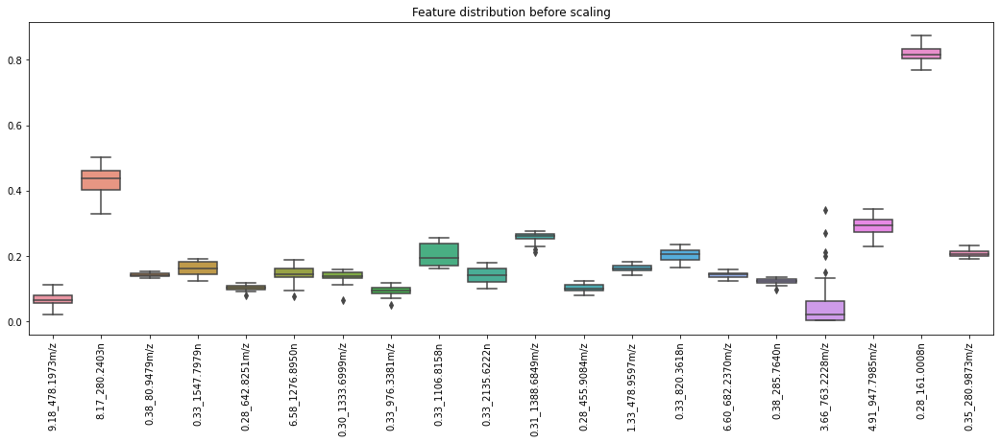

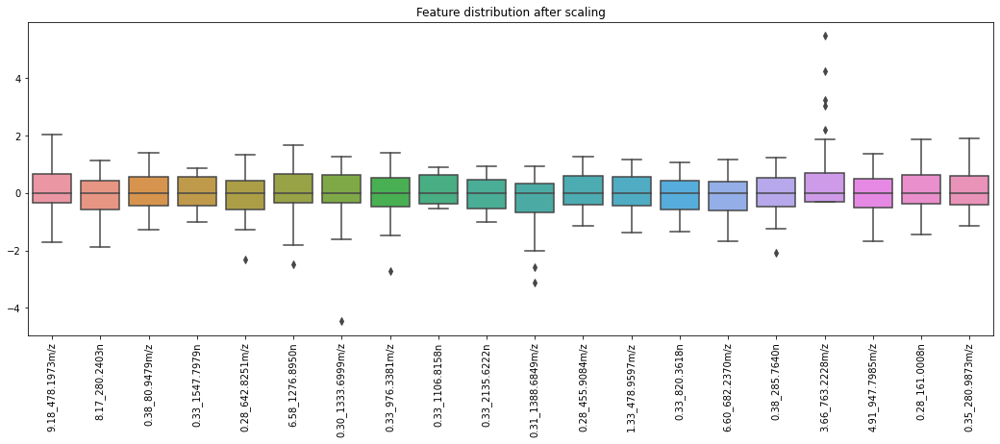

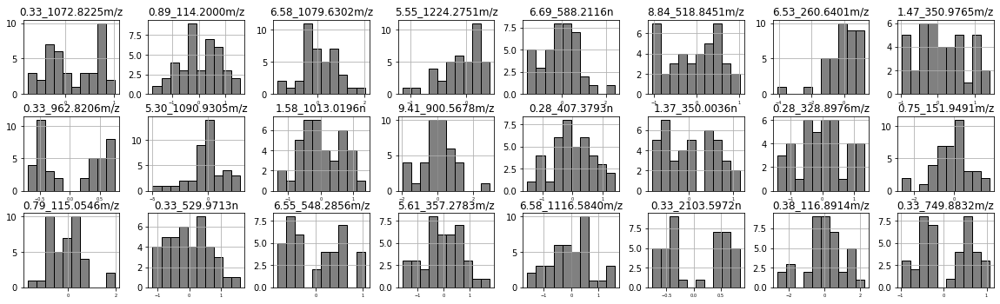

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='AUClast')

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.24

MAPE: 2.27
MAPE Cv: 34.8

RMSE: 3.95
RMSE Cv: 64.31


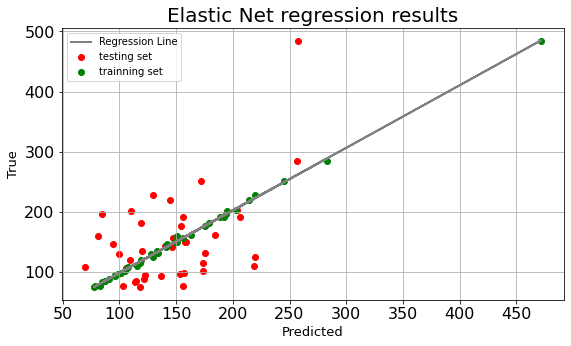

In [5]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [6]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.43

MAPE: 2.27
MAPE Cv: 31.68

RMSE: 3.95
RMSE Cv: 55.78


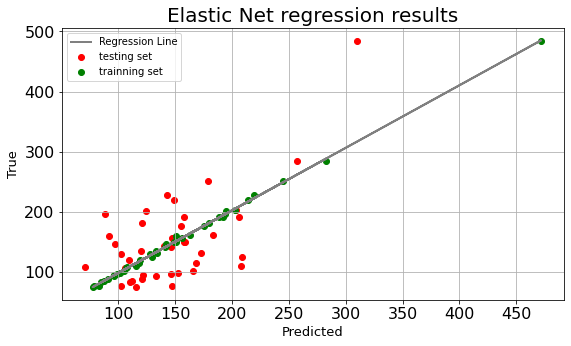

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [7]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

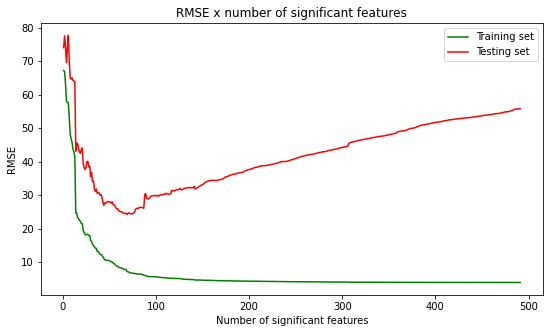

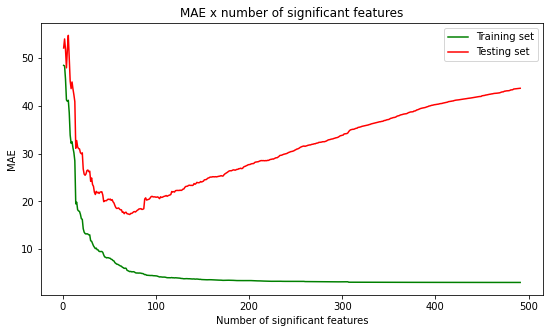

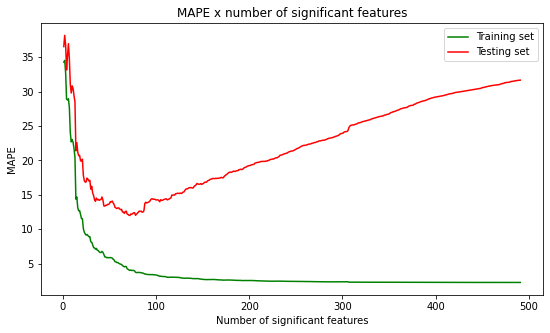

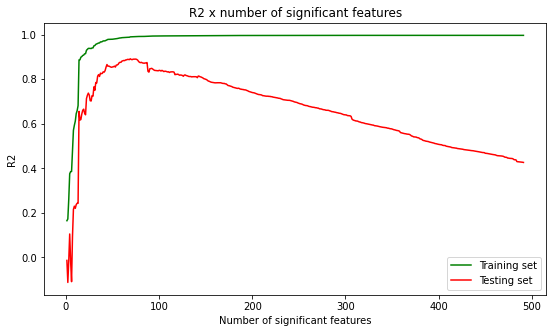

A saída de streaming foi truncada nas últimas 5000 linhas.
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 743.6723022775914, tolerance: 108.81410846020002

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 1939.6352198129389, tolerance: 112.24127589970001

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 7240.647097584384, tolerance: 104.82190136770001

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of ite

In [8]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.93

MAPE: 2.56
MAPE Cv: 10.12

RMSE: 4.31
RMSE Cv: 19.03


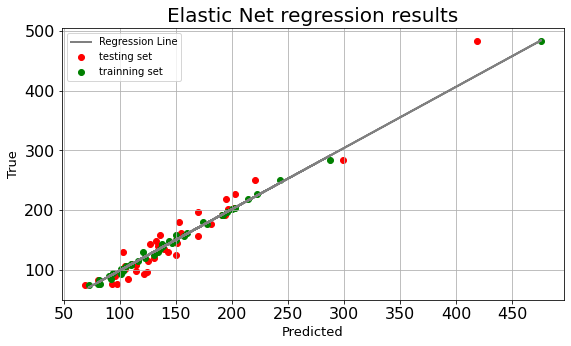

ElasticNet(alpha=0.3, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=100000, normalize=False, positive=False, precompute=True,
           random_state=None, selection='random', tol=0.0001, warm_start=False)

In [9]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

In [10]:
# Storing model metrics:

y_train_predicted, y_train_cv_predicted, r2, r2_testing_set, rmse_cv, mape_cv = get_metrics(scaled_x_train_selected, y_train, regr=regr)

In [11]:
# Storing information in variables to be later used to create the figures used in the research paper

y_train_AUC_POS_met = y_train.copy()

y_predicted_new_AUC_POS_met = y_train_predicted.copy()

y_train_cv_predicted_AUC_POS_met = y_train_cv_predicted.copy()

r2_AUC_POS_met = r2.copy()

r2_testing_set_AUC_POS_met = r2_testing_set.copy()

rmse_cv_AUC_POS_met = rmse_cv.copy()

mape_cv_AUC_POS_met = mape_cv.copy()

In [12]:
# Model residuals plot


# Create a df with information about training set:

df_residuals_plot = pd.DataFrame(columns=['predictions']) # creates an empty df

df_residuals_plot['predictions'] = y_predicted_new_AUC_POS_met # adds the predictions of training set to df

df_residuals_plot['split'] = 'Trainning AUC'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot['AUC'] = y_train_AUC_POS_met  # creates a column and inserts AUC reference values


# Creating the df with training set information:

df_residuals_plot_2 = pd.DataFrame(columns=['predictions']) # creates another empty df

df_residuals_plot_2['predictions'] = y_train_cv_predicted_AUC_POS_met # adds the predictions of validation set to df

df_residuals_plot_2['split'] = 'Predicted AUC'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot_2['AUC'] = y_train_AUC_POS_met  # creates a column and inserts AUC reference values


# Merging previous df's (https://www.codegrepper.com/code-examples/python/add+data+to+existing+dataframe+pandas)
df_residuals_plot = df_residuals_plot.append(df_residuals_plot_2)


# Creating 'residuals' column
df_residuals_plot['residuals'] = df_residuals_plot['predictions'] - df_residuals_plot['AUC']


# Generating the figure
# link sobre as cores(https://plotly.com/python/discrete-color/)

fig = px.scatter(
    df_residuals_plot, x='predictions', y='residuals',
    marginal_y=False,
    color='split', trendline='ols', hover_name='AUC', color_discrete_sequence=["green", "red"],
    category_orders={"Split": ["Trainning", "Predicted"]}
)




fig.update_layout(title='Residuals plot')

fig.show()

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



### Cmax

In [13]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='Cmax')


Data types:

Cmax                 float64
0.33_161.1057n       float64
6.57_477.2863n       float64
7.73_509.3844n       float64
6.85_515.3145m/z     float64
                      ...   
3.98_498.1940m/z     float64
1.63_638.0975m/z     float64
4.79_1038.8019m/z    float64
4.86_66.0550m/z      float64
0.40_248.1486m/z     float64
Length: 2610, dtype: object

Missing values:

Cmax                 0
0.33_161.1057n       0
6.57_477.2863n       0
7.73_509.3844n       0
6.85_515.3145m/z     0
                    ..
3.98_498.1940m/z     0
1.63_638.0975m/z     0
4.79_1038.8019m/z    0
4.86_66.0550m/z      0
0.40_248.1486m/z     0
Length: 2610, dtype: int64

Number of zeros:

Cmax                 0
0.33_161.1057n       0
6.57_477.2863n       0
7.73_509.3844n       0
6.85_515.3145m/z     0
                    ..
3.98_498.1940m/z     0
1.63_638.0975m/z     0
4.79_1038.8019m/z    0
4.86_66.0550m/z      0
0.40_248.1486m/z     0
Length: 2610, dtype: int64



Correlations, boxplots and histograms of

,Cmax,0.33_161.1057n,6.57_477.2863n,7.73_509.3844n,6.85_515.3145m/z,0.31_649.8247n,7.52_481.3173n,1.76_224.1283m/z,5.63_449.3148n,6.57_337.2738m/z,6.85_495.3333n,0.31_203.9625n,0.31_395.9039n,0.50_166.0869m/z,8.10_240.2332m/z,0.31_293.9132n,1.07_195.0880m/z,0.28_213.9107n,0.31_717.8118n,0.33_113.0592n,7.68_280.2636m/z,0.79_115.0546m/z,0.42_132.1024m/z,7.62_549.3794n,6.85_496.5649m/z,0.28_215.9439n,0.31_565.8637n,6.85_496.4548m/z,7.54_523.3642n,6.83_453.2860n,0.28_274.9806n,0.66_181.0723m/z,0.79_187.0637n,0.31_497.8759n,0.31_599.8659n,0.89_114.0921m/z,6.20_380.2560m/z,6.53_482.3247m/z,0.79_204.0897n,4.58_363.2167m/z,...,5.51_966.4006m/z,6.58_1092.1340m/z,5.30_1145.3178m/z,6.13_220.1762m/z,10.11_420.8850m/z,0.33_1103.8230m/z,0.33_1091.8265m/z,0.31_1409.6792m/z,5.53_482.3579m/z,5.16_1206.6276m/z,6.85_885.6668m/z,0.30_742.3365m/z,5.53_137.1326m/z,6.48_551.8162m/z,5.28_1475.5773m/z,4.81_838.2404m/z,7.54_1221.8850m/z,3.66_455.7535m/z,6.83_1489.9393m/z,0.33_1173.8082m/z,4.47_799.4395m/z,5.14_583.2545m/z,4.79_831.0436m/z,0.33_1112.3035m/z,10.15_498.8985m/z,3.26_916.5829m/z,0.81_550.0994m/z,0.33_1174.8063m/z,0.33_980.8410m/z,6.99_668.9227m/z,0.30_252.8833m/z,7.54_342.6098m/z,0.33_1040.8334m/z,6.30_187.1482m/z,0.38_244.7879m/z,3.98_498.1940m/z,1.63_638.0975m/z,4.79_1038.8019m/z,4.86_66.0550m/z,0.40_248.1486m/z
Cmax,1.000000,-0.201650,0.092896,-0.132976,-0.090477,0.257591,-0.073084,0.032452,-0.065811,-0.008001,-0.172759,0.381411,0.351557,-0.176884,-0.011881,0.104236,0.250806,0.467226,0.310114,-0.102513,-0.025671,0.158556,-0.252910,-0.023117,-0.218001,0.237066,0.339313,-0.160775,-0.335082,0.086444,0.186314,0.135511,0.167548,0.342899,0.320869,0.105362,0.004899,-0.161177,0.142724,0.211466,...,0.113326,-0.315416,0.025951,-0.274861,-0.153596,0.169948,0.023235,-0.211075,-0.074075,0.153177,-0.301442,-0.221328,-0.207792,-0.059972,0.069699,0.038687,-0.033814,0.133749,-0.119657,0.051915,0.213509,-0.168117,0.089344,0.123665,-0.204126,0.315805,0.225453,0.006548,-0.006021,0.179211,0.080379,0.200628,0.003646,-0.115483,-0.126589,0.147343,0.123236,0.185781,0.046773,0.043410
0.33_161.1057n,-0.201650,1.000000,-0.254296,0.088077,0.143549,-0.147899,-0.128781,0.106250,-0.139180,-0.283549,0.096223,-0.177475,-0.097338,-0.079701,-0.086638,0.051642,-0.446257,-0.220673,-0.131668,0.116425,-0.038957,0.015051,0.012932,0.283557,0.139981,0.002568,-0.164927,0.131947,0.143415,-0.214058,-0.041473,-0.428833,-0.038101,-0.106725,-0.112433,0.073885,0.080052,-0.010630,-0.041120,-0.100021,...,-0.053583,-0.024396,-0.110882,-0.071506,-0.017457,-0.013484,0.047222,0.228318,0.064916,0.026125,-0.203558,0.012607,-0.101214,0.034588,-0.037198,0.071497,-0.125516,-0.045807,-0.156481,-0.004399,-0.382764,0.029266,0.359889,0.110019,-0.101390,0.169363,0.093109,0.053195,0.017978,-0.193453,0.047318,-0.207915,0.035600,-0.136400,0.231458,0.120395,0.195049,0.267592,-0.201262,-0.015075
6.57_477.2863n,0.092896,-0.254296,1.000000,0.141841,0.084452,-0.184265,0.304798,-0.173439,0.305744,0.971413,0.021249,-0.058798,-0.186372,-0.023232,-0.016369,-0.317145,-0.122355,-0.222880,-0.175580,-0.348227,-0.047460,-0.033064,-0.005825,0.055301,0.024517,-0.096995,-0.074785,0.049019,0.125823,0.122269,-0.081839,-0.064518,-0.035497,-0.223610,-0.161857,-0.078563,-0.276450,0.174307,-0.040911,0.035305,...,-0.087384,0.035616,-0.036704,-0.152742,-0.190781,0.244404,0.066381,0.000393,-0.066433,0.198668,-0.005287,-0.005742,-0.120304,0.039626,0.078505,0.007865,-0.211339,-0.174952,0.061077,0.097413,0.104928,0.164297,-0.071092,0.293979,-0.314005,-0.053688,0.100827,0.046389,0.074362,0.103845,-0.192898,0.243540,0.066806,-0.070746,-0.130882,0.030837,0.004830,0.028573,-0.074022,0.002079
7.73_509.3844n,-0.132976,0.088077,0.141841,1.000000,0.391400,-0.352551,0.149479,-0.092085,-0.018451,0.170577,0.188238,-0.319560,-0.370972,-0.014565,-0.155415,-0.223788,-0.185851,-0.397016,-0.301133,-0.066179,-0.042854,-0.227795,0.049276,0.358874,0.262164,-0.221579,-0.302358,0.208222,0.543387,-0.306113,-0.254498,-0.151306,-0.186668,-0.420588,-0.340200

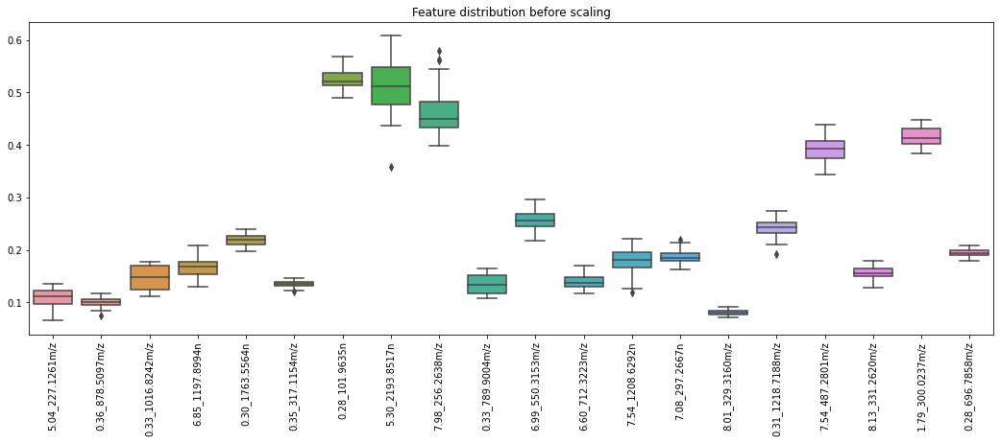

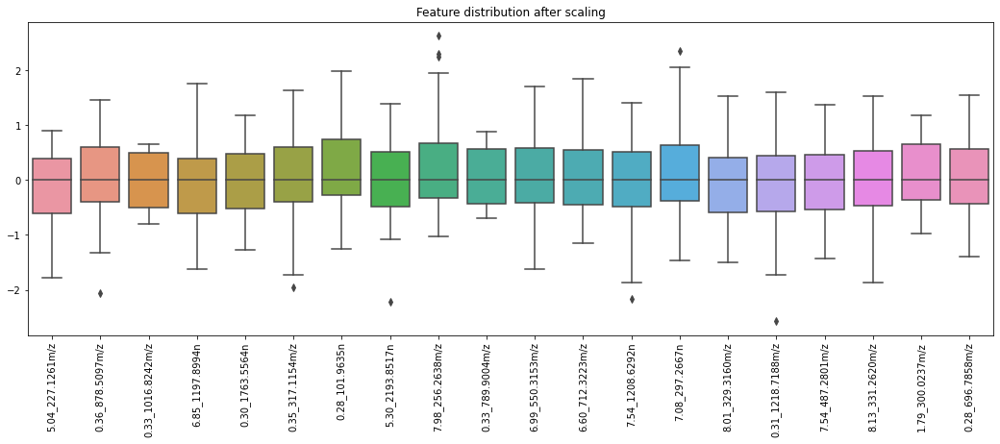

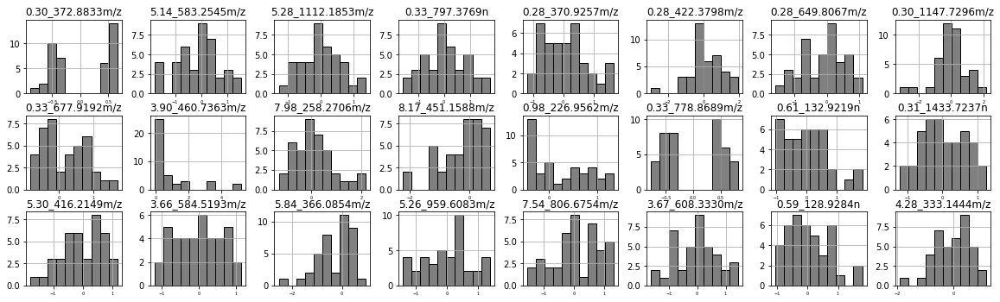

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='Cmax')

Elastic Net - Summary of results:

R2: 0.95
R2 Cv: 0.18

MAPE: 9.63
MAPE Cv: 41.58

RMSE: 2.15
RMSE Cv: 9.05


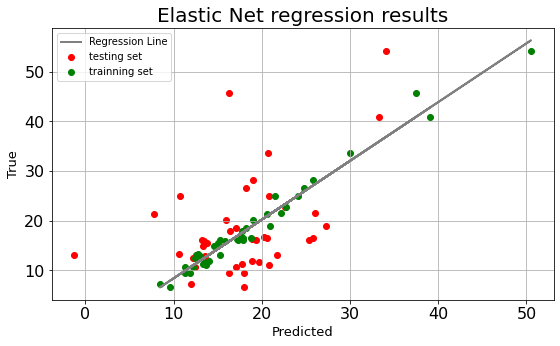

In [14]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [15]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 0.95
R2 Cv: 0.33

MAPE: 9.63
MAPE Cv: 38.28

RMSE: 2.15
RMSE Cv: 8.17


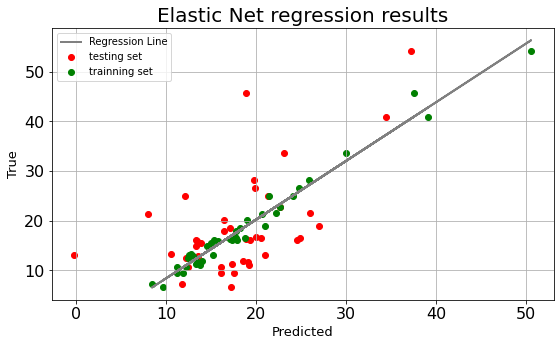

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [16]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

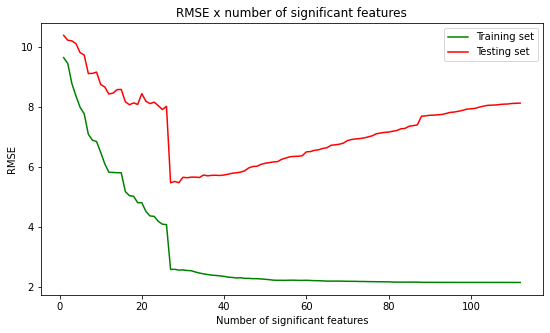

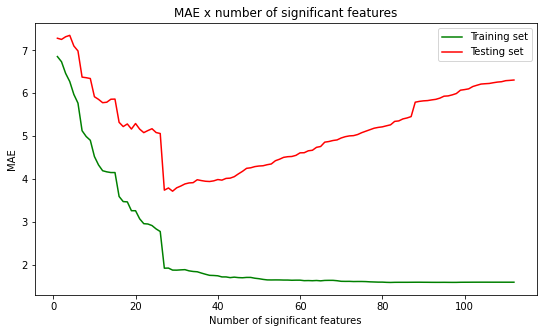

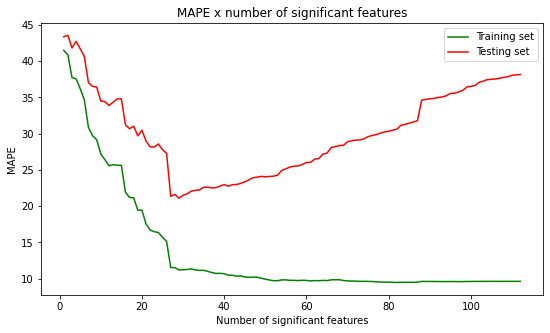

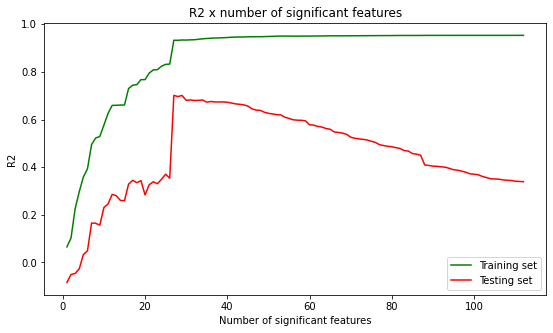

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.5365384544808265, tolerance: 0.39764196295897436

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8223571903698215, tolerance: 0.39764196295897436

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.4860209094441643, tolerance: 0.39764196295897436

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.6207098810820675, tolerance: 0

In [17]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.99
R2 Cv: 0.94

MAPE: 4.77
MAPE Cv: 11.56

RMSE: 0.97
RMSE Cv: 2.54


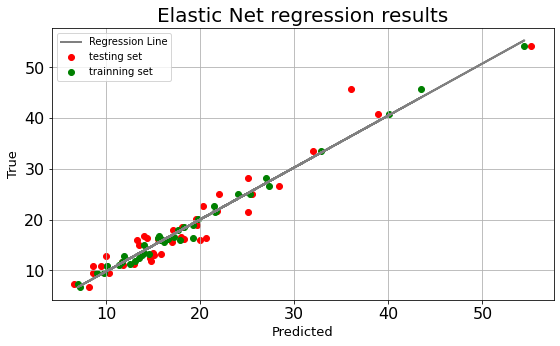

ElasticNet(alpha=0.1, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=10000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='random', tol=0.0001, warm_start=False)

In [18]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

In [19]:
# Storing model metrics:

y_train_predicted, y_train_cv_predicted, r2, r2_testing_set, rmse_cv, mape_cv = get_metrics(scaled_x_train_selected, y_train, regr=regr)

In [20]:
# Storing information in variables to be later used to create the figures used in the research paper

y_train_Cmax_POS_met = y_train.copy()

y_predicted_new_Cmax_POS_met = y_train_predicted.copy()

y_train_cv_predicted_Cmax_POS_met = y_train_cv_predicted.copy()

r2_Cmax_POS_met = r2.copy()

r2_testing_set_Cmax_POS_met = r2_testing_set.copy()

rmse_cv_Cmax_POS_met = rmse_cv.copy()

mape_cv_Cmax_POS_met = mape_cv.copy()

In [21]:
# Model residuals plot


# Create a df with information about training set:

df_residuals_plot = pd.DataFrame(columns=['predictions']) # creates an empty df

df_residuals_plot['predictions'] = y_predicted_new_Cmax_POS_met # adds the predictions of training set to df

df_residuals_plot['split'] = 'Trainning Cmax'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot['Cmax'] = y_train_Cmax_POS_met # cria uma coluna e insere os valores de referência de Cmax


# Creating the df with training set information:

df_residuals_plot_2 = pd.DataFrame(columns=['predictions']) # creates another empty df

df_residuals_plot_2['predictions'] = y_train_cv_predicted_Cmax_POS_met # adds the predictions of validation set to df

df_residuals_plot_2['split'] = 'Predicted Cmax'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot_2['Cmax'] = y_train_Cmax_POS_met # cria uma coluna e insere os valores de referência de Cmax


# Merging previous df's (https://www.codegrepper.com/code-examples/python/add+data+to+existing+dataframe+pandas)
df_residuals_plot = df_residuals_plot.append(df_residuals_plot_2)


# Creating 'residuals' column
df_residuals_plot['residuals'] = df_residuals_plot['predictions'] - df_residuals_plot['Cmax']


# Generating the figure
# link sobre as cores(https://plotly.com/python/discrete-color/)

fig = px.scatter(
    df_residuals_plot, x='predictions', y='residuals',
    marginal_y=False,
    color='split', trendline='ols', hover_name='Cmax', color_discrete_sequence=["green", "red"],
    category_orders={"Split": ["Trainning", "Predicted"]}
)




fig.update_layout(title='Residuals plot')

fig.show()

## Metabolomics -  ESI(-)

### Data import

In [22]:
# Data import and checking

df = pd.read_csv('https://drive.google.com/u/1/uc?id=1KhY-lFQLMfkD7xMNZXFTQMsG0Eol2etw&export=download', encoding='latin-1')

df.head()

,Primary ID,Cmax,AUClast,8.42_1562.1277m/z,6.48_1605.9970m/z,5.40_532.0377m/z,0.36_1158.2420m/z,0.28_702.7730m/z,7.27_411.3828m/z,0.30_1109.3108n,0.30_1162.2781n,7.87_1696.0852m/z,10.80_279.6138m/z,5.32_52.8654m/z,0.36_1174.2883m/z,0.30_1034.2937n,0.28_1142.6516m/z,10.39_1636.1421m/z,10.46_1557.1500m/z,0.30_1136.2752n,4.93_1433.5379m/z,3.85_1410.2592n,7.75_1516.1052m/z,0.28_424.8487m/z,6.62_1377.8661m/z,0.28_308.9068m/z,0.30_1425.7036m/z,6.73_1666.9602m/z,0.30_1068.2870n,10.39_1654.1111m/z,5.33_52.8715m/z,6.58_1640.9614m/z,2.67_186.1128m/z,0.87_1598.9514m/z,0.30_1441.7021m/z,0.31_309.9232n,0.30_1530.7095n,0.30_768.3589n,7.50_529.4240m/z,7.45_1555.1353m/z,...,6.69_552.3286m/z,0.71_897.2451m/z,5.55_383.1533m/z,6.29_391.2844m/z,4.54_187.0066m/z,0.70_913.2171m/z,5.84_268.1307n,0.75_1189.3367m/z,6.67_398.2075m/z,0.68_1211.3184m/z,0.56_313.0649m/z,0.36_217.0297m/z,6.50_887.5352n,0.43_167.0207m/z,6.29_438.2972n,6.45_369.1717m/z,6.25_474.2621m/z,1.95_129.0554m/z,0.84_292.0902n,7.19_554.3457m/z,0.54_210.0610n,6.86_495.3318n,5.90_507.2228m/z,6.35_398.1739n,4.23_212.0017m/z,7.03_479.3370n,0.36_215.0324m/z,5.84_413.1993m/z,0.65_605.1555m/z,0.82_294.0904m/z,7.55_523.3628n,6.45_367.1578m/z,4.58_408.2105n,3.89_256.0940n,5.12_464.3010m/z,0.63_576.1298n,0.54_329.0377m/z,5.61_448.3061m/z,6.53_481.3154n,7.01_526.3501m/z
0,FMTB_ROS_NEG_EST1_1_PRÉ 1,28.178,218.631,0.225370,0.141611,0.287875,0.227349,0.129962,0.161788,0.147115,0.126081,0.249930,0.094970,0.184281,0.229366,0.146059,0.083120,0.354956,0.335943,0.022738,0.173664,0.090757,0.197017,0.130033,0.146397,0.147378,0.136056,0.191404,0.161390,0.340345,0.144204,0.159797,0.214666,0.130890,0.158562,0.221938,0.119972,0.153972,0.166660,0.261703,...,0.421555,1.30768,0.452679,0.435211,0.898853,0.729144,0.826320,0.886123,0.399779,0.747338,1.68726,0.539458,0.470979,0.736936,0.624441,1.11639,0.329106,0.567788,4.83157,0.944727,0.378790,2.66702,0.368051,0.536562,0.658324,0.654074,0.760615,0.527018,1.78802,0.575882,2.15126,1.16088,0.423510,0.238811,0.274858,0.977517,0.936361,0.451104,0.673758,0.635382
1,FMTB_ROS_NEG_EST1_10_PRÉ 1,33.573,250.282,0.161022,0.129152,0.385910,0.185915,0.204067,0.195144,0.200405,0.183546,0.193217,0.241812,0.148582,0.218137,0.189542,0.179475,0.230722,0.236630,0.182656,0.138192,0.114452,0.194612,0.187287,0.120934,0.224918,0.167085,0.204735,0.148022,0.208040,0.066628,0.174582,0.149385,0.046041,0.119008,0.135372,0.226574,0.186569,0.179802,0.172875,...,0.385874,1.30210,0.630321,0.447037,1.192760,0.725839,0.711228,0.888767,0.572641,0.746629,1.68995,0.530907,0.573631,0.730087,0.581711,1.43557,0.347341,0.612470,4.86451,0.848250,0.391262,2.62514,0.413268,0.775471,0.599145,0.598212,0.749270,0.786803,1.78379,0.580990,1.92975,1.70410,0.401288,0.325839,0.286219,0.978583,0.939584,0.497983,0.660777,0.563406
2,FMTB_ROS_NEG_EST1_11_PRÉ 1,16.210,109.506,0.148616,0.206605,0.240161,0.201431,0.125608,0.167877,0.050750,0.035189,0.144549,0.254545,0.236413,0.181075,0.161854,0.122373,0.267778,0.232823,0.155853,0.167368,0.112217,0.297580,0.125114,0.188785,0.141778,0.181196,0.183843,0.143729,0.171245,0.166722,0.099702,0.188307,0.090376,0.182315,0.213977,0.178866,0.168919,0.169897,0.157057,...,0.434354,1.30061,0.491306,0.351656,1.592910,0.731406,0.613548,0.893715,0.511684,0.752595,1.70316,0.539851,0.497528,0.610430,0.460186,1.08618,0.331960,0.553056,4.85786,0.918550,0.390645,2.59293,0.334768,0.680570,0.522024,0.615503,0.758780,0.678900,1.79002,0.576258,2.09239,1.34835,0.402070,0.258489,0.302914,0.989840,0.946831,0.651928,0.674567,0.571910
3,FMTB_ROS_NEG_EST1_12_PRÉ 1,11.089,76.060,0.146848,0.111748,0.383022,0.210697,0.193060,0.313450,0.147290,0.201644,0.137769,0.253644,0.192995,0.206148,0.197096,0.151455,0.293495,0.290796,0.178353,0.142281,0.135455,0.299123,0.191866,0.160583,0.217190,0.164329,0.214343,0.187121,0.251583,0.147834,0.109427,0.127727,0.109604,0.161870,0.142097,0.190926,0.194432,0.125712,0.197743,...,0.421555,1.31655,0.584438,0.509711,1.320310,0.733886,0.754223,0.903163,0.433165,0.765477,1.71707,0.

### AUC

In [23]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='AUClast')


Data types:

AUClast              float64
8.42_1562.1277m/z    float64
6.48_1605.9970m/z    float64
5.40_532.0377m/z     float64
0.36_1158.2420m/z    float64
                      ...   
0.63_576.1298n       float64
0.54_329.0377m/z     float64
5.61_448.3061m/z     float64
6.53_481.3154n       float64
7.01_526.3501m/z     float64
Length: 2447, dtype: object

Missing values:

AUClast              0
8.42_1562.1277m/z    0
6.48_1605.9970m/z    0
5.40_532.0377m/z     0
0.36_1158.2420m/z    0
                    ..
0.63_576.1298n       0
0.54_329.0377m/z     0
5.61_448.3061m/z     0
6.53_481.3154n       0
7.01_526.3501m/z     0
Length: 2447, dtype: int64

Number of zeros:

AUClast              0
8.42_1562.1277m/z    0
6.48_1605.9970m/z    0
5.40_532.0377m/z     0
0.36_1158.2420m/z    0
                    ..
0.63_576.1298n       0
0.54_329.0377m/z     0
5.61_448.3061m/z     0
6.53_481.3154n       0
7.01_526.3501m/z     0
Length: 2447, dtype: int64



Correlations, boxplots and histograms of

,AUClast,8.42_1562.1277m/z,6.48_1605.9970m/z,5.40_532.0377m/z,0.36_1158.2420m/z,0.28_702.7730m/z,7.27_411.3828m/z,0.30_1109.3108n,0.30_1162.2781n,7.87_1696.0852m/z,10.80_279.6138m/z,5.32_52.8654m/z,0.36_1174.2883m/z,0.30_1034.2937n,0.28_1142.6516m/z,10.39_1636.1421m/z,10.46_1557.1500m/z,0.30_1136.2752n,4.93_1433.5379m/z,3.85_1410.2592n,7.75_1516.1052m/z,0.28_424.8487m/z,6.62_1377.8661m/z,0.28_308.9068m/z,0.30_1425.7036m/z,6.73_1666.9602m/z,0.30_1068.2870n,10.39_1654.1111m/z,5.33_52.8715m/z,6.58_1640.9614m/z,2.67_186.1128m/z,0.87_1598.9514m/z,0.30_1441.7021m/z,0.31_309.9232n,0.30_1530.7095n,0.30_768.3589n,7.50_529.4240m/z,7.45_1555.1353m/z,0.71_1657.9323m/z,3.55_195.8102m/z,...,6.69_552.3286m/z,0.71_897.2451m/z,5.55_383.1533m/z,6.29_391.2844m/z,4.54_187.0066m/z,0.70_913.2171m/z,5.84_268.1307n,0.75_1189.3367m/z,6.67_398.2075m/z,0.68_1211.3184m/z,0.56_313.0649m/z,0.36_217.0297m/z,6.50_887.5352n,0.43_167.0207m/z,6.29_438.2972n,6.45_369.1717m/z,6.25_474.2621m/z,1.95_129.0554m/z,0.84_292.0902n,7.19_554.3457m/z,0.54_210.0610n,6.86_495.3318n,5.90_507.2228m/z,6.35_398.1739n,4.23_212.0017m/z,7.03_479.3370n,0.36_215.0324m/z,5.84_413.1993m/z,0.65_605.1555m/z,0.82_294.0904m/z,7.55_523.3628n,6.45_367.1578m/z,4.58_408.2105n,3.89_256.0940n,5.12_464.3010m/z,0.63_576.1298n,0.54_329.0377m/z,5.61_448.3061m/z,6.53_481.3154n,7.01_526.3501m/z
AUClast,1.000000,0.200417,-0.153769,0.022801,0.535547,-0.075748,-0.044176,0.333227,0.069622,0.342845,-0.075710,-0.169776,0.244892,-0.096756,-0.021577,-0.070570,0.007683,0.011857,-0.310513,-0.147687,-0.272442,-0.053270,-0.188409,-0.040890,-0.046307,-0.232102,-0.076489,-0.034795,-0.090245,0.378544,0.061383,-0.042820,-0.044201,0.181248,-0.016489,0.080656,0.043006,0.092038,-0.088126,-0.299106,...,-0.312946,-0.116280,0.027669,-0.238092,-0.172548,-0.273241,-0.055077,-0.226310,0.100002,-0.128319,-0.071693,-0.501003,0.000609,-0.295995,-0.344537,0.073442,-0.147133,-0.114031,-0.097222,-0.343658,0.083948,-0.101384,-0.169736,-0.188873,0.009473,-0.243195,-0.431242,-0.170809,-0.117688,-0.075951,-0.378908,0.006111,0.262935,-0.329863,-0.346506,-0.301941,-0.291466,-0.329812,-0.204648,-0.109253
8.42_1562.1277m/z,0.200417,1.000000,-0.333496,0.148249,0.105490,-0.135709,-0.243937,0.226168,0.088690,0.800591,-0.631432,-0.383297,0.039674,-0.067877,-0.325326,0.516005,0.466989,-0.088553,-0.065238,-0.116999,0.027312,-0.018936,-0.130654,-0.056341,-0.205995,-0.456969,0.036363,0.662461,-0.201900,0.394490,0.219806,-0.060836,-0.050520,0.171859,0.058174,-0.359532,-0.051652,0.298018,-0.078330,-0.420564,...,-0.167711,0.240973,-0.023611,-0.259557,-0.003431,-0.025014,0.015750,0.022161,-0.124390,0.012988,-0.139117,-0.272336,0.006170,0.022732,-0.134364,0.017768,-0.241613,-0.048043,-0.033736,-0.137862,-0.210100,-0.067924,0.130429,-0.040047,-0.024101,-0.023982,-0.242025,-0.036541,0.106667,0.022447,-0.061138,-0.024173,0.336956,-0.217596,-0.172169,-0.083100,-0.105267,-0.317946,-0.320235,0.131236
6.48_1605.9970m/z,-0.153769,-0.333496,1.000000,-0.278248,-0.081062,-0.141606,-0.094295,-0.152716,-0.457245,-0.317448,0.179027,0.372727,-0.223659,-0.084704,-0.030484,-0.325202,-0.357697,-0.263121,0.433661,0.136572,-0.221140,-0.262966,0.255130,-0.191920,-0.165338,0.108333,-0.340623,-0.479439,0.247958,-0.257670,-0.144706,0.059284,0.314539,0.070366,-0.015698,-0.137968,0.080902,-0.358041,-0.115002,0.173560,...,0.229306,-0.366372,-0.005987,0.252142,0.109438,-0.053661,0.127443,-0.161203,0.330255,-0.175012,-0.285610,0.028911,0.337148,-0.161810,0.214669,0.245611,0.449724,-0.103457,-0.354084,0.244055,-0.188314,-0.228616,-0.227802,0.252802,-0.065164,0.299373,-0.001345,0.232341,-0.394997,-0.368967,0.309805,0.237132,-0.353109,-0.025111,0.288580,-0.070288,-0.117155,0.314837,-0.009470,0.004876
5.40_532.0377m/z,0.022801,0.148249,-0.278248,1.000000,0.109987,-0.072589,-0.025426,0.020652,0.157083,0.080157,-0.224875,-0.418642,-0.059040,-0.103665,-0.104069,0.092145,0.108497,0.037062,-0.131928,-0.086273,0.070671,0.048166,-0.320589,0.021502,0.073413,-0.356282,0.100638,0.120635,-0.3046

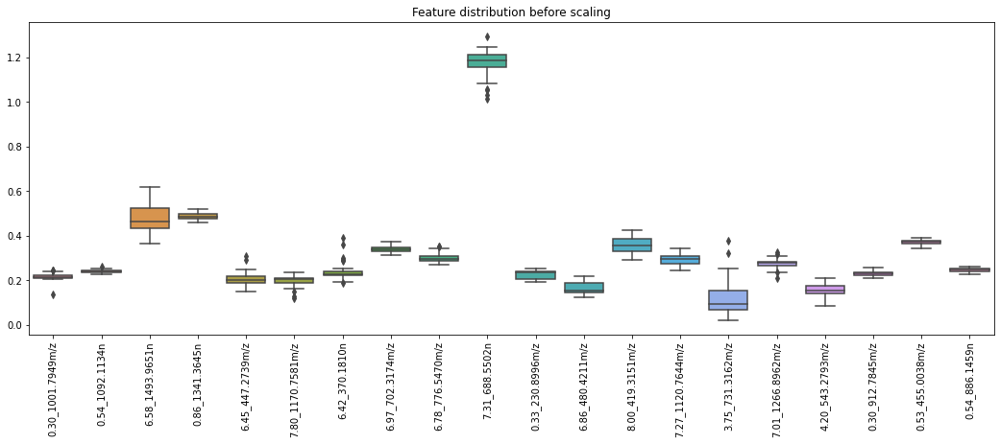

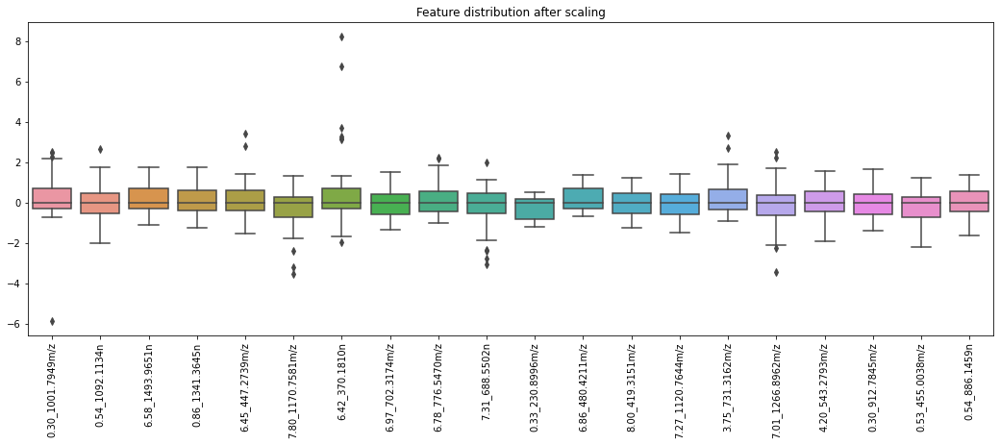

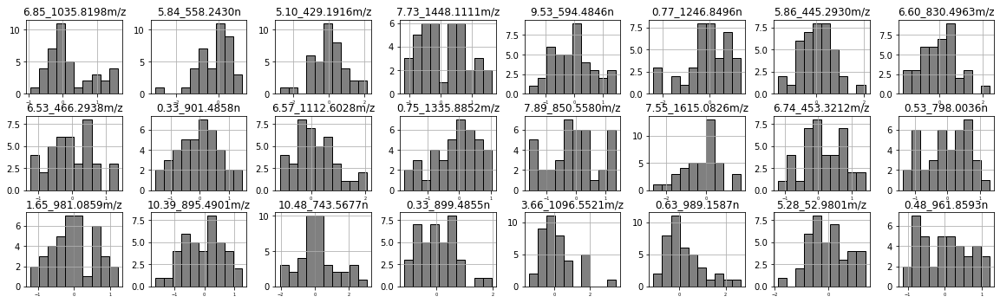

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='AUClast')

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 107.86012279141119, tolerance: 21.620134108990005

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 49.53009490606519, tolerance: 21.15205694634359

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 63.06281382940847, tolerance: 20.610704410230774

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 107.04786195911038, tolerance: 21.4429

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: -0.01

MAPE: 2.44
MAPE Cv: 35.98

RMSE: 4.69
RMSE Cv: 73.8


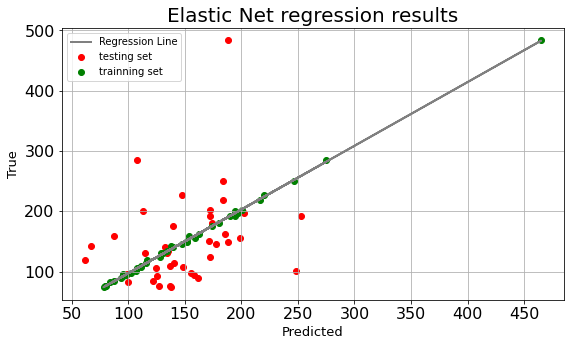

In [24]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [25]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 155.050370451562, tolerance: 21.620134108990005

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 73.29372742531086, tolerance: 21.15205694634359

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 67.00997299682922, tolerance: 20.610704410230774

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 150.29897610158878, tolerance: 21.442901

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.27

MAPE: 2.44
MAPE Cv: 32.64

RMSE: 4.69
RMSE Cv: 62.75


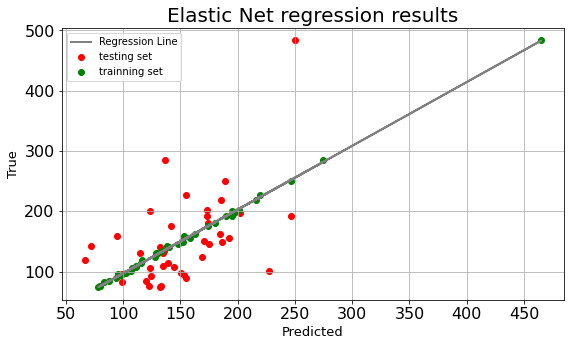

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [26]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

A saída de streaming foi truncada nas últimas 5000 linhas.
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 86.55724818309727, tolerance: 21.442901373266672

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 62.16304978098367, tolerance: 21.042973315276928

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 83.70245808096024, tolerance: 21.61654998169744

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of itera

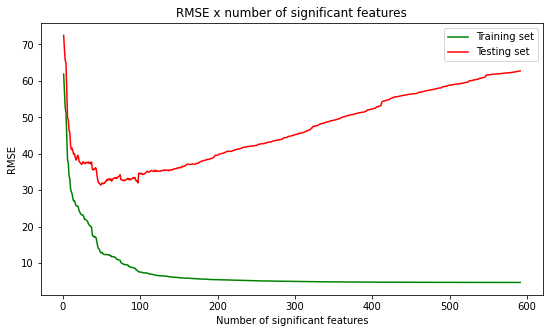

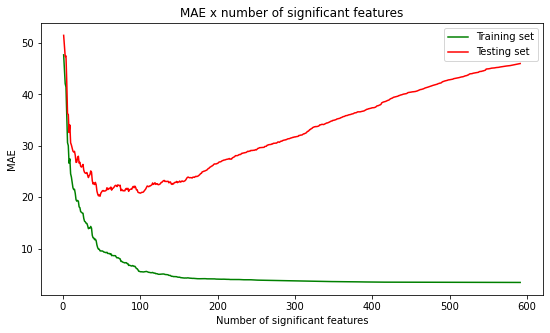

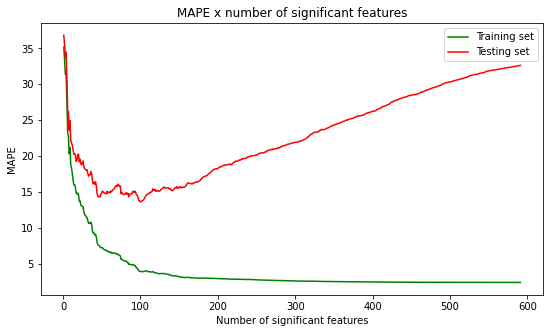

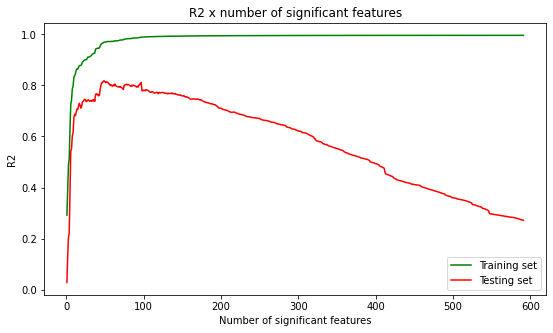

A saída de streaming foi truncada nas últimas 5000 linhas.
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 913.9995806971856, tolerance: 112.0477945198

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 1945.230128537054, tolerance: 111.22225711090002

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 424.0761324636012, tolerance: 112.33142110540001

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iteratio

In [27]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.98
R2 Cv: 0.86

MAPE: 6.28
MAPE Cv: 14.28

RMSE: 10.55
RMSE Cv: 27.92


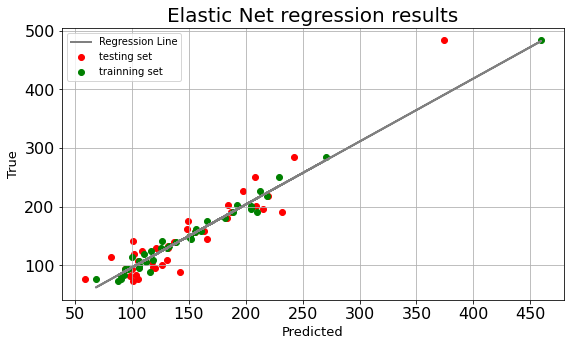

ElasticNet(alpha=0.4, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=100000, normalize=False, positive=False, precompute=True,
           random_state=None, selection='random', tol=0.0001, warm_start=False)

In [28]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

In [29]:
# Storing model metrics:

y_train_predicted, y_train_cv_predicted, r2, r2_testing_set, rmse_cv, mape_cv = get_metrics(scaled_x_train_selected, y_train, regr=regr)

In [30]:
# Storing information in variables to be later used to create the figures used in the research paper

y_train_AUC_NEG_met = y_train.copy()

y_predicted_new_AUC_NEG_met = y_train_predicted.copy()

y_train_cv_predicted_AUC_NEG_met = y_train_cv_predicted.copy()

r2_AUC_NEG_met = r2.copy()

r2_testing_set_AUC_NEG_met = r2_testing_set.copy()

rmse_cv_AUC_NEG_met = rmse_cv.copy()

mape_cv_AUC_NEG_met = mape_cv.copy()

In [31]:
# Model residuals plot


# Create a df with information about training set:

df_residuals_plot = pd.DataFrame(columns=['predictions']) # creates an empty df

df_residuals_plot['predictions'] = y_predicted_new_AUC_NEG_met # adds the predictions of training set to df

df_residuals_plot['split'] = 'Trainning AUC'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot['AUC'] = y_train_AUC_NEG_met  # creates a column and inserts AUC reference values


# Creating the df with training set information:

df_residuals_plot_2 = pd.DataFrame(columns=['predictions']) # creates another empty df

df_residuals_plot_2['predictions'] = y_train_cv_predicted_AUC_NEG_met # adds the predictions of validation set to df

df_residuals_plot_2['split'] = 'Predicted AUC'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot_2['AUC'] = y_train_AUC_NEG_met  # creates a column and inserts AUC reference values


# Merging previous df's (https://www.codegrepper.com/code-examples/python/add+data+to+existing+dataframe+pandas)
df_residuals_plot = df_residuals_plot.append(df_residuals_plot_2)


# Creating 'residuals' column
df_residuals_plot['residuals'] = df_residuals_plot['predictions'] - df_residuals_plot['AUC']


# Generating the figure
# link sobre as cores(https://plotly.com/python/discrete-color/)

fig = px.scatter(
    df_residuals_plot, x='predictions', y='residuals',
    marginal_y=False,
    color='split', trendline='ols', hover_name='AUC', color_discrete_sequence=["green", "red"],
    category_orders={"Split": ["Trainning", "Predicted"]}
)




fig.update_layout(title='Residuals plot')

fig.show()

### Cmax

In [32]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='Cmax')


Data types:

Cmax                 float64
8.42_1562.1277m/z    float64
6.48_1605.9970m/z    float64
5.40_532.0377m/z     float64
0.36_1158.2420m/z    float64
                      ...   
0.63_576.1298n       float64
0.54_329.0377m/z     float64
5.61_448.3061m/z     float64
6.53_481.3154n       float64
7.01_526.3501m/z     float64
Length: 2447, dtype: object

Missing values:

Cmax                 0
8.42_1562.1277m/z    0
6.48_1605.9970m/z    0
5.40_532.0377m/z     0
0.36_1158.2420m/z    0
                    ..
0.63_576.1298n       0
0.54_329.0377m/z     0
5.61_448.3061m/z     0
6.53_481.3154n       0
7.01_526.3501m/z     0
Length: 2447, dtype: int64

Number of zeros:

Cmax                 0
8.42_1562.1277m/z    0
6.48_1605.9970m/z    0
5.40_532.0377m/z     0
0.36_1158.2420m/z    0
                    ..
0.63_576.1298n       0
0.54_329.0377m/z     0
5.61_448.3061m/z     0
6.53_481.3154n       0
7.01_526.3501m/z     0
Length: 2447, dtype: int64



Correlations, boxplots and histograms of

,Cmax,8.42_1562.1277m/z,6.48_1605.9970m/z,5.40_532.0377m/z,0.36_1158.2420m/z,0.28_702.7730m/z,7.27_411.3828m/z,0.30_1109.3108n,0.30_1162.2781n,7.87_1696.0852m/z,10.80_279.6138m/z,5.32_52.8654m/z,0.36_1174.2883m/z,0.30_1034.2937n,0.28_1142.6516m/z,10.39_1636.1421m/z,10.46_1557.1500m/z,0.30_1136.2752n,4.93_1433.5379m/z,3.85_1410.2592n,7.75_1516.1052m/z,0.28_424.8487m/z,6.62_1377.8661m/z,0.28_308.9068m/z,0.30_1425.7036m/z,6.73_1666.9602m/z,0.30_1068.2870n,10.39_1654.1111m/z,5.33_52.8715m/z,6.58_1640.9614m/z,2.67_186.1128m/z,0.87_1598.9514m/z,0.30_1441.7021m/z,0.31_309.9232n,0.30_1530.7095n,0.30_768.3589n,7.50_529.4240m/z,7.45_1555.1353m/z,0.71_1657.9323m/z,3.55_195.8102m/z,...,6.69_552.3286m/z,0.71_897.2451m/z,5.55_383.1533m/z,6.29_391.2844m/z,4.54_187.0066m/z,0.70_913.2171m/z,5.84_268.1307n,0.75_1189.3367m/z,6.67_398.2075m/z,0.68_1211.3184m/z,0.56_313.0649m/z,0.36_217.0297m/z,6.50_887.5352n,0.43_167.0207m/z,6.29_438.2972n,6.45_369.1717m/z,6.25_474.2621m/z,1.95_129.0554m/z,0.84_292.0902n,7.19_554.3457m/z,0.54_210.0610n,6.86_495.3318n,5.90_507.2228m/z,6.35_398.1739n,4.23_212.0017m/z,7.03_479.3370n,0.36_215.0324m/z,5.84_413.1993m/z,0.65_605.1555m/z,0.82_294.0904m/z,7.55_523.3628n,6.45_367.1578m/z,4.58_408.2105n,3.89_256.0940n,5.12_464.3010m/z,0.63_576.1298n,0.54_329.0377m/z,5.61_448.3061m/z,6.53_481.3154n,7.01_526.3501m/z
Cmax,1.000000,0.145869,-0.110056,-0.040619,0.524843,-0.045042,-0.055165,0.308309,0.055311,0.290805,-0.072331,-0.138170,0.268911,-0.035269,0.038228,-0.060157,0.047389,0.030268,-0.250499,-0.205642,-0.321714,-0.047211,-0.050605,-0.017425,-0.028114,-0.214401,-0.005564,-0.046860,-0.020417,0.174502,0.101942,-0.041944,-0.001379,0.149948,-0.104024,0.044427,-0.005144,0.118659,-0.078293,-0.234202,...,-0.331439,-0.116596,0.142152,-0.141098,-0.240351,-0.297920,0.023187,-0.209391,0.129637,-0.106818,-0.010019,-0.421093,0.040585,-0.268404,-0.248988,0.064172,-0.013811,-0.113097,-0.132258,-0.402715,0.097970,-0.167317,-0.155770,-0.148766,0.012365,-0.244926,-0.352718,-0.110114,-0.091328,-0.126151,-0.383637,0.042709,0.213647,-0.355176,-0.220014,-0.319372,-0.310953,-0.173559,-0.178048,-0.172677
8.42_1562.1277m/z,0.145869,1.000000,-0.333496,0.148249,0.105490,-0.135709,-0.243937,0.226168,0.088690,0.800591,-0.631432,-0.383297,0.039674,-0.067877,-0.325326,0.516005,0.466989,-0.088553,-0.065238,-0.116999,0.027312,-0.018936,-0.130654,-0.056341,-0.205995,-0.456969,0.036363,0.662461,-0.201900,0.394490,0.219806,-0.060836,-0.050520,0.171859,0.058174,-0.359532,-0.051652,0.298018,-0.078330,-0.420564,...,-0.167711,0.240973,-0.023611,-0.259557,-0.003431,-0.025014,0.015750,0.022161,-0.124390,0.012988,-0.139117,-0.272336,0.006170,0.022732,-0.134364,0.017768,-0.241613,-0.048043,-0.033736,-0.137862,-0.210100,-0.067924,0.130429,-0.040047,-0.024101,-0.023982,-0.242025,-0.036541,0.106667,0.022447,-0.061138,-0.024173,0.336956,-0.217596,-0.172169,-0.083100,-0.105267,-0.317946,-0.320235,0.131236
6.48_1605.9970m/z,-0.110056,-0.333496,1.000000,-0.278248,-0.081062,-0.141606,-0.094295,-0.152716,-0.457245,-0.317448,0.179027,0.372727,-0.223659,-0.084704,-0.030484,-0.325202,-0.357697,-0.263121,0.433661,0.136572,-0.221140,-0.262966,0.255130,-0.191920,-0.165338,0.108333,-0.340623,-0.479439,0.247958,-0.257670,-0.144706,0.059284,0.314539,0.070366,-0.015698,-0.137968,0.080902,-0.358041,-0.115002,0.173560,...,0.229306,-0.366372,-0.005987,0.252142,0.109438,-0.053661,0.127443,-0.161203,0.330255,-0.175012,-0.285610,0.028911,0.337148,-0.161810,0.214669,0.245611,0.449724,-0.103457,-0.354084,0.244055,-0.188314,-0.228616,-0.227802,0.252802,-0.065164,0.299373,-0.001345,0.232341,-0.394997,-0.368967,0.309805,0.237132,-0.353109,-0.025111,0.288580,-0.070288,-0.117155,0.314837,-0.009470,0.004876
5.40_532.0377m/z,-0.040619,0.148249,-0.278248,1.000000,0.109987,-0.072589,-0.025426,0.020652,0.157083,0.080157,-0.224875,-0.418642,-0.059040,-0.103665,-0.104069,0.092145,0.108497,0.037062,-0.131928,-0.086273,0.070671,0.048166,-0.320589,0.021502,0.073413,-0.356282,0.100638,0.120635,-0.304651,0.

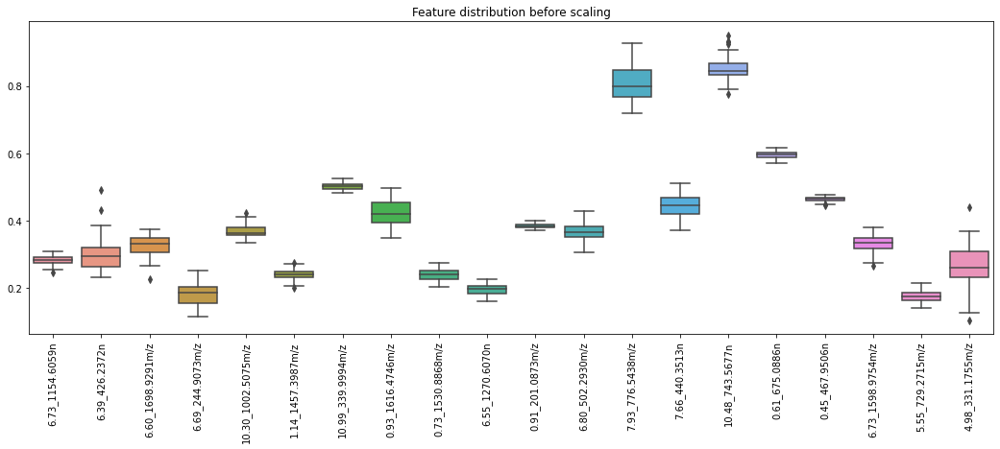

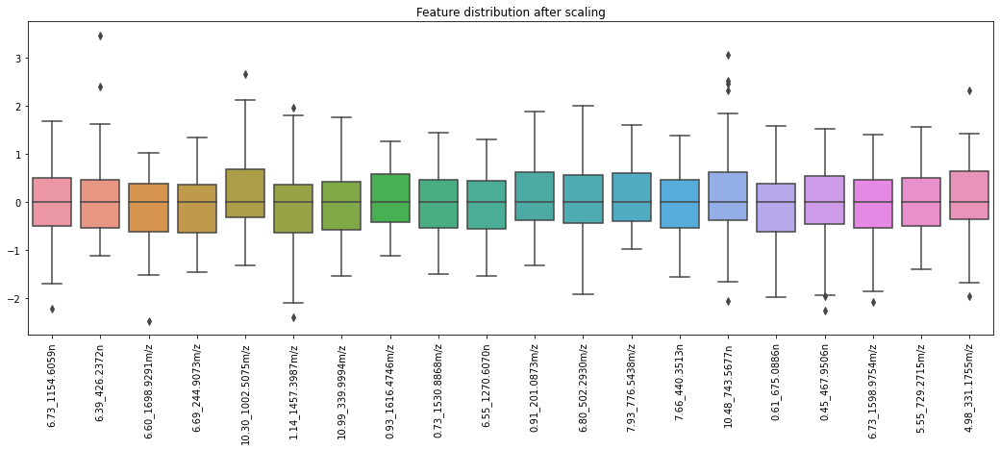

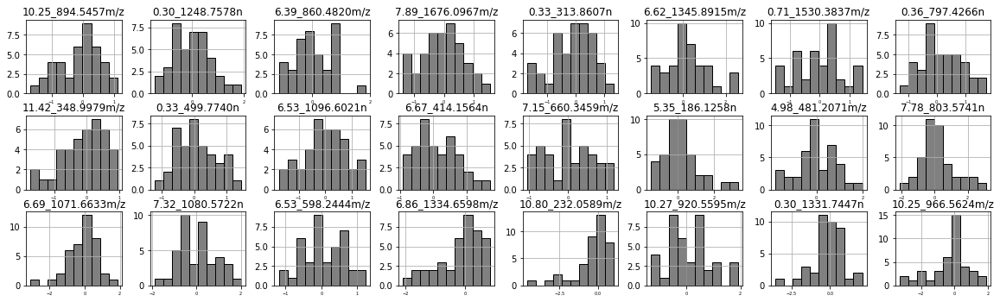

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='Cmax')

Elastic Net - Summary of results:

R2: 0.93
R2 Cv: -0.11

MAPE: 11.38
MAPE Cv: 44.76

RMSE: 2.56
RMSE Cv: 10.53


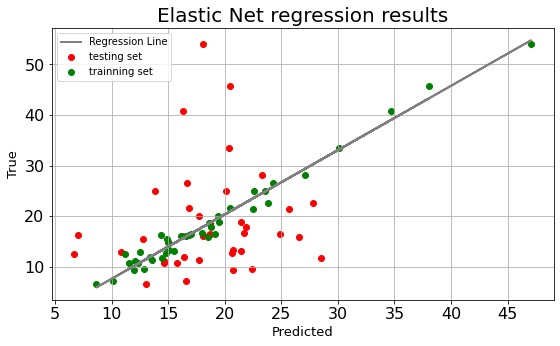

In [33]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [34]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 0.93
R2 Cv: 0.16

MAPE: 11.38
MAPE Cv: 40.61

RMSE: 2.56
RMSE Cv: 9.14


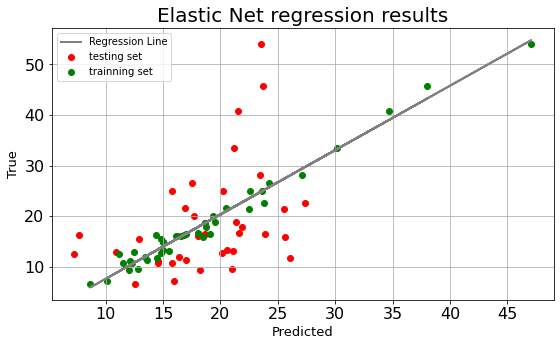

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [35]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

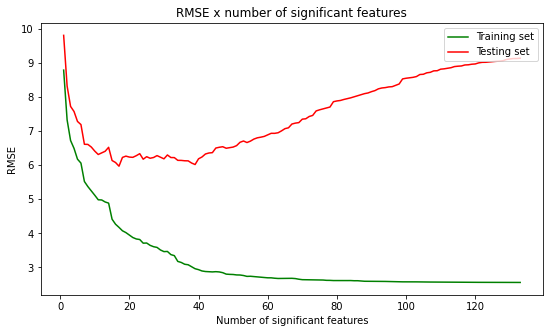

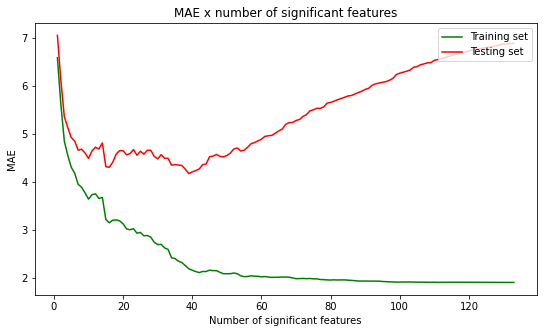

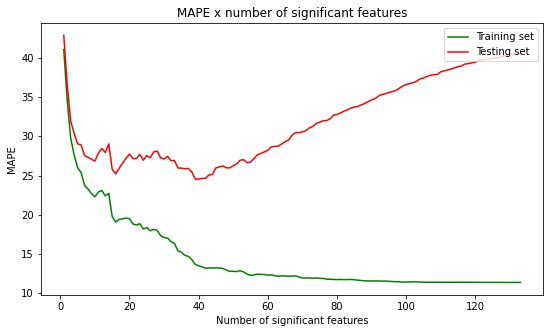

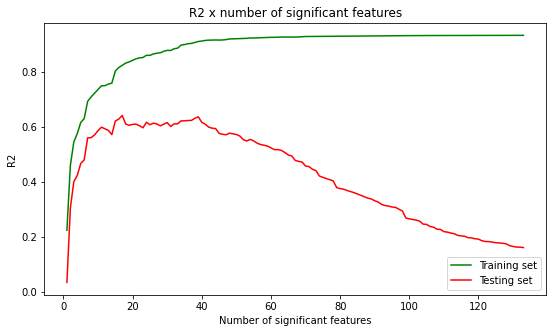

In [36]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.9
R2 Cv: 0.79

MAPE: 15.66
MAPE Cv: 23.24

RMSE: 3.17
RMSE Cv: 4.55


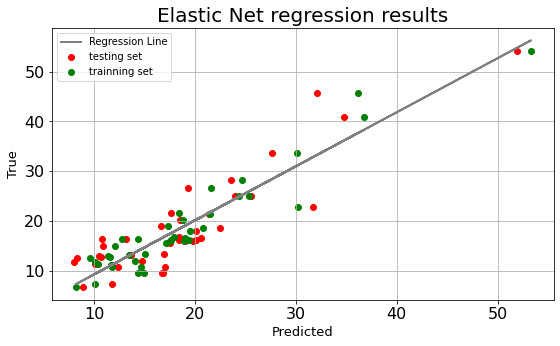

ElasticNet(alpha=0.2, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=100000, normalize=False, positive=False, precompute=True,
           random_state=None, selection='random', tol=0.0001, warm_start=False)

In [37]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

In [38]:
# Storing model metrics:

y_train_predicted, y_train_cv_predicted, r2, r2_testing_set, rmse_cv, mape_cv = get_metrics(scaled_x_train_selected, y_train, regr=regr)

In [39]:
# Storing information in variables to be later used to create the figures used in the research paper

y_train_Cmax_NEG_met = y_train.copy()

y_predicted_new_Cmax_NEG_met = y_train_predicted.copy()

y_train_cv_predicted_Cmax_NEG_met = y_train_cv_predicted.copy()

r2_Cmax_NEG_met = r2.copy()

r2_testing_set_Cmax_NEG_met = r2_testing_set.copy()

rmse_cv_Cmax_NEG_met = rmse_cv.copy()

mape_cv_Cmax_NEG_met = mape_cv.copy()

In [40]:
# Model residuals plot


# Create a df with information about training set:

df_residuals_plot = pd.DataFrame(columns=['predictions']) # creates an empty df

df_residuals_plot['predictions'] = y_predicted_new_Cmax_NEG_met # adds the predictions of training set to df

df_residuals_plot['split'] = 'Trainning Cmax'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot['Cmax'] = y_train_Cmax_NEG_met # cria uma coluna e insere os valores de referência de Cmax


# Creating the df with training set information:

df_residuals_plot_2 = pd.DataFrame(columns=['predictions']) # creates another empty df

df_residuals_plot_2['predictions'] = y_train_cv_predicted_Cmax_NEG_met # adds the predictions of validation set to df

df_residuals_plot_2['split'] = 'Predicted Cmax'  # creates a new column named 'split' and informs you that the information is from the training set

df_residuals_plot_2['Cmax'] = y_train_Cmax_NEG_met # cria uma coluna e insere os valores de referência de Cmax


# Merging previous df's (https://www.codegrepper.com/code-examples/python/add+data+to+existing+dataframe+pandas)
df_residuals_plot = df_residuals_plot.append(df_residuals_plot_2)


# Creating 'residuals' column
df_residuals_plot['residuals'] = df_residuals_plot['predictions'] - df_residuals_plot['Cmax']


# Generating the figure
# link sobre as cores(https://plotly.com/python/discrete-color/)

fig = px.scatter(
    df_residuals_plot, x='predictions', y='residuals',
    marginal_y=False,
    color='split', trendline='ols', hover_name='Cmax', color_discrete_sequence=["green", "red"],
    category_orders={"Split": ["Trainning", "Predicted"]}
)




fig.update_layout(title='Residuals plot')

fig.show()

## Clinical features

### Data import

In [41]:
# Data import and checking

df = pd.read_csv('https://drive.google.com/u/1/uc?id=1KKGhtswRNniathmrAyQPRr-_LazMPAx-&export=download', encoding='latin-1')

df.head()

,Primary ID,Cmax,AUClast,SEXO,Pressao_sistolica,Pressao_diastolica,Frequencia_Cardiaca,Temperatura,ALTURA,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH
0,FMTB_ROS_POS_EST1_1_1,28.178,218.631,F,100,70,75,36.9,1.65,68.5,25.2,26,149,53,29.2,0.6,101.6,5.0,14,10,0.43,0.19,0.24,55,7.3,4.9,14.3,5.01,43.5,87,28.5,32.9,13.1,5900,3481,118,2065,236,320000,0.14,0.06,0.13,0.19,1020,4,1,5
1,FMTB_ROS_POS_EST1_1_2,18.622,140.374,F,100,70,58,36.5,1.57,57.0,23.1,20,123,46,30.0,0.5,73.6,4.7,22,13,0.40,0.19,0.21,54,6.8,4.6,12.9,4.39,39.2,89,29.4,32.9,13.6,5600,2408,112,2520,560,207000,0.11,0.07,0.15,0.20,1025,3,1,5
2,FMTB_ROS_POS_EST1_1_3,10.771,84.440,F,130,80,60,36.5,1.65,80.0,29.4,34,190,72,28.7,0.8,92.2,4.4,14,12,0.59,0.23,0.36,76,7.4,4.6,14.6,5.25,45.1,86,27.8,32.4,14.3,8100,4779,162,2754,405,261000,0.11,0.06,0.10,0.22,1010,1,1,5
3,FMTB_ROS_POS_EST1_1_4,40.804,284.489,F,100,80,72,35.5,1.59,69.5,27.5,28,167,92,16.4,0.5,88.7,4.4,19,19,0.21,0.12,0.09,61,7.4,4.5,13.9,4.99,42.6,85,27.9,32.6,14.7,4200,2142,168,1680,210,303000,0.07,0.05,0.08,0.19,1020,2,2,6
4,FMTB_ROS_POS_EST1_1_5,16.320,142.266,F,120,80,67,36.0,1.51,66.0,28.9,27,199,127,24.0,0.6,91.4,3.4,13,17,0.24,0.12,0.12,90,7.8,4.6,15.1,5.14,45.8,89,29.4,33.0,13.4,6300,3024,315,2583,378,417000,0.10,0.06,0.19,0.20,1025,3,2,5


### AUC

In [42]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='AUClast')


Data types:

Cmax                    float64
Pressao_sistolica       float64
Pressao_diastolica      float64
Frequencia_Cardiaca     float64
Temperatura             float64
ALTURA                  float64
PESO                    float64
IMC                     float64
IDADE                   float64
Colesterol_Total        float64
Triglicerides           float64
Ureia                   float64
Creatinina              float64
Glicose_em_Jejum        float64
acido_urico             float64
TGO_AST                 float64
TGP_ALT                 float64
Bilirrubina_Total       float64
Bilirrubina_Direta      float64
Bilirrubina_Indireta    float64
Fosfatase_Alcalina      float64
ProteIna_Total          float64
Albumina                float64
Hemoglobina             float64
Hemacias                float64
Hematocrito             float64
VCM                     float64
HCM                     float64
CHCM                    float64
RDW                     float64
Leucocitos              flo

,Cmax,Pressao_sistolica,Pressao_diastolica,Frequencia_Cardiaca,Temperatura,ALTURA,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH,SEXO_F,SEXO_M
Cmax,1.000000,0.063565,0.077028,0.331017,0.174849,-0.105459,-0.093744,-0.017293,-0.376646,-0.153957,0.084106,-0.281977,-0.443017,-0.085059,-0.300204,0.019292,0.095836,-0.012761,0.012835,-0.024868,-0.098530,0.139612,0.018614,-0.123100,-0.215318,-0.153571,0.104198,0.103317,0.063284,-0.153149,-0.125193,-0.055018,0.112436,-0.190040,-0.290897,-0.106900,0.037752,-0.104651,-0.180049,0.047645,0.213998,0.451902,0.249902,-0.075327,0.312523,-0.312523
Pressao_sistolica,0.063565,1.000000,0.637971,0.149841,0.251445,0.257330,0.567850,0.458542,-0.010295,0.178998,0.133067,-0.100898,0.151537,0.055744,0.388513,0.051847,0.330772,0.113889,0.119499,0.119252,0.162893,0.317258,0.113300,0.230931,0.306422,0.272234,-0.042677,-0.058270,-0.069619,0.146383,0.169150,0.255029,0.240492,-0.051655,0.025888,0.028565,-0.011887,0.239930,0.076724,0.102107,-0.077922,-0.144111,0.125223,-0.176741,-0.202808,0.202808
Pressao_diastolica,0.077028,0.637971,1.000000,0.230280,0.050149,0.176618,0.448773,0.385233,-0.056294,0.102433,0.067269,-0.219104,-0.004691,0.239844,0.201735,0.002328,0.286447,-0.009923,0.067041,-0.041531,0.199323,0.225685,0.196286,0.033021,0.204816,0.100246,-0.188930,-0.224985,-0.261709,0.120395,0.073179,0.202376,0.234216,-0.174213,-0.123087,0.166840,0.035106,0.162114,0.115785,0.050250,-0.069465,-0.035171,0.068247,-0.101473,-0.102333,0.102333
Frequencia_Cardiaca,0.331017,0.149841,0.230280,1.000000,0.184282,0.106060,-0.008491,-0.109733,-0.229223,0.193538,0.199809,-0.286734,-0.105439,0.007886,-0.283650,0.104525,-0.036491,-0.115330,-0.136485,-0.109545,-0.112835,0.292844,0.009587,-0.077871,-0.051249,-0.049994,0.002143,-0.047163,-0.143725,-0.110794,0.144214,0.346057,-0.147002,-0.191516,-0.176197,0.221069,0.042285,0.189665,0.015252,-0.208827,0.091669,0.362615,0.331721,-0.116875,0.284439,-0.284439
Temperatura,0.174849,0.251445,0.050149,0.184282,1.000000,0.025649,-0.086583,-0.132662,-0.342159,-0.334761,-0.034641,-0.139729,-0.038017,-0.115404,0.116182,-0.055285,-0.018421,0.080645,0.073178,0.088434,-0.094275,-0.168909,0.019167,-0.208284,-0.268144,-0.222281,0.078809,0.040004,-0.029585,-0.098070,0.433218,0.541022,0.014026,0.120371,0.118177,0.086331,0.260513,0.343506,0.123736,-0.036376,0.177841,0.150294,0.063927,-0.490105,0.167868,-0.167868
ALTURA,-0.105459,0.257330,0.176618,0.106060,0.025649,1.000000,0.601267,-0.184889,0.017596,-0.035854,0.020237,0.332643,0.683641,0.218202,0.553851,0.357944,0.596643,0.443519,0.397865,0.458624,0.010437,0.163913,0.365985,0.710308,0.615211,0.727343,0.250874,0.265264,0.262578,-0.148942,-0.276696,-0.178782,0.239332,-0.451392,-0.152989,-0.502792,-0.152917,0.118715,0.066412,0.186056,0.001183,-0.448396,-0.139632,0.119252,-0.819524,0.819524
PESO,-0.093744,0.567850,0.448773,-0.008491,-0.086583,0.601267,1.000000,0.674070,0.177730,0.141974,0.044611,0.295211,0.514185,0.236014,0.616382,0.173707,0.612724,0.098327,0.102038,0.114441,0.137880,0.320569,0.196345,0.508217,0.449788,0.534005,0.176228,0.171840,0.114614,-0.021598,-0.171035,-0.111902,0.236724,-0.238802,-0.142182,-0.195636,0.019929,0.182448,-0.053043,0.278715,-0.048534,-0.336716,0.060986,0.087091,-0.518897,0.518897
IMC,-0.017293,0.458542,0.385233,-0.109733,-0.132662,-0.184889,0.674070,1.000000,0.203935,0.208716,0.036495,0.056733,0.001856,0.087016,0.246032,-0.116792,0.200857,-0.288368,-0.241921,-0.282349,0.158186,0.242622,-0.098062,-0.030620,-0.015294,-0.014789,-0.014089,-0.032739,-0.100828,0.108823,0.042973,0.024849,0.068831,0.122569,-0.034983,0.223346,0.166181,0.112913,-0.129199,0.170893,-0.062622,0.00080

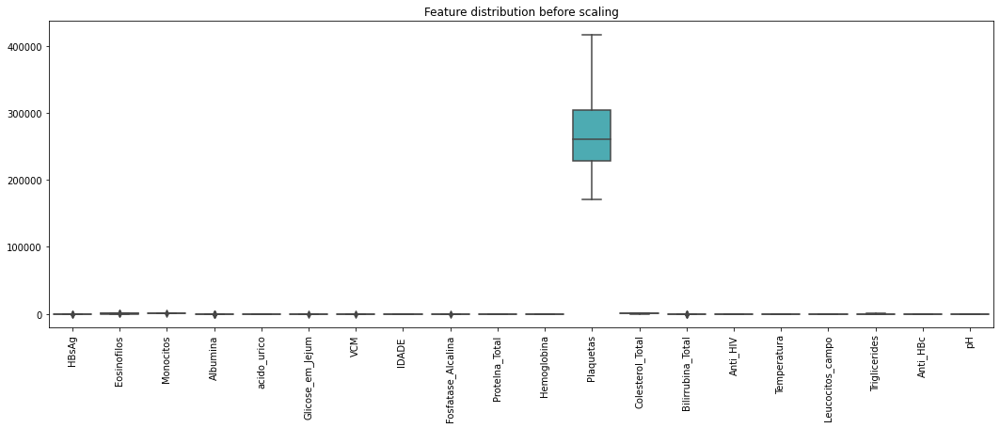

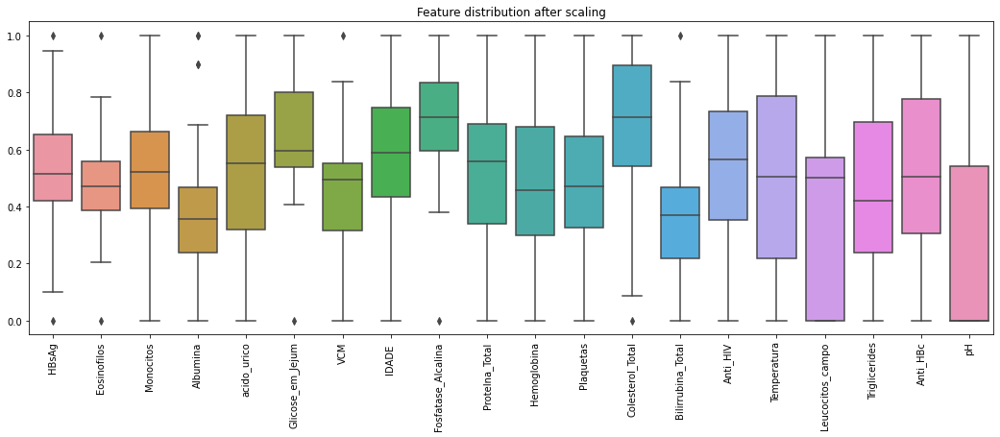

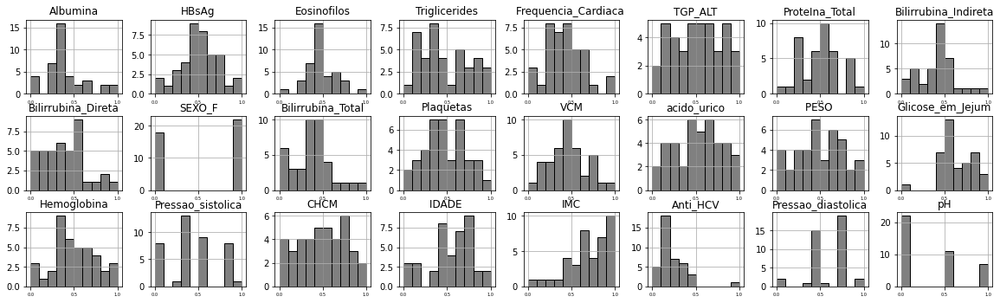

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='Cmax')

Elastic Net - Summary of results:

R2: 0.24
R2 Cv: -0.0

MAPE: 33.01
MAPE Cv: 37.31

RMSE: 64.02
RMSE Cv: 73.56


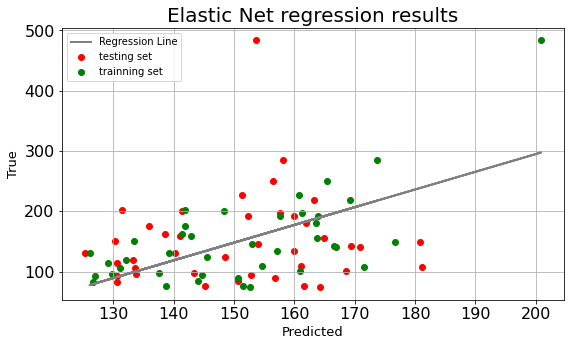

In [43]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [44]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 0.24
R2 Cv: 0.01

MAPE: 33.01
MAPE Cv: 37.11

RMSE: 64.02
RMSE Cv: 73.1


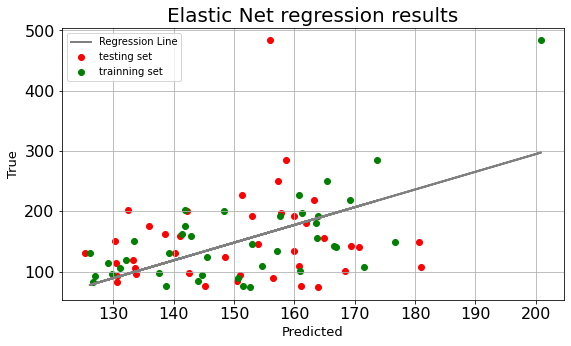

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [45]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

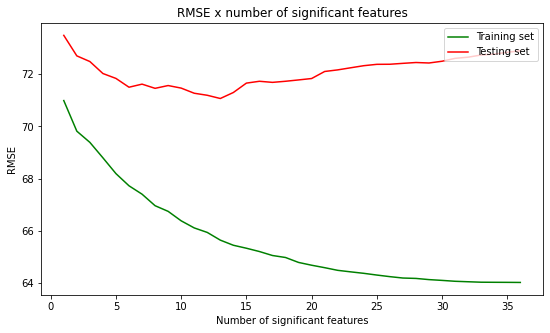

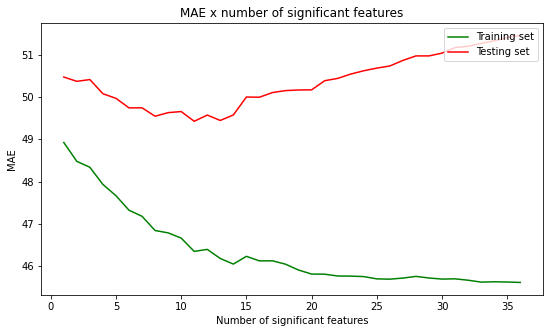

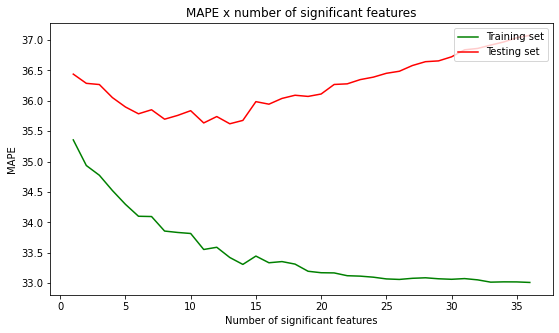

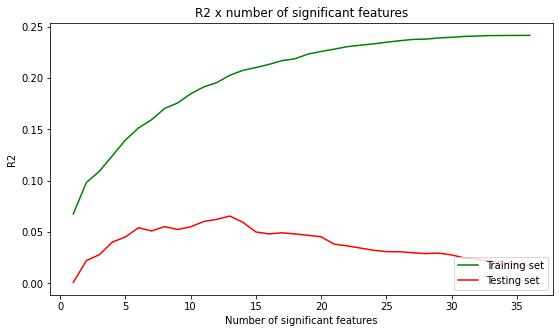

In [46]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.6
R2 Cv: 0.24

MAPE: 25.72
MAPE Cv: 33.0

RMSE: 46.53
RMSE Cv: 63.92


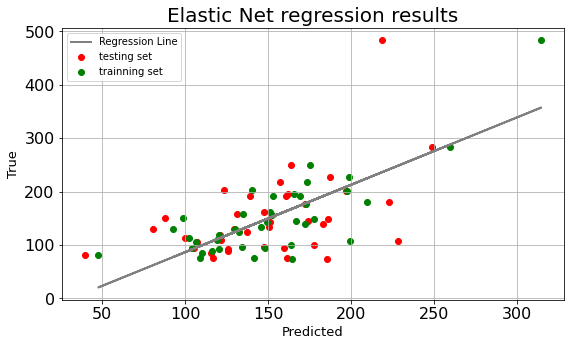

ElasticNet(alpha=0.1, copy_X=True, fit_intercept=True, l1_ratio=0.8,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='random', tol=0.0001, warm_start=True)

In [47]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

In [48]:
# Storing model metrics:

y_train_predicted, y_train_cv_predicted, r2, r2_testing_set, rmse_cv, mape_cv = get_metrics(scaled_x_train_selected, y_train, regr=regr)

In [49]:
# Storing information in variables to be later used to create the figures used in the research paper

y_train_AUC_clin = y_train.copy()

y_predicted_new_AUC_clin = y_train_predicted.copy()

y_train_cv_predicted_AUC_clin = y_train_cv_predicted.copy()



### Cmax

In [50]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='Cmax')


Data types:

Cmax                    float64
Pressao_sistolica       float64
Pressao_diastolica      float64
Frequencia_Cardiaca     float64
Temperatura             float64
ALTURA                  float64
PESO                    float64
IMC                     float64
IDADE                   float64
Colesterol_Total        float64
Triglicerides           float64
Ureia                   float64
Creatinina              float64
Glicose_em_Jejum        float64
acido_urico             float64
TGO_AST                 float64
TGP_ALT                 float64
Bilirrubina_Total       float64
Bilirrubina_Direta      float64
Bilirrubina_Indireta    float64
Fosfatase_Alcalina      float64
ProteIna_Total          float64
Albumina                float64
Hemoglobina             float64
Hemacias                float64
Hematocrito             float64
VCM                     float64
HCM                     float64
CHCM                    float64
RDW                     float64
Leucocitos              flo

,Cmax,Pressao_sistolica,Pressao_diastolica,Frequencia_Cardiaca,Temperatura,ALTURA,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH,SEXO_F,SEXO_M
Cmax,1.000000,-0.024268,0.020689,0.263483,0.160745,-0.189149,-0.241421,-0.121310,-0.381701,-0.271239,-0.014340,-0.385037,-0.537296,-0.127734,-0.286416,-0.002931,0.018761,-0.047417,-0.001342,-0.075864,-0.047583,0.123998,-0.016592,-0.230403,-0.203820,-0.233123,-0.058473,-0.076272,-0.095799,0.033581,-0.035847,0.012027,0.109251,-0.093418,-0.205793,-0.092507,0.096634,-0.077522,-0.172315,0.025681,0.142453,0.459438,0.161879,-0.099519,0.345889,-0.345889
Pressao_sistolica,-0.024268,1.000000,0.637971,0.149841,0.251445,0.257330,0.567850,0.458542,-0.010295,0.178998,0.133067,-0.100898,0.151537,0.055744,0.388513,0.051847,0.330772,0.113889,0.119499,0.119252,0.162893,0.317258,0.113300,0.230931,0.306422,0.272234,-0.042677,-0.058270,-0.069619,0.146383,0.169150,0.255029,0.240492,-0.051655,0.025888,0.028565,-0.011887,0.239930,0.076724,0.102107,-0.077922,-0.144111,0.125223,-0.176741,-0.202808,0.202808
Pressao_diastolica,0.020689,0.637971,1.000000,0.230280,0.050149,0.176618,0.448773,0.385233,-0.056294,0.102433,0.067269,-0.219104,-0.004691,0.239844,0.201735,0.002328,0.286447,-0.009923,0.067041,-0.041531,0.199323,0.225685,0.196286,0.033021,0.204816,0.100246,-0.188930,-0.224985,-0.261709,0.120395,0.073179,0.202376,0.234216,-0.174213,-0.123087,0.166840,0.035106,0.162114,0.115785,0.050250,-0.069465,-0.035171,0.068247,-0.101473,-0.102333,0.102333
Frequencia_Cardiaca,0.263483,0.149841,0.230280,1.000000,0.184282,0.106060,-0.008491,-0.109733,-0.229223,0.193538,0.199809,-0.286734,-0.105439,0.007886,-0.283650,0.104525,-0.036491,-0.115330,-0.136485,-0.109545,-0.112835,0.292844,0.009587,-0.077871,-0.051249,-0.049994,0.002143,-0.047163,-0.143725,-0.110794,0.144214,0.346057,-0.147002,-0.191516,-0.176197,0.221069,0.042285,0.189665,0.015252,-0.208827,0.091669,0.362615,0.331721,-0.116875,0.284439,-0.284439
Temperatura,0.160745,0.251445,0.050149,0.184282,1.000000,0.025649,-0.086583,-0.132662,-0.342159,-0.334761,-0.034641,-0.139729,-0.038017,-0.115404,0.116182,-0.055285,-0.018421,0.080645,0.073178,0.088434,-0.094275,-0.168909,0.019167,-0.208284,-0.268144,-0.222281,0.078809,0.040004,-0.029585,-0.098070,0.433218,0.541022,0.014026,0.120371,0.118177,0.086331,0.260513,0.343506,0.123736,-0.036376,0.177841,0.150294,0.063927,-0.490105,0.167868,-0.167868
ALTURA,-0.189149,0.257330,0.176618,0.106060,0.025649,1.000000,0.601267,-0.184889,0.017596,-0.035854,0.020237,0.332643,0.683641,0.218202,0.553851,0.357944,0.596643,0.443519,0.397865,0.458624,0.010437,0.163913,0.365985,0.710308,0.615211,0.727343,0.250874,0.265264,0.262578,-0.148942,-0.276696,-0.178782,0.239332,-0.451392,-0.152989,-0.502792,-0.152917,0.118715,0.066412,0.186056,0.001183,-0.448396,-0.139632,0.119252,-0.819524,0.819524
PESO,-0.241421,0.567850,0.448773,-0.008491,-0.086583,0.601267,1.000000,0.674070,0.177730,0.141974,0.044611,0.295211,0.514185,0.236014,0.616382,0.173707,0.612724,0.098327,0.102038,0.114441,0.137880,0.320569,0.196345,0.508217,0.449788,0.534005,0.176228,0.171840,0.114614,-0.021598,-0.171035,-0.111902,0.236724,-0.238802,-0.142182,-0.195636,0.019929,0.182448,-0.053043,0.278715,-0.048534,-0.336716,0.060986,0.087091,-0.518897,0.518897
IMC,-0.121310,0.458542,0.385233,-0.109733,-0.132662,-0.184889,0.674070,1.000000,0.203935,0.208716,0.036495,0.056733,0.001856,0.087016,0.246032,-0.116792,0.200857,-0.288368,-0.241921,-0.282349,0.158186,0.242622,-0.098062,-0.030620,-0.015294,-0.014789,-0.014089,-0.032739,-0.100828,0.108823,0.042973,0.024849,0.068831,0.122569,-0.034983,0.223346,0.166181,0.112913,-0.129199,0.170893,-0.062622,

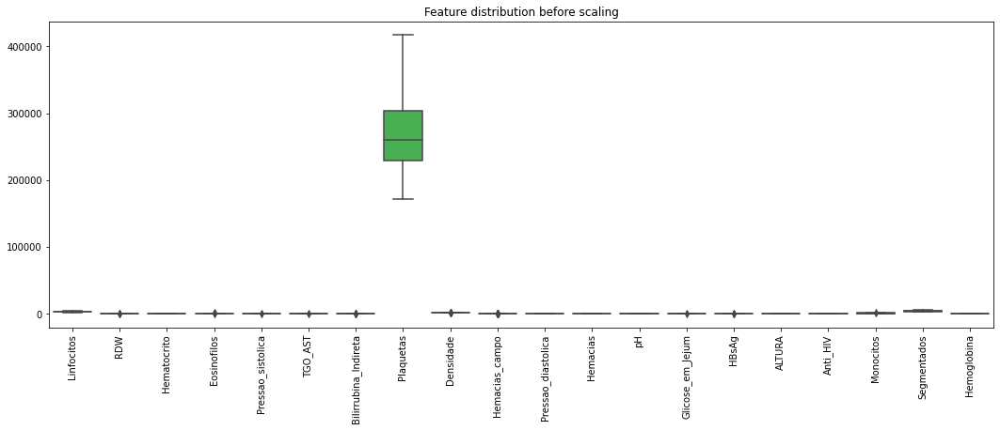

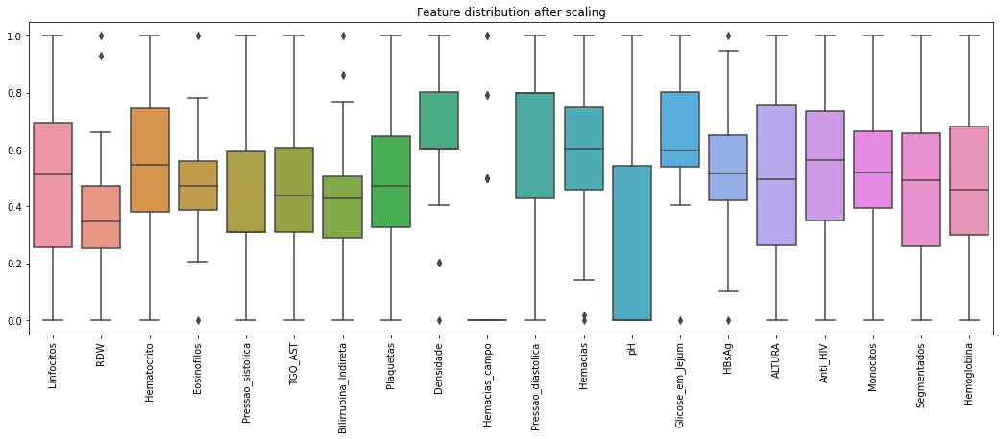

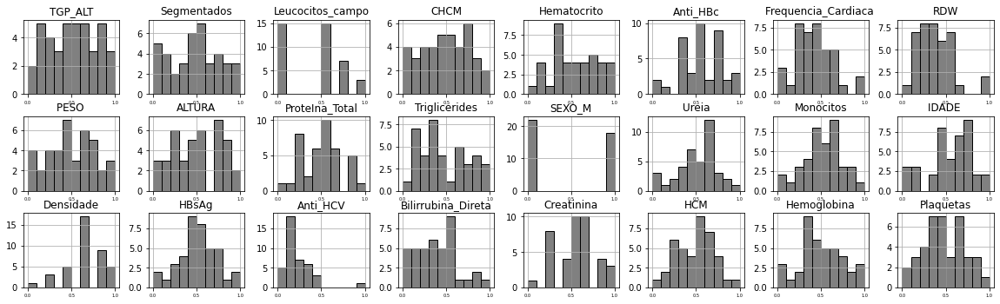

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='Cmax')

Elastic Net - Summary of results:

R2: 0.13
R2 Cv: 0.02

MAPE: 39.53
MAPE Cv: 41.62

RMSE: 9.31
RMSE Cv: 9.85


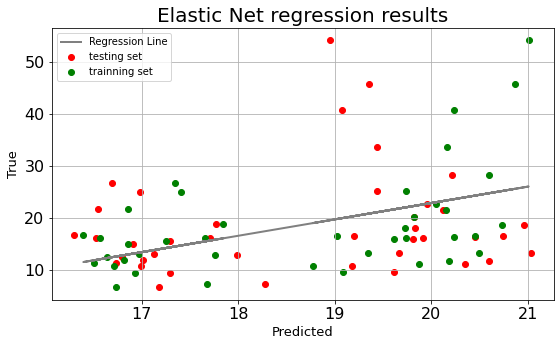

In [51]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [52]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 0.13
R2 Cv: 0.03

MAPE: 39.53
MAPE Cv: 41.58

RMSE: 9.31
RMSE Cv: 9.83


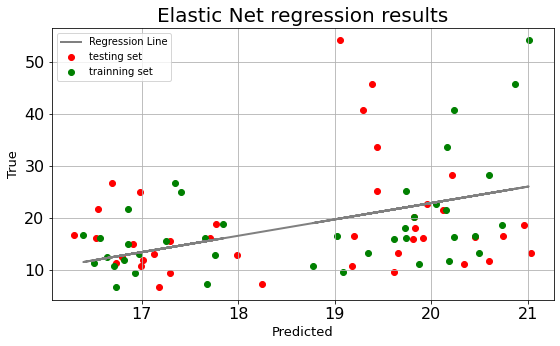

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [53]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

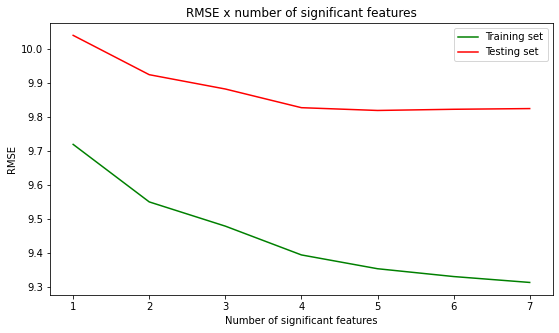

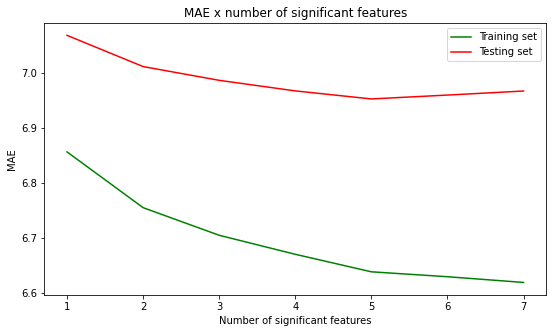

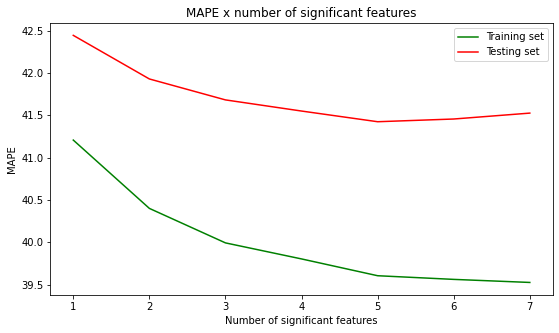

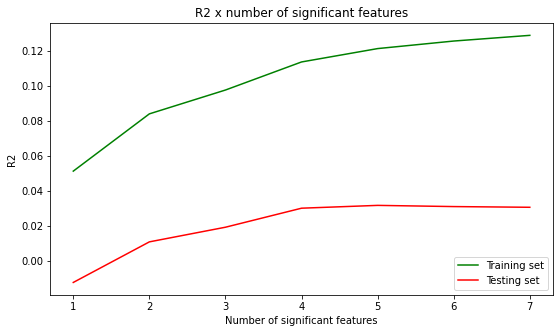

In [54]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.21
R2 Cv: 0.07

MAPE: 31.96
MAPE Cv: 34.79

RMSE: 9.05
RMSE Cv: 9.78


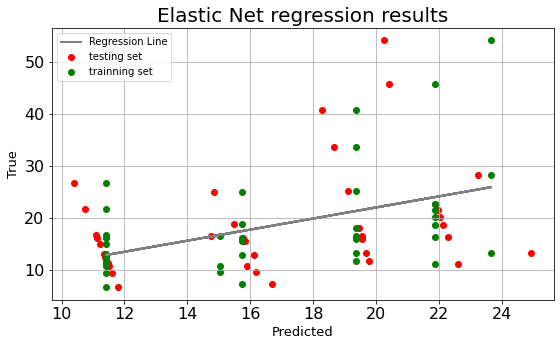

ElasticNet(alpha=0.9, copy_X=True, fit_intercept=False, l1_ratio=1.0,
           max_iter=1000, normalize=False, positive=False, precompute=True,
           random_state=None, selection='random', tol=0.0001, warm_start=False)

In [55]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

In [56]:
# Storing model metrics:

y_train_predicted, y_train_cv_predicted, r2, r2_testing_set, rmse_cv, mape_cv = get_metrics(scaled_x_train_selected, y_train, regr=regr)

In [57]:
# Storing information in variables to be later used to create the figures used in the research paper

y_train_Cmax_clin = y_train.copy()

y_predicted_new_Cmax_clin = y_train_predicted.copy()

y_train_cv_predicted_Cmax_clin = y_train_cv_predicted.copy()



## Integrated data -  ESI(+)

### Data import

In [58]:
# Data import and checking

df = pd.read_csv('https://drive.google.com/u/1/uc?id=1zp7ANAXK6pWjYfjDP4SzJ8wdhRYHFZoV&export=download', encoding='latin-1')

df.head()

,Primary ID,Cmax,AUClast,0.33_161.1057n,6.57_477.2863n,7.73_509.3844n,6.85_515.3145m/z,0.31_649.8247n,7.52_481.3173n,1.76_224.1283m/z,5.63_449.3148n,6.57_337.2738m/z,6.85_495.3333n,0.31_203.9625n,0.31_395.9039n,0.50_166.0869m/z,8.10_240.2332m/z,0.31_293.9132n,1.07_195.0880m/z,0.28_213.9107n,0.31_717.8118n,0.33_113.0592n,7.68_280.2636m/z,0.79_115.0546m/z,0.42_132.1024m/z,7.62_549.3794n,6.85_496.5649m/z,0.28_215.9439n,0.31_565.8637n,6.85_496.4548m/z,7.54_523.3642n,6.83_453.2860n,0.28_274.9806n,0.66_181.0723m/z,0.79_187.0637n,0.31_497.8759n,0.31_599.8659n,0.89_114.0921m/z,6.20_380.2560m/z,6.53_482.3247m/z,...,Temperatura,ALTURA,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH
0,FMTB_ROS_POS_EST1_1_PRÉ 1,28.178,218.631,0.510343,0.465645,0.399526,0.302997,0.426815,0.439292,0.655098,0.273693,0.207950,1.82345,0.689012,0.439087,0.307203,0.161931,0.411489,0.130649,0.625702,0.447760,0.297828,0.540264,0.187436,0.228269,0.380315,0.531635,0.409184,0.459839,0.289535,1.54284,0.342714,0.453021,0.120227,0.624828,0.488091,0.434538,0.615957,0.185085,0.365761,...,36.9,1.65,68.5,25.2,26,149,53,29.2,0.6,101.6,5.0,14,10,0.43,0.19,0.24,55,7.3,4.9,14.3,5.01,43.5,87,28.5,32.9,13.1,5900,3481,118,2065,236,320000,0.14,0.06,0.13,0.19,1020,4,1,5
1,FMTB_ROS_POS_EST1_10_PRÉ 1,33.573,250.282,0.481441,0.463180,0.381358,0.299991,0.419109,0.456273,0.694066,0.315057,0.200647,1.82522,0.689545,0.441066,0.303175,0.162950,0.409767,0.318785,0.627731,0.441020,0.278472,0.493358,0.198579,0.244842,0.352622,0.534497,0.422127,0.453171,0.291726,1.38898,0.381779,0.468559,0.274172,0.676543,0.488564,0.431263,0.639051,0.194460,0.371039,...,36.9,1.56,63.0,25.9,28,129,81,28.8,0.5,95.2,5.3,17,16,0.17,0.10,0.07,66,7.2,4.6,14.5,4.88,42.7,88,29.7,34.0,13.5,6600,3102,198,2904,396,256000,0.05,0.04,0.10,0.17,1020,2,1,6
2,FMTB_ROS_POS_EST1_11_PRÉ 1,16.210,109.506,0.496350,0.496820,0.389309,0.293026,0.407061,0.425517,0.664733,0.317699,0.221694,1.79602,0.660957,0.421251,0.319468,0.154907,0.396546,0.124029,0.604485,0.421331,0.278664,0.464005,0.197745,0.222991,0.394282,0.524551,0.406837,0.440186,0.284823,1.49651,0.346916,0.455304,0.132980,0.678889,0.465116,0.415074,0.651153,0.186898,0.373192,...,36.7,1.60,65.5,25.6,33,158,55,23.1,0.7,90.6,3.5,17,8,0.50,0.23,0.27,65,6.9,4.5,13.5,4.23,39.8,94,31.9,33.9,13.8,8600,4472,172,3182,774,332000,0.16,0.10,0.06,0.19,1020,2,1,5
3,FMTB_ROS_POS_EST1_12_PRÉ 1,11.089,76.060,0.512376,0.451143,0.384413,0.281146,0.424297,0.407304,0.686281,0.313376,0.208011,1.74917,0.691216,0.440676,0.294520,0.151564,0.411173,0.201006,0.621306,0.445905,0.283078,0.431833,0.179773,0.220072,0.368338,0.500370,0.414210,0.460174,0.273647,1.47175,0.322305,0.460945,0.190995,0.597870,0.486425,0.431999,0.670444,0.191410,0.381583,...,35.5,1.61,62.0,23.9,38,186,71,28.1,0.7,96.3,3.2,29,15,0.16,0.10,0.06,80,7.2,4.6,14.0,4.96,42.1,85,28.2,33.3,13.8,8400,4872,84,2772,672,313000,0.07,0.05,0.14,0.20,1015,3,1,7
4,FMTB_ROS_POS_EST1_13_PRÉ 1,13.330,145.164,0.462893,0.449016,0.408529,0.294207,0.412222,0.436482,0.659786,0.321649,0.211764,1.81183,0.664830,0.424293,0.295532,0.156046,0.393533,0.178316,0.606174,0.430144,0.281144,0.477727,0.189604,0.229966,0.402235,0.527503,0.405742,0.445087,0.286542,1.54060,0.359063,0.453928,0.168288,0.639758,0.468367,0.416087,0.622843,0.181283,0.369195,...,35.5,1.61,73.0,28.2,39,195,49,27.0,0.8,89.3,3.1,17,11,0.35,0.15,0.20,45,6.9,4.5,13.8,4.64,41.3,89,29.7,33.4,13.6,5800,2552,232,2552,464,231000,0.06,0.04,0.06,0.18,1015,2,1,7


### AUC

In [59]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='AUClast')


Data types:

AUClast             float64
0.33_161.1057n      float64
6.57_477.2863n      float64
7.73_509.3844n      float64
6.85_515.3145m/z    float64
                     ...   
Leucocitos_campo    float64
Hemacias_campo      float64
pH                  float64
SEXO_F              float64
SEXO_M              float64
Length: 2655, dtype: object

Missing values:

AUClast             0
0.33_161.1057n      0
6.57_477.2863n      0
7.73_509.3844n      0
6.85_515.3145m/z    0
                   ..
Leucocitos_campo    0
Hemacias_campo      0
pH                  0
SEXO_F              0
SEXO_M              0
Length: 2655, dtype: int64

Number of zeros:

AUClast              0
0.33_161.1057n       0
6.57_477.2863n       0
7.73_509.3844n       0
6.85_515.3145m/z     0
                    ..
Leucocitos_campo    15
Hemacias_campo      31
pH                  22
SEXO_F              18
SEXO_M              22
Length: 2655, dtype: int64



Correlations, boxplots and histograms of scaled features:



,AUClast,0.33_161.1057n,6.57_477.2863n,7.73_509.3844n,6.85_515.3145m/z,0.31_649.8247n,7.52_481.3173n,1.76_224.1283m/z,5.63_449.3148n,6.57_337.2738m/z,6.85_495.3333n,0.31_203.9625n,0.31_395.9039n,0.50_166.0869m/z,8.10_240.2332m/z,0.31_293.9132n,1.07_195.0880m/z,0.28_213.9107n,0.31_717.8118n,0.33_113.0592n,7.68_280.2636m/z,0.79_115.0546m/z,0.42_132.1024m/z,7.62_549.3794n,6.85_496.5649m/z,0.28_215.9439n,0.31_565.8637n,6.85_496.4548m/z,7.54_523.3642n,6.83_453.2860n,0.28_274.9806n,0.66_181.0723m/z,0.79_187.0637n,0.31_497.8759n,0.31_599.8659n,0.89_114.0921m/z,6.20_380.2560m/z,6.53_482.3247m/z,0.79_204.0897n,4.58_363.2167m/z,...,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH,SEXO_F,SEXO_M
AUClast,1.000000,-0.115486,-0.085532,-0.120972,-0.043142,0.295786,-0.069373,-0.000605,-0.213327,-0.188074,-0.149408,0.384752,0.379231,-0.245129,0.019959,0.151988,0.274643,0.489159,0.343238,-0.006285,0.013102,0.103995,-0.316298,0.092532,-0.183498,0.227207,0.333898,-0.111669,-0.342511,0.144805,0.154863,0.104608,0.112764,0.371223,0.362096,0.046132,0.000081,-0.198014,0.088356,0.255977,...,-0.095407,-0.035755,-0.355214,-0.153795,0.054559,-0.267297,-0.405560,-0.091779,-0.266263,0.014370,0.107740,-0.004378,0.011540,-0.010067,-0.109190,0.143855,0.018826,-0.120380,-0.226363,-0.155457,0.108453,0.110781,0.064279,-0.144546,-0.124138,-0.056825,0.079983,-0.177419,-0.278784,-0.093297,0.067605,-0.053877,-0.202153,0.056114,0.214277,0.476158,0.216659,-0.076306,0.312523,-0.312523
0.33_161.1057n,-0.115486,1.000000,-0.254296,0.088077,0.143549,-0.147899,-0.128781,0.106250,-0.139180,-0.283549,0.096223,-0.177475,-0.097338,-0.079701,-0.086638,0.051642,-0.446257,-0.220673,-0.131668,0.116425,-0.038957,0.015051,0.012932,0.283557,0.139981,0.002568,-0.164927,0.131947,0.143415,-0.214058,-0.041473,-0.428833,-0.038101,-0.106725,-0.112433,0.073885,0.080052,-0.010630,-0.041120,-0.100021,...,0.200534,0.003871,0.046426,0.163401,0.007208,0.252148,0.255572,0.206099,0.355151,0.198087,0.189735,-0.098584,-0.116467,-0.090269,-0.012727,0.184524,0.115287,0.297068,0.180349,0.277828,0.176842,0.201921,0.197528,-0.144206,-0.411632,-0.388670,-0.095481,-0.316180,-0.117831,0.014161,-0.093203,-0.063892,0.264753,-0.089598,-0.082281,-0.040568,0.008283,0.190892,-0.313513,0.313513
6.57_477.2863n,-0.085532,-0.254296,1.000000,0.141841,0.084452,-0.184265,0.304798,-0.173439,0.305744,0.971413,0.021249,-0.058798,-0.186372,-0.023232,-0.016369,-0.317145,-0.122355,-0.222880,-0.175580,-0.348227,-0.047460,-0.033064,-0.005825,0.055301,0.024517,-0.096995,-0.074785,0.049019,0.125823,0.122269,-0.081839,-0.064518,-0.035497,-0.223610,-0.161857,-0.078563,-0.276450,0.174307,-0.040911,0.035305,...,-0.414597,-0.485801,-0.221391,-0.334004,-0.108411,-0.229466,-0.210679,-0.043017,-0.244906,0.097752,-0.049707,0.404229,0.305294,0.432586,-0.008329,-0.118505,0.229790,-0.138270,-0.069547,-0.136650,-0.099956,-0.106066,-0.057155,0.087358,0.267196,0.243508,0.194033,0.156412,0.261653,-0.023498,0.136278,0.076332,-0.027062,-0.062672,-0.071416,0.022183,-0.213449,0.006290,0.018237,-0.018237
7.73_509.3844n,-0.120972,0.088077,0.141841,1.000000,0.391400,-0.352551,0.149479,-0.092085,-0.018451,0.170577,0.188238,-0.319560,-0.370972,-0.014565,-0.155415,-0.223788,-0.185851,-0.397016,-0.301133,-0.066179,-0.042854,-0.227795,0.049276,0.358874,0.262164,-0.221579,-0.302358,0.208222,0.543387,-0.306113,-0.254498,-0.151306,-0.186668,-0.420588,-0.340200,-0.356043,-0.026675,0.002553,-0.244728,-0.116985,...,0.022935,0.004700,0.248150,0.275398,-0.142978,0.155598,0.255044,0.156000,0.040620,0.187962,0.095085,0.134182,0.079906,0.151366,0.259657,-0.096309,-0.081655,0.250315,0.023152,0.199049,0.338473,0.356964,0.3128

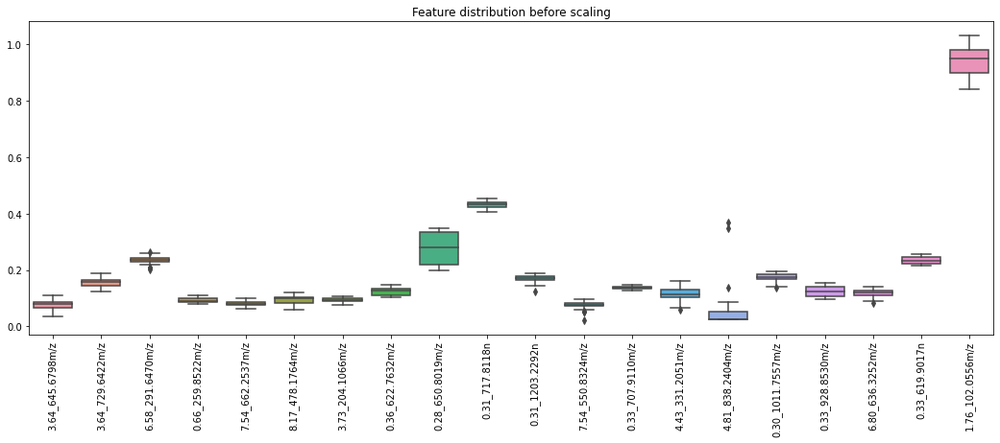

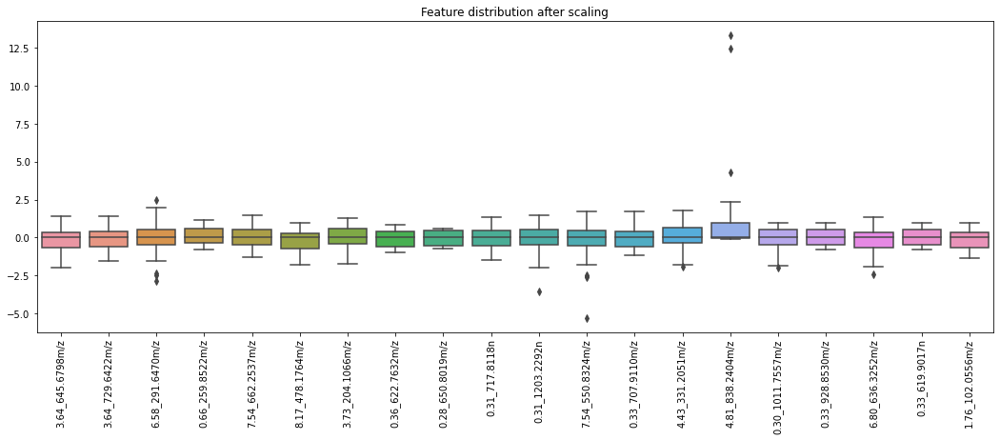

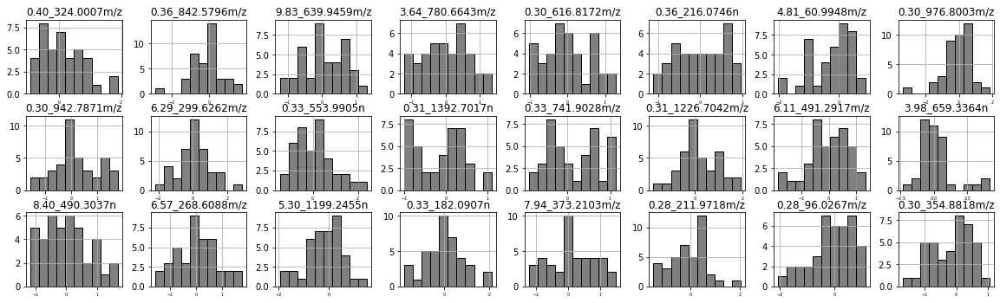

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='AUClast')

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.23

MAPE: 2.26
MAPE Cv: 35.56

RMSE: 3.92
RMSE Cv: 64.86


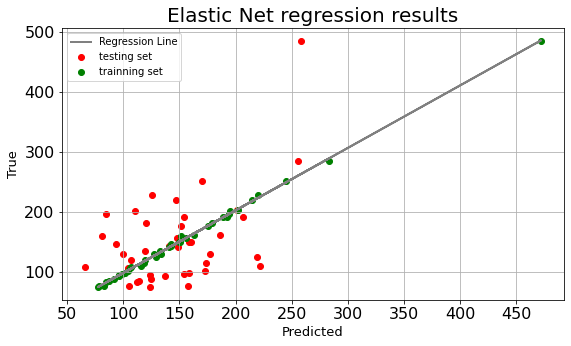

In [60]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [61]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.41

MAPE: 2.26
MAPE Cv: 32.45

RMSE: 3.92
RMSE Cv: 56.49


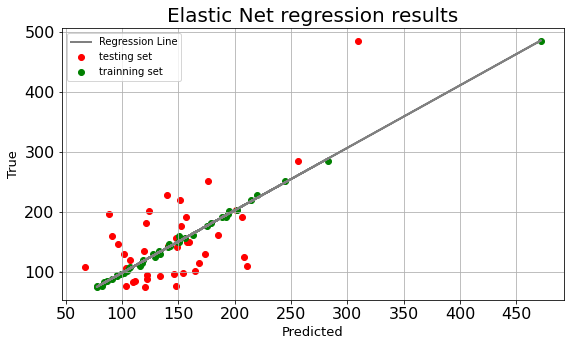

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [62]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

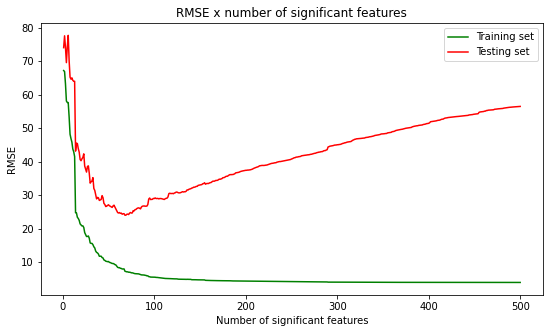

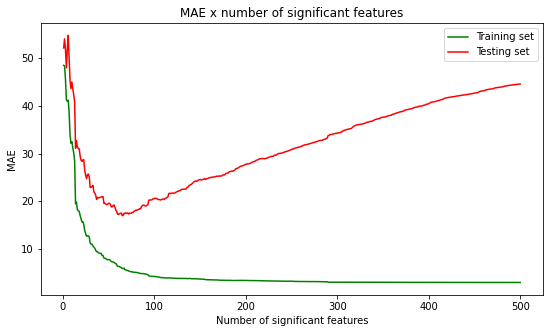

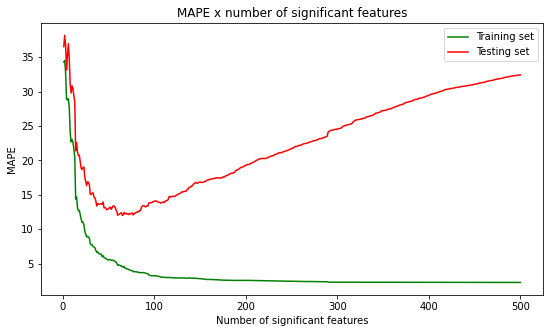

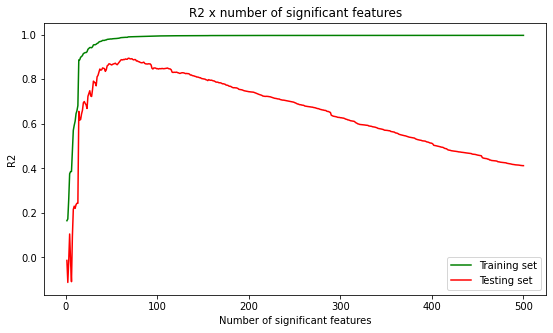

A saída de streaming foi truncada nas últimas 5000 linhas.
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 3986.3609429296594, tolerance: 111.75498372740002

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 8547.297127449987, tolerance: 109.6546757614

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 2950.7143751330186, tolerance: 111.3793616309

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations

In [63]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.94

MAPE: 2.05
MAPE Cv: 10.22

RMSE: 3.38
RMSE Cv: 18.32


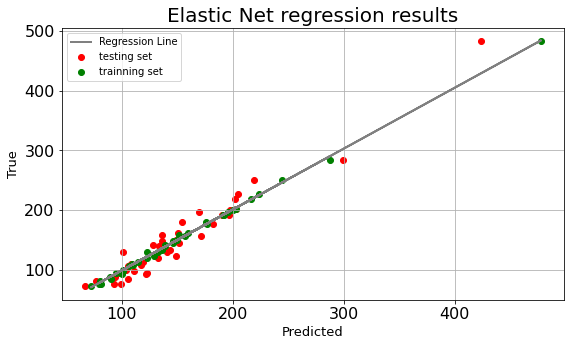

ElasticNet(alpha=0.2, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=10000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='random', tol=0.0001, warm_start=True)

In [64]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

### Cmax

In [65]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='Cmax')


Data types:

Cmax                float64
0.33_161.1057n      float64
6.57_477.2863n      float64
7.73_509.3844n      float64
6.85_515.3145m/z    float64
                     ...   
Leucocitos_campo    float64
Hemacias_campo      float64
pH                  float64
SEXO_F              float64
SEXO_M              float64
Length: 2655, dtype: object

Missing values:

Cmax                0
0.33_161.1057n      0
6.57_477.2863n      0
7.73_509.3844n      0
6.85_515.3145m/z    0
                   ..
Leucocitos_campo    0
Hemacias_campo      0
pH                  0
SEXO_F              0
SEXO_M              0
Length: 2655, dtype: int64

Number of zeros:

Cmax                 0
0.33_161.1057n       0
6.57_477.2863n       0
7.73_509.3844n       0
6.85_515.3145m/z     0
                    ..
Leucocitos_campo    15
Hemacias_campo      31
pH                  22
SEXO_F              18
SEXO_M              22
Length: 2655, dtype: int64



Correlations, boxplots and histograms of scaled features:



,Cmax,0.33_161.1057n,6.57_477.2863n,7.73_509.3844n,6.85_515.3145m/z,0.31_649.8247n,7.52_481.3173n,1.76_224.1283m/z,5.63_449.3148n,6.57_337.2738m/z,6.85_495.3333n,0.31_203.9625n,0.31_395.9039n,0.50_166.0869m/z,8.10_240.2332m/z,0.31_293.9132n,1.07_195.0880m/z,0.28_213.9107n,0.31_717.8118n,0.33_113.0592n,7.68_280.2636m/z,0.79_115.0546m/z,0.42_132.1024m/z,7.62_549.3794n,6.85_496.5649m/z,0.28_215.9439n,0.31_565.8637n,6.85_496.4548m/z,7.54_523.3642n,6.83_453.2860n,0.28_274.9806n,0.66_181.0723m/z,0.79_187.0637n,0.31_497.8759n,0.31_599.8659n,0.89_114.0921m/z,6.20_380.2560m/z,6.53_482.3247m/z,0.79_204.0897n,4.58_363.2167m/z,...,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH,SEXO_F,SEXO_M
Cmax,1.000000,-0.201650,0.092896,-0.132976,-0.090477,0.257591,-0.073084,0.032452,-0.065811,-0.008001,-0.172759,0.381411,0.351557,-0.176884,-0.011881,0.104236,0.250806,0.467226,0.310114,-0.102513,-0.025671,0.158556,-0.252910,-0.023117,-0.218001,0.237066,0.339313,-0.160775,-0.335082,0.086444,0.186314,0.135511,0.167548,0.342899,0.320869,0.105362,0.004899,-0.161177,0.142724,0.211466,...,-0.233403,-0.138227,-0.371180,-0.270592,-0.049487,-0.355163,-0.488367,-0.134714,-0.269648,0.002938,0.038409,0.016369,0.025053,0.012916,-0.073888,0.125963,-0.018029,-0.226697,-0.215716,-0.235489,-0.052014,-0.065770,-0.094165,0.045080,-0.025297,0.017422,0.075713,-0.075962,-0.177665,-0.080365,0.112230,-0.062080,-0.202899,0.028636,0.142309,0.478468,0.127013,-0.102602,0.345889,-0.345889
0.33_161.1057n,-0.201650,1.000000,-0.254296,0.088077,0.143549,-0.147899,-0.128781,0.106250,-0.139180,-0.283549,0.096223,-0.177475,-0.097338,-0.079701,-0.086638,0.051642,-0.446257,-0.220673,-0.131668,0.116425,-0.038957,0.015051,0.012932,0.283557,0.139981,0.002568,-0.164927,0.131947,0.143415,-0.214058,-0.041473,-0.428833,-0.038101,-0.106725,-0.112433,0.073885,0.080052,-0.010630,-0.041120,-0.100021,...,0.200534,0.003871,0.046426,0.163401,0.007208,0.252148,0.255572,0.206099,0.355151,0.198087,0.189735,-0.098584,-0.116467,-0.090269,-0.012727,0.184524,0.115287,0.297068,0.180349,0.277828,0.176842,0.201921,0.197528,-0.144206,-0.411632,-0.388670,-0.095481,-0.316180,-0.117831,0.014161,-0.093203,-0.063892,0.264753,-0.089598,-0.082281,-0.040568,0.008283,0.190892,-0.313513,0.313513
6.57_477.2863n,0.092896,-0.254296,1.000000,0.141841,0.084452,-0.184265,0.304798,-0.173439,0.305744,0.971413,0.021249,-0.058798,-0.186372,-0.023232,-0.016369,-0.317145,-0.122355,-0.222880,-0.175580,-0.348227,-0.047460,-0.033064,-0.005825,0.055301,0.024517,-0.096995,-0.074785,0.049019,0.125823,0.122269,-0.081839,-0.064518,-0.035497,-0.223610,-0.161857,-0.078563,-0.276450,0.174307,-0.040911,0.035305,...,-0.414597,-0.485801,-0.221391,-0.334004,-0.108411,-0.229466,-0.210679,-0.043017,-0.244906,0.097752,-0.049707,0.404229,0.305294,0.432586,-0.008329,-0.118505,0.229790,-0.138270,-0.069547,-0.136650,-0.099956,-0.106066,-0.057155,0.087358,0.267196,0.243508,0.194033,0.156412,0.261653,-0.023498,0.136278,0.076332,-0.027062,-0.062672,-0.071416,0.022183,-0.213449,0.006290,0.018237,-0.018237
7.73_509.3844n,-0.132976,0.088077,0.141841,1.000000,0.391400,-0.352551,0.149479,-0.092085,-0.018451,0.170577,0.188238,-0.319560,-0.370972,-0.014565,-0.155415,-0.223788,-0.185851,-0.397016,-0.301133,-0.066179,-0.042854,-0.227795,0.049276,0.358874,0.262164,-0.221579,-0.302358,0.208222,0.543387,-0.306113,-0.254498,-0.151306,-0.186668,-0.420588,-0.340200,-0.356043,-0.026675,0.002553,-0.244728,-0.116985,...,0.022935,0.004700,0.248150,0.275398,-0.142978,0.155598,0.255044,0.156000,0.040620,0.187962,0.095085,0.134182,0.079906,0.151366,0.259657,-0.096309,-0.081655,0.250315,0.023152,0.199049,0.338473,0.356964,0.312881,-0

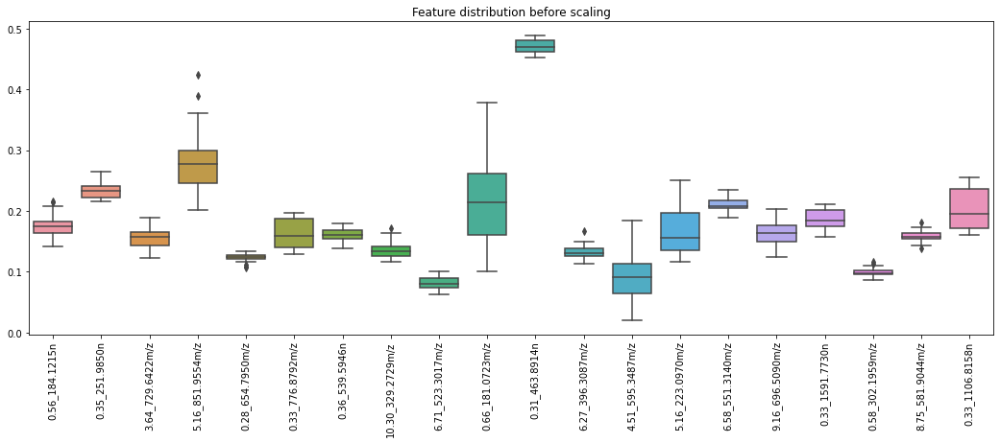

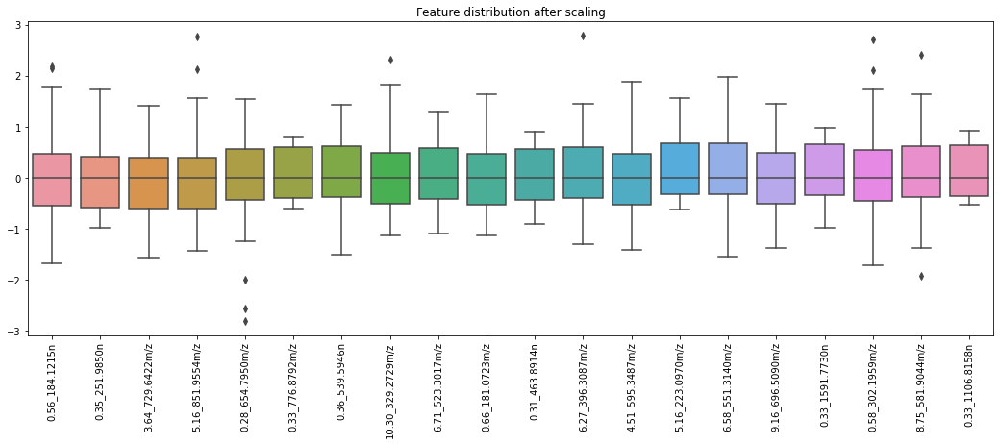

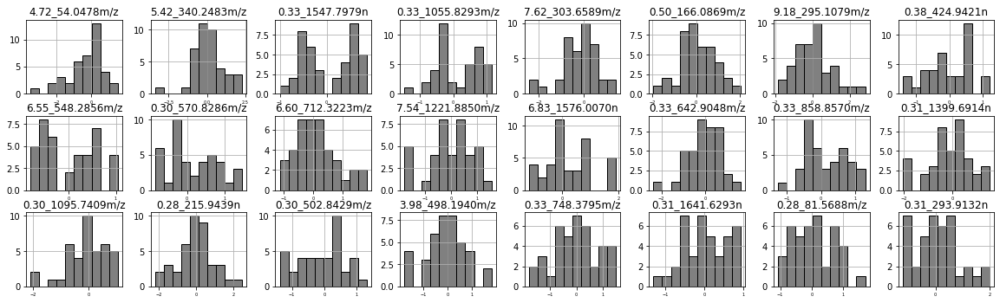

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='Cmax')

Elastic Net - Summary of results:

R2: 0.95
R2 Cv: 0.2

MAPE: 9.58
MAPE Cv: 41.17

RMSE: 2.14
RMSE Cv: 8.93


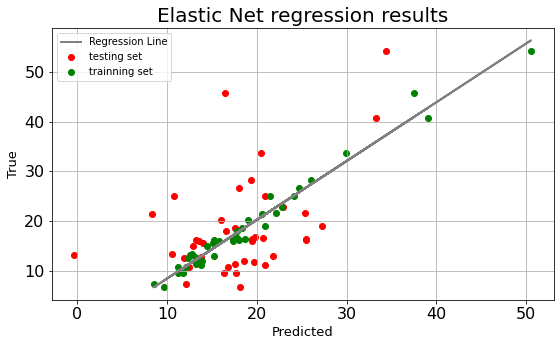

In [66]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [67]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 0.95
R2 Cv: 0.35

MAPE: 9.58
MAPE Cv: 37.83

RMSE: 2.14
RMSE Cv: 8.09


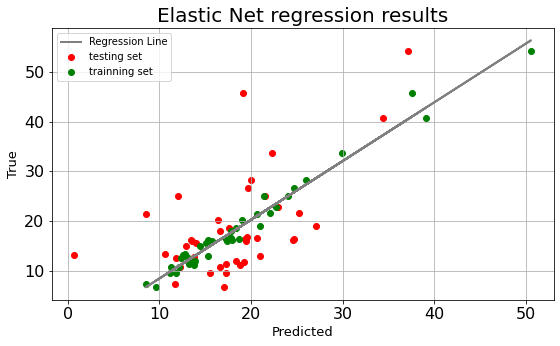

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [68]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

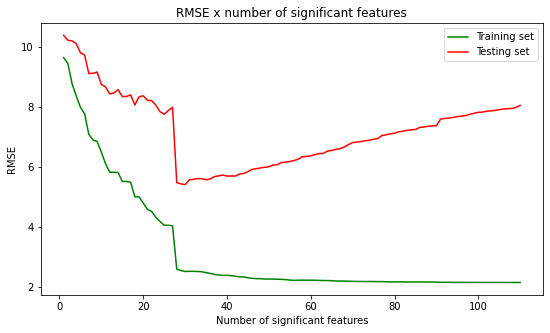

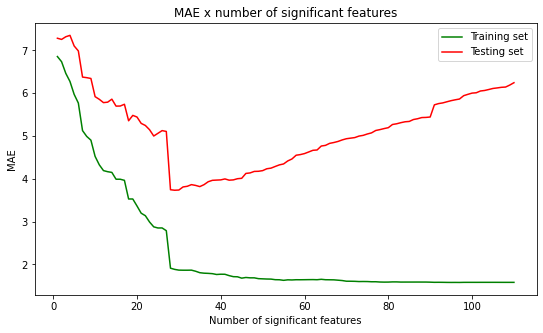

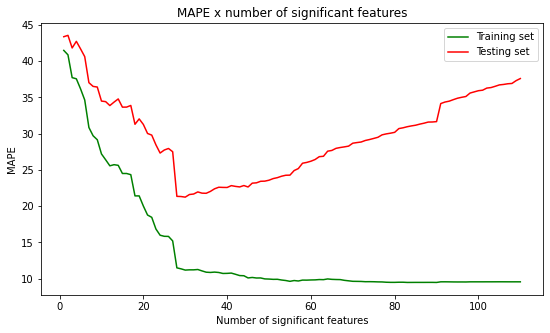

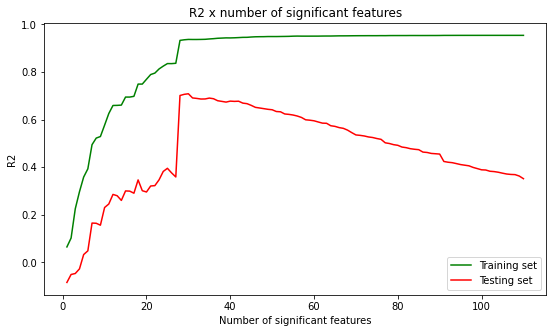

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.4791647422498535, tolerance: 0.39764196295897436

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7738318575860887, tolerance: 0.39764196295897436

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.7481816000396222, tolerance: 0.39764196295897436

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8109115274116547, tolerance: 0

In [69]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.99
R2 Cv: 0.93

MAPE: 5.23
MAPE Cv: 11.44

RMSE: 1.08
RMSE Cv: 2.69


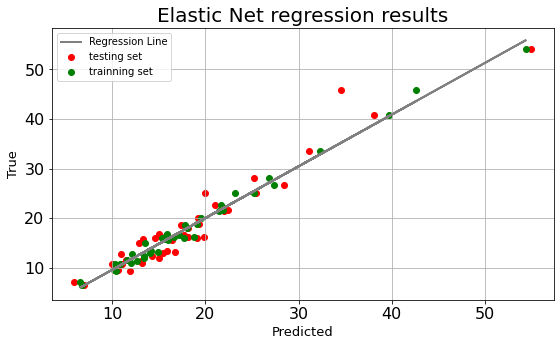

ElasticNet(alpha=0.2, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=10000, normalize=False, positive=False, precompute=True,
           random_state=None, selection='random', tol=0.0001, warm_start=False)

In [70]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

## Integrated data -  ESI(-)

### Data import

In [71]:
# Data import and checking

df = pd.read_csv('https://drive.google.com/u/1/uc?id=1jpYd6FWv1Jh44FoMuR9E0q9Yb3FlTNvN&export=download', encoding='latin-1')

df.head()

,Primary ID,Cmax,AUClast,8.42_1562.1277m/z,6.48_1605.9970m/z,5.40_532.0377m/z,0.36_1158.2420m/z,0.28_702.7730m/z,7.27_411.3828m/z,0.30_1109.3108n,0.30_1162.2781n,7.87_1696.0852m/z,10.80_279.6138m/z,5.32_52.8654m/z,0.36_1174.2883m/z,0.30_1034.2937n,0.28_1142.6516m/z,10.39_1636.1421m/z,10.46_1557.1500m/z,0.30_1136.2752n,4.93_1433.5379m/z,3.85_1410.2592n,7.75_1516.1052m/z,0.28_424.8487m/z,6.62_1377.8661m/z,0.28_308.9068m/z,0.30_1425.7036m/z,6.73_1666.9602m/z,0.30_1068.2870n,10.39_1654.1111m/z,5.33_52.8715m/z,6.58_1640.9614m/z,2.67_186.1128m/z,0.87_1598.9514m/z,0.30_1441.7021m/z,0.31_309.9232n,0.30_1530.7095n,0.30_768.3589n,7.50_529.4240m/z,7.45_1555.1353m/z,...,Temperatura,ALTURA,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH
0,FMTB_ROS_NEG_EST1_1_PRÉ 1,28.178,218.631,0.225370,0.141611,0.287875,0.227349,0.129962,0.161788,0.147115,0.126081,0.249930,0.094970,0.184281,0.229366,0.146059,0.083120,0.354956,0.335943,0.022738,0.173664,0.090757,0.197017,0.130033,0.146397,0.147378,0.136056,0.191404,0.161390,0.340345,0.144204,0.159797,0.214666,0.130890,0.158562,0.221938,0.119972,0.153972,0.166660,0.261703,...,36.9,1.65,68.5,25.2,26,149,53,29.2,0.6,101.6,5.0,14,10,0.43,0.19,0.24,55,7.3,4.9,14.3,5.01,43.5,87,28.5,32.9,13.1,5900,3481,118,2065,236,320000,0.14,0.06,0.13,0.19,1020,4,1,5
1,FMTB_ROS_NEG_EST1_10_PRÉ 1,33.573,250.282,0.161022,0.129152,0.385910,0.185915,0.204067,0.195144,0.200405,0.183546,0.193217,0.241812,0.148582,0.218137,0.189542,0.179475,0.230722,0.236630,0.182656,0.138192,0.114452,0.194612,0.187287,0.120934,0.224918,0.167085,0.204735,0.148022,0.208040,0.066628,0.174582,0.149385,0.046041,0.119008,0.135372,0.226574,0.186569,0.179802,0.172875,...,36.9,1.56,63.0,25.9,28,129,81,28.8,0.5,95.2,5.3,17,16,0.17,0.10,0.07,66,7.2,4.6,14.5,4.88,42.7,88,29.7,34.0,13.5,6600,3102,198,2904,396,256000,0.05,0.04,0.10,0.17,1020,2,1,6
2,FMTB_ROS_NEG_EST1_11_PRÉ 1,16.210,109.506,0.148616,0.206605,0.240161,0.201431,0.125608,0.167877,0.050750,0.035189,0.144549,0.254545,0.236413,0.181075,0.161854,0.122373,0.267778,0.232823,0.155853,0.167368,0.112217,0.297580,0.125114,0.188785,0.141778,0.181196,0.183843,0.143729,0.171245,0.166722,0.099702,0.188307,0.090376,0.182315,0.213977,0.178866,0.168919,0.169897,0.157057,...,36.7,1.60,65.5,25.6,33,158,55,23.1,0.7,90.6,3.5,17,8,0.50,0.23,0.27,65,6.9,4.5,13.5,4.23,39.8,94,31.9,33.9,13.8,8600,4472,172,3182,774,332000,0.16,0.10,0.06,0.19,1020,2,1,5
3,FMTB_ROS_NEG_EST1_12_PRÉ 1,11.089,76.060,0.146848,0.111748,0.383022,0.210697,0.193060,0.313450,0.147290,0.201644,0.137769,0.253644,0.192995,0.206148,0.197096,0.151455,0.293495,0.290796,0.178353,0.142281,0.135455,0.299123,0.191866,0.160583,0.217190,0.164329,0.214343,0.187121,0.251583,0.147834,0.109427,0.127727,0.109604,0.161870,0.142097,0.190926,0.194432,0.125712,0.197743,...,35.5,1.61,62.0,23.9,38,186,71,28.1,0.7,96.3,3.2,29,15,0.16,0.10,0.06,80,7.2,4.6,14.0,4.96,42.1,85,28.2,33.3,13.8,8400,4872,84,2772,672,313000,0.07,0.05,0.14,0.20,1015,3,1,7
4,FMTB_ROS_NEG_EST1_13_PRÉ 1,13.330,145.164,0.117544,0.221418,0.255417,0.237148,0.127275,0.196918,0.130559,0.104679,0.149428,0.254976,0.241636,0.192633,0.151453,0.100445,0.227051,0.202931,0.130097,0.174069,0.142664,0.232037,0.129857,0.175823,0.135357,0.159599,0.180049,0.154937,0.164362,0.165502,0.149349,0.160189,0.112871,0.183294,0.221987,0.210556,0.173079,0.210710,0.108683,...,35.5,1.61,73.0,28.2,39,195,49,27.0,0.8,89.3,3.1,17,11,0.35,0.15,0.20,45,6.9,4.5,13.8,4.64,41.3,89,29.7,33.4,13.6,5800,2552,232,2552,464,231000,0.06,0.04,0.06,0.18,1015,2,1,7


### AUC

In [72]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='AUClast')


Data types:

AUClast              float64
8.42_1562.1277m/z    float64
6.48_1605.9970m/z    float64
5.40_532.0377m/z     float64
0.36_1158.2420m/z    float64
                      ...   
Leucocitos_campo     float64
Hemacias_campo       float64
pH                   float64
SEXO_F               float64
SEXO_M               float64
Length: 2492, dtype: object

Missing values:

AUClast              0
8.42_1562.1277m/z    0
6.48_1605.9970m/z    0
5.40_532.0377m/z     0
0.36_1158.2420m/z    0
                    ..
Leucocitos_campo     0
Hemacias_campo       0
pH                   0
SEXO_F               0
SEXO_M               0
Length: 2492, dtype: int64

Number of zeros:

AUClast               0
8.42_1562.1277m/z     0
6.48_1605.9970m/z     0
5.40_532.0377m/z      0
0.36_1158.2420m/z     0
                     ..
Leucocitos_campo     15
Hemacias_campo       31
pH                   22
SEXO_F               18
SEXO_M               22
Length: 2492, dtype: int64



Correlations, boxplots and hi

,AUClast,8.42_1562.1277m/z,6.48_1605.9970m/z,5.40_532.0377m/z,0.36_1158.2420m/z,0.28_702.7730m/z,7.27_411.3828m/z,0.30_1109.3108n,0.30_1162.2781n,7.87_1696.0852m/z,10.80_279.6138m/z,5.32_52.8654m/z,0.36_1174.2883m/z,0.30_1034.2937n,0.28_1142.6516m/z,10.39_1636.1421m/z,10.46_1557.1500m/z,0.30_1136.2752n,4.93_1433.5379m/z,3.85_1410.2592n,7.75_1516.1052m/z,0.28_424.8487m/z,6.62_1377.8661m/z,0.28_308.9068m/z,0.30_1425.7036m/z,6.73_1666.9602m/z,0.30_1068.2870n,10.39_1654.1111m/z,5.33_52.8715m/z,6.58_1640.9614m/z,2.67_186.1128m/z,0.87_1598.9514m/z,0.30_1441.7021m/z,0.31_309.9232n,0.30_1530.7095n,0.30_768.3589n,7.50_529.4240m/z,7.45_1555.1353m/z,0.71_1657.9323m/z,3.55_195.8102m/z,...,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH,SEXO_F,SEXO_M
AUClast,1.000000,0.200417,-0.153769,0.022801,0.535547,-0.075748,-0.044176,0.333227,0.069622,0.342845,-0.075710,-0.169776,0.244892,-0.096756,-0.021577,-0.070570,0.007683,0.011857,-0.310513,-0.147687,-0.272442,-0.053270,-0.188409,-0.040890,-0.046307,-0.232102,-0.076489,-0.034795,-0.090245,0.378544,0.061383,-0.042820,-0.044201,0.181248,-0.016489,0.080656,0.043006,0.092038,-0.088126,-0.299106,...,-0.095407,-0.035755,-0.355214,-0.153795,0.054559,-0.267297,-0.405560,-0.091779,-0.266263,0.014370,0.107740,-0.004378,0.011540,-0.010067,-0.109190,0.143855,0.018826,-0.120380,-0.226363,-0.155457,0.108453,0.110781,0.064279,-0.144546,-0.124138,-0.056825,0.079983,-0.177419,-0.278784,-0.093297,0.067605,-0.053877,-0.202153,0.056114,0.214277,0.476158,0.216659,-0.076306,0.312523,-0.312523
8.42_1562.1277m/z,0.200417,1.000000,-0.333496,0.148249,0.105490,-0.135709,-0.243937,0.226168,0.088690,0.800591,-0.631432,-0.383297,0.039674,-0.067877,-0.325326,0.516005,0.466989,-0.088553,-0.065238,-0.116999,0.027312,-0.018936,-0.130654,-0.056341,-0.205995,-0.456969,0.036363,0.662461,-0.201900,0.394490,0.219806,-0.060836,-0.050520,0.171859,0.058174,-0.359532,-0.051652,0.298018,-0.078330,-0.420564,...,-0.026497,-0.001441,-0.323543,-0.022161,-0.264558,0.137572,-0.116950,-0.050818,0.058657,0.033605,0.062410,-0.052125,-0.058794,-0.048739,-0.072956,0.238078,0.042122,0.101483,0.067513,0.079721,0.026745,0.063386,0.121697,-0.041834,-0.032332,0.044668,-0.030347,-0.119999,-0.215817,-0.055392,0.190244,0.093630,0.047564,-0.029454,0.123457,0.218838,0.114586,-0.221341,0.179266,-0.179266
6.48_1605.9970m/z,-0.153769,-0.333496,1.000000,-0.278248,-0.081062,-0.141606,-0.094295,-0.152716,-0.457245,-0.317448,0.179027,0.372727,-0.223659,-0.084704,-0.030484,-0.325202,-0.357697,-0.263121,0.433661,0.136572,-0.221140,-0.262966,0.255130,-0.191920,-0.165338,0.108333,-0.340623,-0.479439,0.247958,-0.257670,-0.144706,0.059284,0.314539,0.070366,-0.015698,-0.137968,0.080902,-0.358041,-0.115002,0.173560,...,-0.147434,-0.251551,0.087841,-0.053933,0.015234,-0.020470,0.077746,0.017872,-0.188933,0.083145,0.009068,0.469167,0.418285,0.478897,0.116824,-0.300619,0.129776,0.074570,-0.037429,0.065649,0.202752,0.180718,0.085984,-0.100484,-0.041886,-0.056861,0.033030,-0.036581,0.121822,-0.222200,0.006737,-0.027108,-0.008133,-0.082474,-0.154774,-0.320797,-0.197354,0.187972,-0.173453,0.173453
5.40_532.0377m/z,0.022801,0.148249,-0.278248,1.000000,0.109987,-0.072589,-0.025426,0.020652,0.157083,0.080157,-0.224875,-0.418642,-0.059040,-0.103665,-0.104069,0.092145,0.108497,0.037062,-0.131928,-0.086273,0.070671,0.048166,-0.320589,0.021502,0.073413,-0.356282,0.100638,0.120635,-0.304651,0.230615,0.062732,-0.052227,-0.293796,0.033706,-0.016528,-0.189651,0.042148,0.053842,0.236489,-0.081355,...,-0.104091,-0.104641,0.079616,-0.084308,0.097576,0.112439,0.025842,0.073872,0.105944,0.158597,0.039975,0.034200,0.071212,0.020147,-0.181785,-0.2133

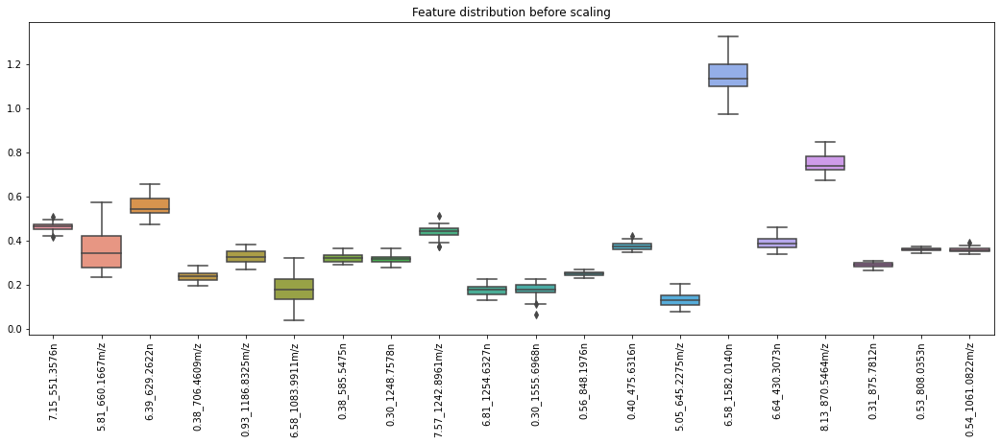

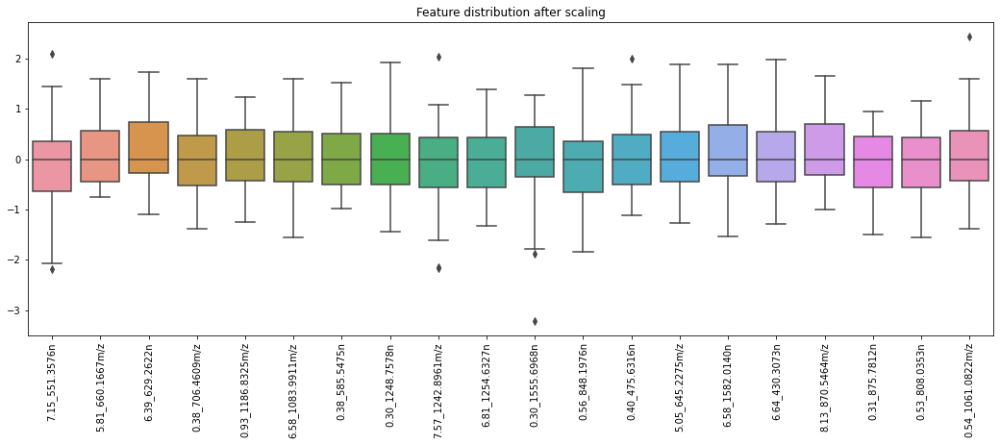

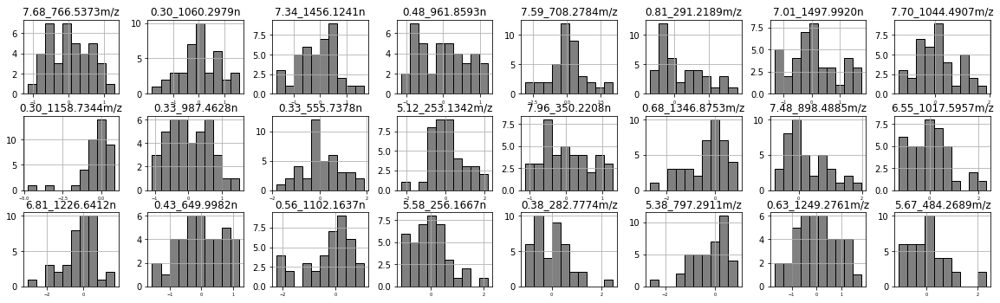

In [ ]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='AUClast')

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 99.5415029633657, tolerance: 21.620134108990005

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 53.79144262104296, tolerance: 21.15205694634359

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 65.58642491403452, tolerance: 20.610704410230774

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 103.60270205790721, tolerance: 21.442901

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: -0.03

MAPE: 2.41
MAPE Cv: 37.02

RMSE: 4.65
RMSE Cv: 74.71


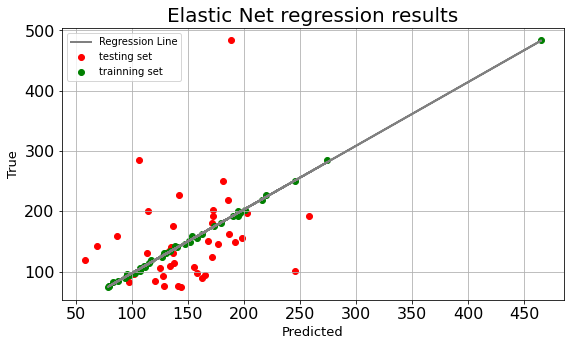

In [73]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [74]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 164.05017072060798, tolerance: 21.620134108990005

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 76.76167979892489, tolerance: 21.15205694634359

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 50.12075224089995, tolerance: 20.610704410230774

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 114.78416645445577, tolerance: 21.4429

Elastic Net - Summary of results:

R2: 1.0
R2 Cv: 0.25

MAPE: 2.41
MAPE Cv: 33.76

RMSE: 4.65
RMSE Cv: 63.87


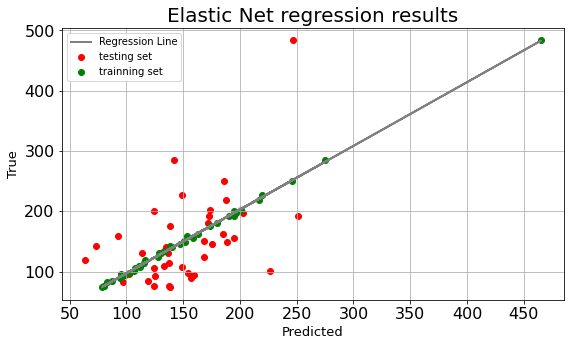

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [75]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

A saída de streaming foi truncada nas últimas 5000 linhas.
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 57.886083225072525, tolerance: 21.589315323676928

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 89.66357760214521, tolerance: 21.617232880876927

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 71.72776379138168, tolerance: 21.620134108990005

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of ite

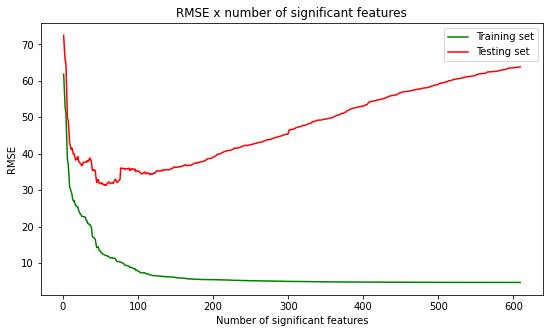

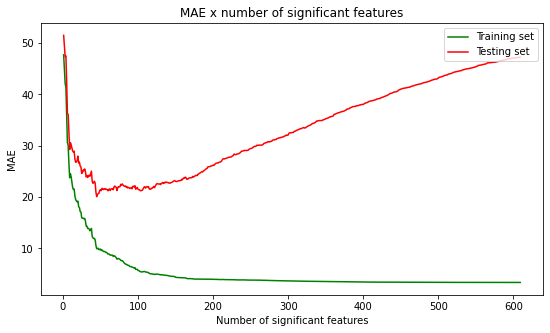

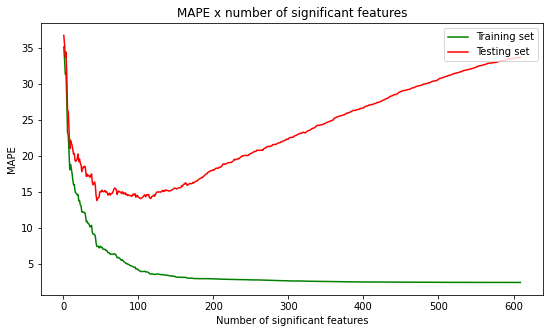

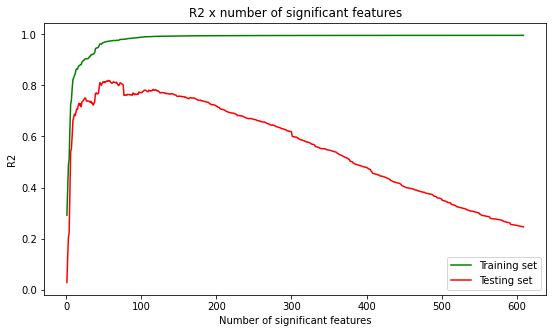

A saída de streaming foi truncada nas últimas 5000 linhas.
/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 738.5333755302694, tolerance: 111.71614407620002

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 1267.7850291171414, tolerance: 112.33678811980002

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.9593260918191, tolerance: 110.80804179020001

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

Objective did not converge. You might want to increase the number of ite

In [76]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.98
R2 Cv: 0.85

MAPE: 6.38
MAPE Cv: 14.39

RMSE: 10.77
RMSE Cv: 28.21


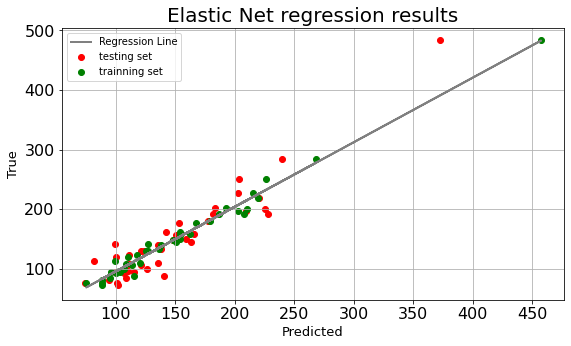

ElasticNet(alpha=0.5, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=1000, normalize=False, positive=False, precompute=True,
           random_state=None, selection='random', tol=0.0001, warm_start=True)

In [77]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

### Cmax

In [78]:
# Data preparation:

scaled_x_train, y_train, lista_nome_variaveis_x, lista_nome_variaveis_y, lista_nome_amostras = data_prep_met(df, pk_param='Cmax')


Data types:

Cmax                 float64
8.42_1562.1277m/z    float64
6.48_1605.9970m/z    float64
5.40_532.0377m/z     float64
0.36_1158.2420m/z    float64
                      ...   
Leucocitos_campo     float64
Hemacias_campo       float64
pH                   float64
SEXO_F               float64
SEXO_M               float64
Length: 2492, dtype: object

Missing values:

Cmax                 0
8.42_1562.1277m/z    0
6.48_1605.9970m/z    0
5.40_532.0377m/z     0
0.36_1158.2420m/z    0
                    ..
Leucocitos_campo     0
Hemacias_campo       0
pH                   0
SEXO_F               0
SEXO_M               0
Length: 2492, dtype: int64

Number of zeros:

Cmax                  0
8.42_1562.1277m/z     0
6.48_1605.9970m/z     0
5.40_532.0377m/z      0
0.36_1158.2420m/z     0
                     ..
Leucocitos_campo     15
Hemacias_campo       31
pH                   22
SEXO_F               18
SEXO_M               22
Length: 2492, dtype: int64



Correlations, boxplots and hi

,Cmax,8.42_1562.1277m/z,6.48_1605.9970m/z,5.40_532.0377m/z,0.36_1158.2420m/z,0.28_702.7730m/z,7.27_411.3828m/z,0.30_1109.3108n,0.30_1162.2781n,7.87_1696.0852m/z,10.80_279.6138m/z,5.32_52.8654m/z,0.36_1174.2883m/z,0.30_1034.2937n,0.28_1142.6516m/z,10.39_1636.1421m/z,10.46_1557.1500m/z,0.30_1136.2752n,4.93_1433.5379m/z,3.85_1410.2592n,7.75_1516.1052m/z,0.28_424.8487m/z,6.62_1377.8661m/z,0.28_308.9068m/z,0.30_1425.7036m/z,6.73_1666.9602m/z,0.30_1068.2870n,10.39_1654.1111m/z,5.33_52.8715m/z,6.58_1640.9614m/z,2.67_186.1128m/z,0.87_1598.9514m/z,0.30_1441.7021m/z,0.31_309.9232n,0.30_1530.7095n,0.30_768.3589n,7.50_529.4240m/z,7.45_1555.1353m/z,0.71_1657.9323m/z,3.55_195.8102m/z,...,PESO,IMC,IDADE,Colesterol_Total,Triglicerides,Ureia,Creatinina,Glicose_em_Jejum,acido_urico,TGO_AST,TGP_ALT,Bilirrubina_Total,Bilirrubina_Direta,Bilirrubina_Indireta,Fosfatase_Alcalina,ProteIna_Total,Albumina,Hemoglobina,Hemacias,Hematocrito,VCM,HCM,CHCM,RDW,Leucocitos,Segmentados,Eosinofilos,Linfocitos,Monocitos,Plaquetas,Anti_HBc,Anti_HCV,Anti_HIV,HBsAg,Densidade,Leucocitos_campo,Hemacias_campo,pH,SEXO_F,SEXO_M
Cmax,1.000000,0.145869,-0.110056,-0.040619,0.524843,-0.045042,-0.055165,0.308309,0.055311,0.290805,-0.072331,-0.138170,0.268911,-0.035269,0.038228,-0.060157,0.047389,0.030268,-0.250499,-0.205642,-0.321714,-0.047211,-0.050605,-0.017425,-0.028114,-0.214401,-0.005564,-0.046860,-0.020417,0.174502,0.101942,-0.041944,-0.001379,0.149948,-0.104024,0.044427,-0.005144,0.118659,-0.078293,-0.234202,...,-0.233403,-0.138227,-0.371180,-0.270592,-0.049487,-0.355163,-0.488367,-0.134714,-0.269648,0.002938,0.038409,0.016369,0.025053,0.012916,-0.073888,0.125963,-0.018029,-0.226697,-0.215716,-0.235489,-0.052014,-0.065770,-0.094165,0.045080,-0.025297,0.017422,0.075713,-0.075962,-0.177665,-0.080365,0.112230,-0.062080,-0.202899,0.028636,0.142309,0.478468,0.127013,-0.102602,0.345889,-0.345889
8.42_1562.1277m/z,0.145869,1.000000,-0.333496,0.148249,0.105490,-0.135709,-0.243937,0.226168,0.088690,0.800591,-0.631432,-0.383297,0.039674,-0.067877,-0.325326,0.516005,0.466989,-0.088553,-0.065238,-0.116999,0.027312,-0.018936,-0.130654,-0.056341,-0.205995,-0.456969,0.036363,0.662461,-0.201900,0.394490,0.219806,-0.060836,-0.050520,0.171859,0.058174,-0.359532,-0.051652,0.298018,-0.078330,-0.420564,...,-0.026497,-0.001441,-0.323543,-0.022161,-0.264558,0.137572,-0.116950,-0.050818,0.058657,0.033605,0.062410,-0.052125,-0.058794,-0.048739,-0.072956,0.238078,0.042122,0.101483,0.067513,0.079721,0.026745,0.063386,0.121697,-0.041834,-0.032332,0.044668,-0.030347,-0.119999,-0.215817,-0.055392,0.190244,0.093630,0.047564,-0.029454,0.123457,0.218838,0.114586,-0.221341,0.179266,-0.179266
6.48_1605.9970m/z,-0.110056,-0.333496,1.000000,-0.278248,-0.081062,-0.141606,-0.094295,-0.152716,-0.457245,-0.317448,0.179027,0.372727,-0.223659,-0.084704,-0.030484,-0.325202,-0.357697,-0.263121,0.433661,0.136572,-0.221140,-0.262966,0.255130,-0.191920,-0.165338,0.108333,-0.340623,-0.479439,0.247958,-0.257670,-0.144706,0.059284,0.314539,0.070366,-0.015698,-0.137968,0.080902,-0.358041,-0.115002,0.173560,...,-0.147434,-0.251551,0.087841,-0.053933,0.015234,-0.020470,0.077746,0.017872,-0.188933,0.083145,0.009068,0.469167,0.418285,0.478897,0.116824,-0.300619,0.129776,0.074570,-0.037429,0.065649,0.202752,0.180718,0.085984,-0.100484,-0.041886,-0.056861,0.033030,-0.036581,0.121822,-0.222200,0.006737,-0.027108,-0.008133,-0.082474,-0.154774,-0.320797,-0.197354,0.187972,-0.173453,0.173453
5.40_532.0377m/z,-0.040619,0.148249,-0.278248,1.000000,0.109987,-0.072589,-0.025426,0.020652,0.157083,0.080157,-0.224875,-0.418642,-0.059040,-0.103665,-0.104069,0.092145,0.108497,0.037062,-0.131928,-0.086273,0.070671,0.048166,-0.320589,0.021502,0.073413,-0.356282,0.100638,0.120635,-0.304651,0.230615,0.062732,-0.052227,-0.293796,0.033706,-0.016528,-0.189651,0.042148,0.053842,0.236489,-0.081355,...,-0.104091,-0.104641,0.079616,-0.084308,0.097576,0.112439,0.025842,0.073872,0.105944,0.158597,0.039975,0.034200,0.071212,0.020147,-0.181785,-0.213364,

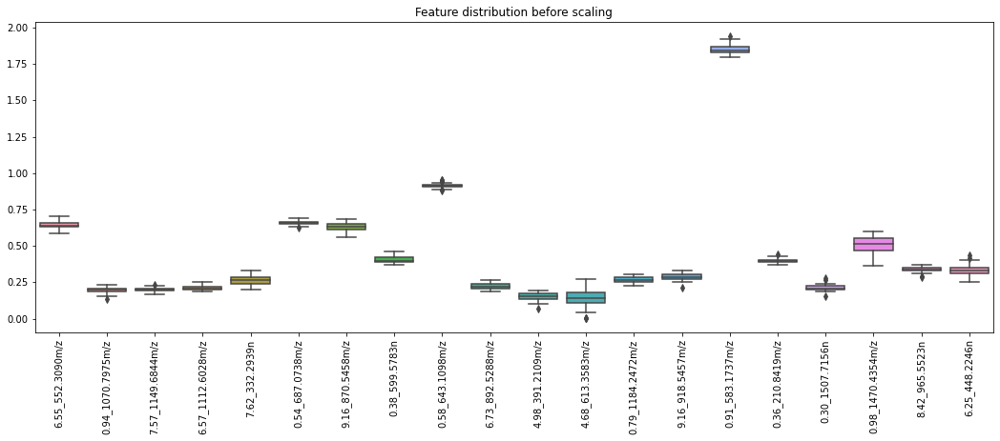

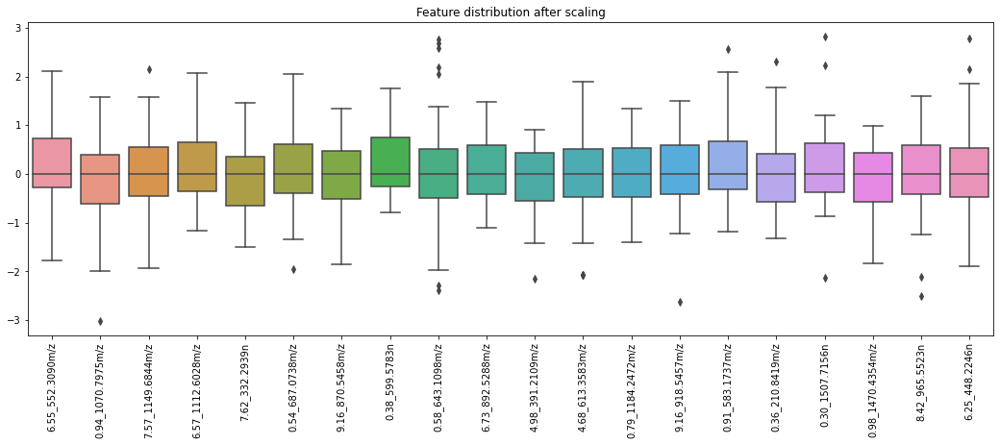

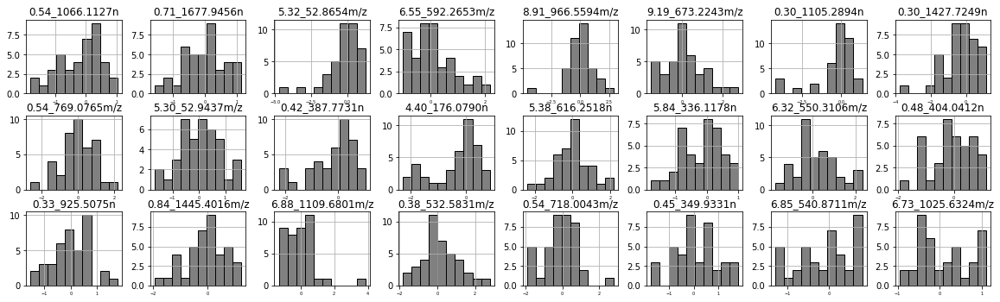

In [79]:
# Basic data inspection

basic_inspec(y_train, scaled_x_train, lista_nome_amostras, df, pk_param='Cmax')

Elastic Net - Summary of results:

R2: 0.93
R2 Cv: -0.11

MAPE: 11.34
MAPE Cv: 45.13

RMSE: 2.55
RMSE Cv: 10.54


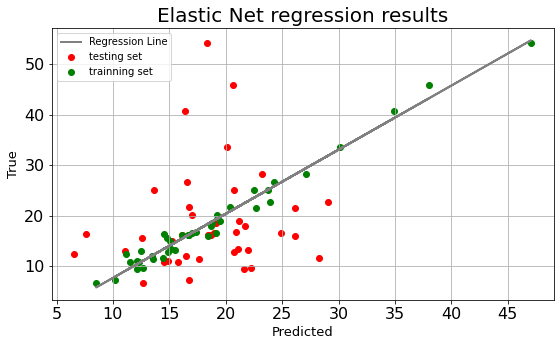

In [80]:
# Machine Learning

regr = elastic_net_model(scaled_x_train, y_train)

In [81]:
# Feature selection

scaled_x_train_selected = coef_sel(regr, lista_nome_variaveis_x)

Elastic Net - Summary of results:

R2: 0.93
R2 Cv: 0.16

MAPE: 11.34
MAPE Cv: 40.75

RMSE: 2.55
RMSE Cv: 9.16


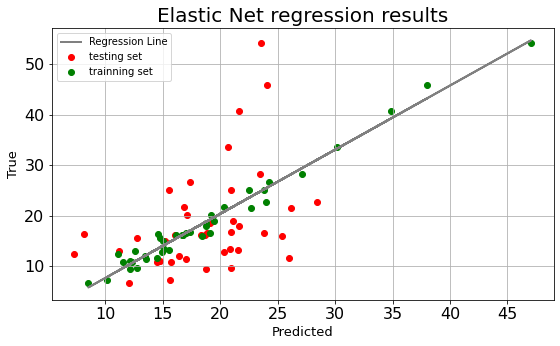

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=None, selection='cyclic', tol=0.0001, warm_start=False)

In [82]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train)

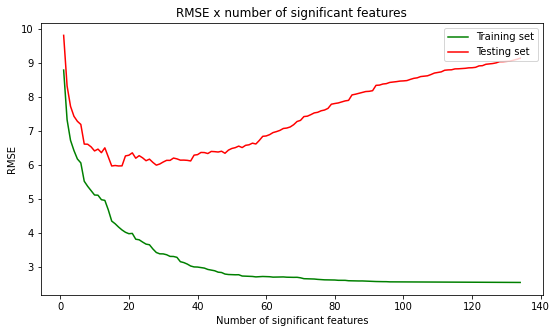

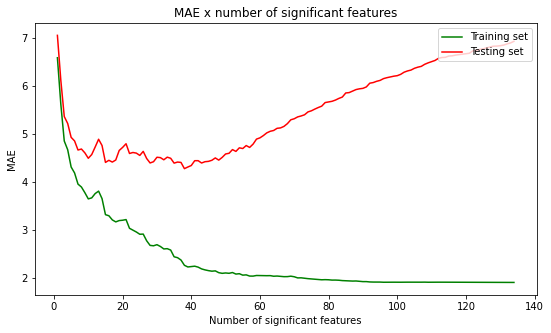

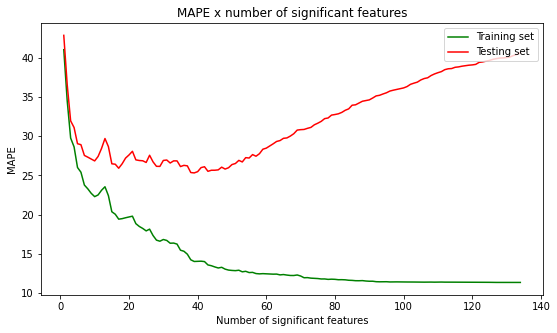

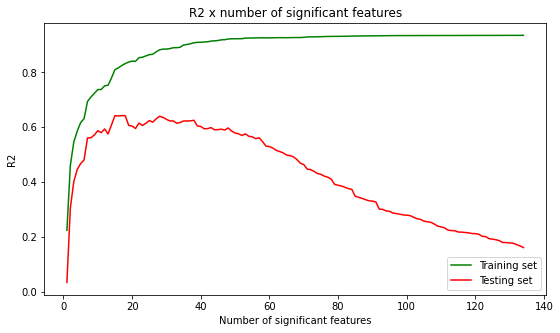

In [83]:
# Fine feature selection and hyperparameters tuning

regr, scaled_x_train_selected = fin_sel_hyp(scaled_x_train_selected)

Elastic Net - Summary of results:

R2: 0.9
R2 Cv: 0.79

MAPE: 15.66
MAPE Cv: 23.24

RMSE: 3.17
RMSE Cv: 4.55


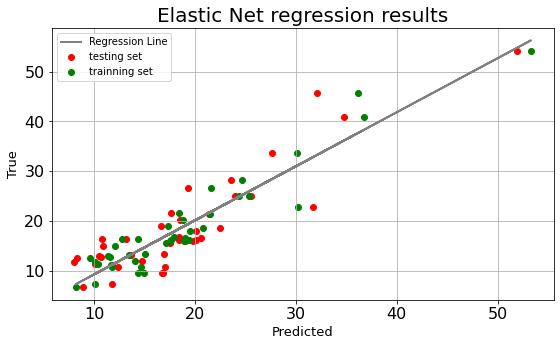

ElasticNet(alpha=0.2, copy_X=True, fit_intercept=True, l1_ratio=0.1,
           max_iter=10000, normalize=False, positive=False, precompute=True,
           random_state=None, selection='random', tol=0.0001, warm_start=True)

In [84]:
# Machine Learning (using selected features)

elastic_net_model(scaled_x_train_selected, y_train, regr=regr)

# Figures for scientific article

In [ ]:
# Figure 3



# Defining the figure (plt.figure)

fig = plt.figure(figsize=(9,6), dpi=1200) 

# Defining axes for subplots(plt.subplot2grid)

ax1 = plt.subplot2grid((10,1), (0, 0), colspan=1, rowspan=4)

ax2 = plt.subplot2grid((10,1), (6, 0), sharex=ax1, colspan=1, rowspan=4)


# Inserting data to their corresponding axes

fig.set_facecolor('white') # defining background color

ax1.scatter(y_train_cv_predicted_AUC_POS_met, y_train_AUC_POS_met, color='grey', label='testing set', s=20)

ax1.scatter(y_predicted_new_AUC_POS_met, y_train_AUC_POS_met, color='black', label='trainning set', s=20)

m, b = np.polyfit(y_predicted_new_AUC_POS_met, y_train_AUC_POS_met, 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_predicted_new_AUC_POS_met, m*y_train_AUC_POS_met + b, 
         color='black',linewidth=2, label='Regression Line') # add regression line of best fit

n, c = np.polyfit(y_train_cv_predicted_AUC_POS_met, y_train_AUC_POS_met, 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_train_cv_predicted_AUC_POS_met, n*y_train_cv_predicted_AUC_POS_met + c, 
         color='grey',linewidth=2, label='Regression Line') # add regression line of best fit         



font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':13} #add font to the labels

ax1.set_title('LOOCV - AUC ESI(+)', fontdict = font1) # add title to the plot

ax1.set_xlabel('Predicted (ng h/mL)', fontdict = font2) # add x axis label)

ax1.set_ylabel('True (ng h/mL)', fontdict = font2) # add y axis label)

ax1.set_facecolor('white') # defining background color for axes 1

ax1.text(round(((np.amax(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.98), 'R2: {0}'.format(round(r2_AUC_POS_met,2)), fontdict = font2) # add text to the plot
ax1.text(round(((np.amax(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.85), 'R2 Cv: {0}'.format(round(r2_testing_set_AUC_POS_met,2)), fontdict = font2) # add text to the plot
ax1.text(round(((np.amax(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.72), 'RMSE Cv: {0}'.format(round(rmse_cv_AUC_POS_met,2)), fontdict = font2) # add text to the plot
ax1.text(round(((np.amax(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_predicted_new_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met])))-(np.amin(np.hstack([y_train_AUC_POS_met,y_train_cv_predicted_AUC_POS_met]))))*0.59), 'MAPE Cv: {0}'.format(round(mape_cv_AUC_POS_met,2)), fontdict = font2) # add text to the plot



ax2.scatter(y_train_cv_predicted_AUC_NEG_met, y_train_AUC_NEG_met, color='grey', label='testing set', s=20)

ax2.scatter(y_predicted_new_AUC_NEG_met, y_train_AUC_NEG_met, color='black', label='trainning set', s=20)

m, b = np.polyfit(y_predicted_new_AUC_NEG_met, y_train_AUC_NEG_met, 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_predicted_new_AUC_NEG_met, m*y_predicted_new_AUC_NEG_met + b, 
         color='black',linewidth=2, label='Regression Line') # add regression line of best fit

n, c = np.polyfit(y_train_cv_predicted_AUC_NEG_met, y_train_AUC_NEG_met, 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_train_cv_predicted_AUC_NEG_met, n*y_train_cv_predicted_AUC_NEG_met + c, 
         color='grey',linewidth=2, label='Regression Line') # add regression line of best fit  


ax2.set_title('LOOCV - AUC ESI(-)', fontdict = font1) # add title to the plot

ax2.set_xlabel('Predicted (ng h/mL)', fontdict = font2) # add x axis label)

ax2.set_ylabel('True (ng h/mL)', fontdict = font2) # add y axis label)

ax2.set_facecolor('white') # defining background color for axes 2

ax2.legend(loc='lower right') # add legend box


ax2.text(round(((np.amax(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.98), 'R2: {0}'.format(round(r2_AUC_NEG_met,2)), fontdict = font2) # add text to the plot
ax2.text(round(((np.amax(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.85), 'R2 Cv: {0}'.format(round(r2_testing_set_AUC_NEG_met,2)), fontdict = font2) # add text to the plot
ax2.text(round(((np.amax(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.72), 'RMSE Cv: {0}'.format(round(rmse_cv_AUC_NEG_met,2)), fontdict = font2) # add text to the plot
ax2.text(round(((np.amax(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_predicted_new_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met])))-(np.amin(np.hstack([y_train_AUC_NEG_met,y_train_cv_predicted_AUC_NEG_met]))))*0.59), 'MAPE Cv: {0}'.format(round(mape_cv_AUC_NEG_met,2)), fontdict = font2) # add text to the plot


Text(62, 251, 'MAPE Cv: 14.28')

In [ ]:
# Figure 7



# Defining the figure (plt.figure)

fig = plt.figure(figsize=(9,6), dpi=1200) 

# Defining axes for subplots(plt.subplot2grid)

ax1 = plt.subplot2grid((10,1), (0, 0), colspan=1, rowspan=4)

ax2 = plt.subplot2grid((10,1), (6, 0), sharex=ax1, colspan=1, rowspan=4)


# Inserting data to their corresponding axes

fig.set_facecolor('white') # defining background color

ax1.scatter(y_train_cv_predicted_Cmax_POS_met, y_train_Cmax_POS_met, color='grey', label='testing set', s=20)

ax1.scatter(y_predicted_new_Cmax_POS_met, y_train_Cmax_POS_met, color='black', label='trainning set', s=20)

#m, b = np.polyfit(y_predicted_new_Cmax_POS_met, y_train_Cmax_POS_met, 1) # create regression line (m = slope, b=intercept)

#ax1.plot(y_predicted_new_Cmax_POS_met, m*y_train_Cmax_POS_met + b, 
#         color='green',linewidth=2, label='Regression Line') # add regression line of best fit

m, b = np.polyfit(y_predicted_new_Cmax_POS_met, y_train_Cmax_POS_met, 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_predicted_new_Cmax_POS_met, m*y_predicted_new_Cmax_POS_met + b, 
         color='black',linewidth=2, label='Regression Line') # add regression line of best fit

n, c = np.polyfit(y_train_cv_predicted_Cmax_POS_met, y_train_Cmax_POS_met, 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_train_cv_predicted_Cmax_POS_met, n*y_train_cv_predicted_Cmax_POS_met + c, 
         color='grey',linewidth=2, label='Regression Line') # add regression line of best fit         



font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':13} #add font to the labels

ax1.set_title('LOOCV - Cmax ESI(+)', fontdict = font1) # add title to the plot

ax1.set_xlabel('Predicted ($ng.ml\u207b^1$)', fontdict = font2) # add x axis label)

ax1.set_ylabel('True ($ng.ml\u207b^1$)', fontdict = font2) # add y axis label)

ax1.set_facecolor('white') # defining background color for axes 1

ax1.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.98), 'R2: {0}'.format(round(r2_Cmax_POS_met,2)), fontdict = font2) # add text to the plot
ax1.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.85), 'R2 Cv: {0}'.format(round(r2_testing_set_Cmax_POS_met,2)), fontdict = font2) # add text to the plot
ax1.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.72), 'RMSE Cv: {0}'.format(round(rmse_cv_Cmax_POS_met,2)), fontdict = font2) # add text to the plot
ax1.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met])))-(np.amin(np.hstack([y_train_Cmax_POS_met,y_train_cv_predicted_Cmax_POS_met]))))*0.59), 'MAPE Cv: {0}'.format(round(mape_cv_Cmax_POS_met,2)), fontdict = font2) # add text to the plot



ax2.scatter(y_train_cv_predicted_Cmax_NEG_met, y_train_Cmax_NEG_met, color='grey', label='testing set', s=20)

ax2.scatter(y_predicted_new_Cmax_NEG_met, y_train_Cmax_NEG_met, color='black', label='trainning set', s=20)

m, b = np.polyfit(y_predicted_new_Cmax_NEG_met, y_train_Cmax_NEG_met, 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_predicted_new_Cmax_NEG_met, m*y_predicted_new_Cmax_NEG_met + b, 
         color='black',linewidth=2, label='Regression Line') # add regression line of best fit

n, c = np.polyfit(y_train_cv_predicted_Cmax_NEG_met, y_train_Cmax_NEG_met, 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_train_cv_predicted_Cmax_NEG_met, n*y_train_cv_predicted_Cmax_NEG_met + c, 
         color='grey',linewidth=2, label='Regression Line') # add regression line of best fit  


ax2.set_title('LOOCV - Cmax ESI(-)', fontdict = font1) # add title to the plot

ax2.set_xlabel('Predicted ($ng.ml\u207b^1$)', fontdict = font2) # add x axis label)

ax2.set_ylabel('True ($ng.ml\u207b^1$)', fontdict = font2) # add y axis label)

ax2.set_facecolor('white') # defining background color for axes 2

ax2.legend(loc='lower right') # add legend box


ax2.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.98), 'R2: {0}'.format(round(r2_Cmax_NEG_met,2)), fontdict = font2) # add text to the plot
ax2.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.85), 'R2 Cv: {0}'.format(round(r2_testing_set_Cmax_NEG_met,2)), fontdict = font2) # add text to the plot
ax2.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.72), 'RMSE Cv: {0}'.format(round(rmse_cv_Cmax_NEG_met,2)), fontdict = font2) # add text to the plot
ax2.text(round(((np.amax(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_predicted_new_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.1537), round(((np.amax(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met])))-(np.amin(np.hstack([y_train_Cmax_NEG_met,y_train_cv_predicted_Cmax_NEG_met]))))*0.59), 'MAPE Cv: {0}'.format(round(mape_cv_Cmax_NEG_met,2)), fontdict = font2) # add text to the plot


Text(7, 28, 'MAPE Cv: 23.24')

In [ ]:
# Figure 4 - AUC residuals

# Defining the figure (plt.figure)

fig = plt.figure(figsize=(12,6), dpi=1200, facecolor='white')

# Defining the axes

ax1 = plt.subplot2grid((1,2), (0,0))

ax2 = plt.subplot2grid((1,2), (0,1), sharey=ax1)




# Inserting data to their corresponding axes


# Axes 1 - residuals plot AUC POS

ax1.scatter(y_predicted_new_AUC_POS_met, (y_predicted_new_AUC_POS_met - y_train_AUC_POS_met), color='black', label='trainning set')

ax1.scatter(y_train_cv_predicted_AUC_POS_met, (y_train_cv_predicted_AUC_POS_met - y_train_AUC_POS_met) , color='grey', label='testing set')


m, b = np.polyfit(y_predicted_new_AUC_POS_met, (y_predicted_new_AUC_POS_met - y_train_AUC_POS_met), 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_predicted_new_AUC_POS_met, m*y_predicted_new_AUC_POS_met + b, 
         color='black',linewidth=2, label='Regression Line: trainning set') # add regression line of best fit


n, c = np.polyfit(y_train_cv_predicted_AUC_POS_met, (y_train_cv_predicted_AUC_POS_met - y_train_AUC_POS_met), 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_train_cv_predicted_AUC_POS_met, n*y_train_cv_predicted_AUC_POS_met + c, 
         color='grey',linewidth=2, label='Regression Line: testing set') # add regression line of best fit

ax1.legend(loc='lower left') # add legend box

font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':15} #add font to the labels


ax1.set_title('AUC ESI(+)', fontdict = font1) # add title to the plot

ax1.set_xlabel('Predicted (ng h/mL)', fontdict = font2) # add x axis label)

ax1.set_ylabel('Residuals', fontdict = font2) # add y axis label)

ax1.set_facecolor('white') # defining background color for axes 1



# Axes 2 - residuals plot AUC NEG


ax2.scatter(y_predicted_new_AUC_NEG_met, (y_predicted_new_AUC_NEG_met - y_train_AUC_NEG_met), color='black', label='trainning set')

ax2.scatter(y_train_cv_predicted_AUC_NEG_met, (y_train_cv_predicted_AUC_NEG_met - y_train_AUC_NEG_met) , color='grey', label='testing set')


m, b = np.polyfit(y_predicted_new_AUC_NEG_met, (y_predicted_new_AUC_NEG_met - y_train_AUC_NEG_met), 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_predicted_new_AUC_NEG_met, m*y_predicted_new_AUC_NEG_met + b, 
         color='black',linewidth=2, label='Regression Line: trainning set') # add regression line of best fit


n, c = np.polyfit(y_train_cv_predicted_AUC_NEG_met, (y_train_cv_predicted_AUC_NEG_met - y_train_AUC_NEG_met), 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_train_cv_predicted_AUC_NEG_met, n*y_train_cv_predicted_AUC_NEG_met + c, 
         color='grey',linewidth=2, label='Regression Line: testing set') # add regression line of best fit

#ax2.legend(loc='upper right') # add legend box

font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':15} #add font to the labels


ax2.set_title('AUC ESI(-)', fontdict = font1) # add title to the plot

ax2.set_xlabel('Predicted (ng h/mL)', fontdict = font2) # add x axis label)

#ax2.set_ylabel('Residuals', fontdict = font2) # add y axis label)

ax2.set_facecolor('white') # defining background color for axes 2





In [ ]:
# Figure 8 - Cmax residuals

# Defining the figure (plt.figure)

fig = plt.figure(figsize=(12,6), dpi=1200, facecolor='white')

# Defining the axes

ax1 = plt.subplot2grid((1,2), (0,0))

ax2 = plt.subplot2grid((1,2), (0,1), sharey=ax1)


# Inserting data to their corresponding axes


# Axes 1 - residuals plot Cmax POS


ax1.scatter(y_predicted_new_Cmax_POS_met, (y_predicted_new_Cmax_POS_met - y_train_Cmax_POS_met), color='black', label='trainning set')

ax1.scatter(y_train_cv_predicted_Cmax_POS_met, (y_train_cv_predicted_Cmax_POS_met - y_train_Cmax_POS_met) , color='grey', label='testing set')


m, b = np.polyfit(y_predicted_new_Cmax_POS_met, (y_predicted_new_Cmax_POS_met - y_train_Cmax_POS_met), 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_predicted_new_Cmax_POS_met, m*y_predicted_new_Cmax_POS_met + b, 
         color='black',linewidth=2, label='Regression Line: trainning set') # add regression line of best fit

n, c = np.polyfit(y_train_cv_predicted_Cmax_POS_met, (y_train_cv_predicted_Cmax_POS_met - y_train_Cmax_POS_met), 1) # create regression line (m = slope, b=intercept)

ax1.plot(y_train_cv_predicted_Cmax_POS_met, n*y_train_cv_predicted_Cmax_POS_met + c, 
         color='grey',linewidth=2, label='Regression Line: testing set') # add regression line of best fit

ax1.legend(loc='upper left') # add legend box

font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':15} #add font to the labels


ax1.set_title('Cmax ESI(+)', fontdict = font1) # add title to the plot

ax1.set_xlabel('Predicted ($ng.ml\u207b^1$)', fontdict = font2) # add x axis label)

ax1.set_ylabel('Residuals', fontdict = font2) # add y axis label)

ax1.set_facecolor('white') # defining background color to axes 1


# Axes 2 - residuals plot Cmax NEG


ax2.scatter(y_predicted_new_Cmax_NEG_met, (y_predicted_new_Cmax_NEG_met - y_train_Cmax_NEG_met), color='black', label='trainning set')

ax2.scatter(y_train_cv_predicted_Cmax_NEG_met, (y_train_cv_predicted_Cmax_NEG_met - y_train_Cmax_NEG_met) , color='grey', label='testing set')


m, b = np.polyfit(y_predicted_new_Cmax_NEG_met, (y_predicted_new_Cmax_NEG_met - y_train_Cmax_NEG_met), 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_predicted_new_Cmax_NEG_met, m*y_predicted_new_Cmax_NEG_met + b, 
         color='black',linewidth=2, label='Regression Line: trainning set') # add regression line of best fit

n, c = np.polyfit(y_train_cv_predicted_Cmax_NEG_met, (y_train_cv_predicted_Cmax_NEG_met - y_train_Cmax_NEG_met), 1) # create regression line (m = slope, b=intercept)

ax2.plot(y_train_cv_predicted_Cmax_NEG_met, n*y_train_cv_predicted_Cmax_NEG_met + c, 
         color='grey',linewidth=2, label='Regression Line: testing set') # add regression line of best fit

#ax2.legend(loc='lower left') # add legend box

font1 = {'color':'black','size':20} #add font to the labels 
font2 = {'color':'black','size':15} #add font to the labels


ax2.set_title('Cmax ESI(-)', fontdict = font1) # add title to the plot

ax2.set_xlabel('Predicted ($ng.ml\u207b^1$)', fontdict = font2) # add x axis label)

ax2.set_facecolor('white') # defining background color to axes 2


In [ ]:
# Figure 5 - residuals distribution AUC 

# Defining the figure (plt.figure)

fig = plt.figure(figsize=(9,6), dpi=1200, facecolor='white')


# Defining the axes

ax1 = plt.subplot2grid((2,2), (0,0))

ax2 = plt.subplot2grid((2,2), (1,0), sharex=ax1)

ax3 = plt.subplot2grid((2,2), (0,1))

ax4 = plt.subplot2grid((2,2), (1,1), sharex=ax3)


# Inserting data to their corresponding axes


# Axes 1 - residuals histogram ESI (+)

ax1.hist((y_train_cv_predicted_AUC_POS_met-y_train_AUC_POS_met))

ax1.set_title('Histogram AUC ESI(+)', fontdict = font2) # add title to the plot;

ax1.set_ylabel('Frequency') # add y axis label)

#ax1.set_xlabel('LOOCV Residuals') # add x axis label)

ax1.set_facecolor('white') # defining background color to axes 1

ax1.tick_params(labelbottom=False)  # hiding right plot x-axis ticks 


# Axes 2 - residuals histogram ESI (-)

ax2.hist((y_train_cv_predicted_AUC_NEG_met-y_train_AUC_NEG_met))

ax2.set_title('Histogram AUC ESI(-)', fontdict = font2) # add title to the plot;

ax2.set_ylabel('Frequency') # add y axis label)

ax2.set_xlabel('LOOCV Residuals') # add x axis label)

ax2.set_facecolor('white') # defining background color to axes 2



# Axes 3 - Quantiles X Residuals ESI (+)

stats.probplot((y_train_cv_predicted_AUC_POS_met-y_train_AUC_POS_met), dist="norm", plot=ax3, rvalue=False)


ax3.set_title('Probability Plot AUC ESI(+)', fontdict = font2) # add title to the plot;

ax3.set_ylabel('LOOCV Residuals') # add y axis label)

ax3.set_xlabel('') # add x axis label)

ax3.set_facecolor('white') # defining background color to axes 3

ax3.tick_params(labelbottom=False)  # hiding right plot x-axis ticks 


# Axes 4 - Quantles X Residuals ESI (-)

stats.probplot((y_train_cv_predicted_AUC_NEG_met-y_train_AUC_NEG_met), dist="norm", plot=ax4, rvalue=False)


ax4.set_title('Probability Plot AUC ESI(-)', fontdict = font2) # add title to the plot;

ax4.set_ylabel('LOOCV Residuals') # add y axis label)

ax4.set_facecolor('white') # defining background color axes 4



plt.tight_layout() # tight_layout() will adjust spacing between subplots to minimize the overlaps.


In [ ]:
# Figure 9 - residuals distribution Cmax 

# Defining the figure (plt.figure)

fig = plt.figure(figsize=(9,6), dpi=1200, facecolor='white')
#fig = plt.figure(figsize=(9,6), facecolor='white')

# Defining the axes

ax1 = plt.subplot2grid((2,2), (0,0))

ax2 = plt.subplot2grid((2,2), (1,0), sharex=ax1)

ax3 = plt.subplot2grid((2,2), (0,1))

ax4 = plt.subplot2grid((2,2), (1,1), sharex=ax3)


# Inserting data to their corresponding axes


# Axes 1 - residuals histogram ESI (+)

ax1.hist((y_train_cv_predicted_Cmax_POS_met-y_train_Cmax_POS_met))

ax1.set_title('Histogram Cmax ESI(+)', fontdict = font2) # add title to the plot;

ax1.set_ylabel('Frequency') # add y axis label)

#ax1.set_xlabel('LOOCV Residuals') # add x axis label)

ax1.set_facecolor('white') # defining background color to axes 1

ax1.tick_params(labelbottom=False)  # hiding right plot x-axis ticks


# Axes 2 - residuals histogram ESI (-)

ax2.hist((y_train_cv_predicted_Cmax_NEG_met-y_train_Cmax_NEG_met))

ax2.set_title('Histogram Cmax ESI(-)', fontdict = font2) # add title to the plot;

ax2.set_ylabel('Frequency') # add y axis label)

ax2.set_xlabel('LOOCV Residuals') # add x axis label)

ax2.set_facecolor('white') # defining background color to axes 2



# Axes 3 - Quantiles X Residuals ESI (+)

stats.probplot((y_train_cv_predicted_Cmax_POS_met-y_train_Cmax_POS_met), dist="norm", plot=ax3, rvalue=False)


ax3.set_title('Probability Plot Cmax ESI(+)', fontdict = font2) # add title to the plot;

ax3.set_ylabel('LOOCV Residuals') # add y axis label)

ax3.set_xlabel('') # add x axis label)

ax3.set_facecolor('white') # defining background color to axes 3

ax3.tick_params(labelbottom=False, axis='y')  # hiding right plot x-axis ticks/ axis=y to control y-axis numbers


# Axes 4 - Quantiles X Residuals ESI (-)

stats.probplot((y_train_cv_predicted_Cmax_NEG_met-y_train_Cmax_NEG_met), dist="norm", plot=ax4, rvalue=False)


ax4.set_title('Probability Plot Cmax ESI(-)', fontdict = font2) # add title to the plot;

ax4.set_ylabel('LOOCV Residuals') # add y axis label)

ax4.set_facecolor('white') # defining background color to axes 4



plt.tight_layout() # tight_layout() will adjust spacing between subplots to minimize the overlaps.


In [ ]:
# Figure 6

# Defining the figure

fig = plt.figure(figsize=(12,6), dpi=1200, facecolor='white')

# Defining the axes

ax0 = plt.subplot2grid((1,3), (0,0))

ax1 = plt.subplot2grid((1,3), (0,1), sharey=ax0)

ax2 = plt.subplot2grid((1,3), (0,2), sharey=ax0)


# Inserting data

# axes 0

sns.distplot(y_train_AUC_POS_met, kde=True, hist=False, axlabel='AUC (ng h/mL)', color='orangered', ax=ax0)
sns.distplot(y_predicted_new_AUC_POS_met, kde=True, hist=False, color='black', ax=ax0)
sns.distplot(y_train_cv_predicted_AUC_POS_met, kde=True, hist=False, color='grey', ax=ax0)

ax0.set_title('ESI(+)', fontdict = font2)
ax0.set_facecolor('white') # defining background color to axes 0

# axes 1

sns.distplot(y_train_AUC_NEG_met, kde=True, hist=False, axlabel='AUC (ng h/mL)', color='orangered', ax=ax1)
sns.distplot(y_predicted_new_AUC_NEG_met, kde=True, hist=False, color='black', ax=ax1)
sns.distplot(y_train_cv_predicted_AUC_NEG_met, kde=True, hist=False, color='grey', ax=ax1)

ax1.set_ylabel('') # hiding right plot y label 

ax1.tick_params(labelleft=False)  # hiding right plot y-axis ticks

ax1.set_title('ESI(-)', fontdict = font2)
ax1.set_facecolor('white') # defining background color to axes 1

# axes 2

sns.distplot(y_train_AUC_clin, kde=True, hist=False, axlabel='AUC (ng h/mL)', color='orangered', ax=ax2)
sns.distplot(y_predicted_new_AUC_clin, kde=True, hist=False, color='black', ax=ax2)
sns.distplot(y_train_cv_predicted_AUC_clin, kde=True, hist=False, color='grey', ax=ax2);

ax2.set_ylabel('') # hiding right plot y label 

ax2.tick_params(labelleft=False)  # hiding right plot y-axis ticks

ax2.set_title('Clinical features', fontdict = font2)
ax2.set_facecolor('white') # defining background color to axes 2

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axe

In [ ]:
# Figure 10

# Defining the figure

fig = plt.figure(figsize=(12,6), dpi=1200, facecolor='white')

# Defining the axes

ax0 = plt.subplot2grid((1,3), (0,0))

ax1 = plt.subplot2grid((1,3), (0,1), sharey=ax0)

ax2 = plt.subplot2grid((1,3), (0,2), sharey=ax0)


# Inserting data

# axes 0

sns.distplot(y_train_Cmax_POS_met, kde=True, hist=False, axlabel='Cmax ($ng.ml\u207b^1$)', color='orangered', ax=ax0)
sns.distplot(y_predicted_new_Cmax_POS_met, kde=True, hist=False, color='black', ax=ax0)
sns.distplot(y_train_cv_predicted_Cmax_POS_met, kde=True, hist=False, color='grey', ax=ax0)

ax0.set_title('ESI(+)', fontdict = font2)
ax0.set_facecolor('white') # defining background color to axes 0

# axes 1

sns.distplot(y_train_Cmax_NEG_met, kde=True, hist=False, axlabel='Cmax ($ng.ml\u207b^1$)', color='orangered', ax=ax1)
sns.distplot(y_predicted_new_Cmax_NEG_met, kde=True, hist=False, color='black', ax=ax1)
sns.distplot(y_train_cv_predicted_Cmax_NEG_met, kde=True, hist=False, color='grey', ax=ax1)

ax1.set_ylabel('') # hiding right plot y label 

ax1.tick_params(labelleft=False)  # hiding right plot y-axis ticks

ax1.set_title('ESI(-)', fontdict = font2)
ax1.set_facecolor('white') # defining background color to axes 1

# axes 2

sns.distplot(y_train_Cmax_clin, kde=True, hist=False, axlabel='Cmax ($ng.ml\u207b^1$)', color='orangered', ax=ax2)
sns.distplot(y_predicted_new_Cmax_clin, kde=True, hist=False, color='black', ax=ax2)
sns.distplot(y_train_cv_predicted_Cmax_clin, kde=True, hist=False, color='grey', ax=ax2);

ax2.set_ylabel('') # hiding right plot y label 

ax2.tick_params(labelleft=False)  # hiding right plot y-axis ticks

ax2.set_title('Clinical features', fontdict = font2)
ax2.set_facecolor('white') # defining background color to axes 2

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axe

In [ ]:
!python --version

Python 3.7.10


In [ ]:
import sklearn
print(sklearn.__version__)

0.22.2.post1
